## Packages

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import os

In [ ]:
from sklearn.utils import resample
from sklearn.model_selection import train_test_split

In [ ]:
import keras
from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences
from keras.utils.np_utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from keras.utils.np_utils import to_categorical
from keras.models import Model, Sequential
from keras.callbacks import EarlyStopping
from keras.layers import Input, Dense, Dropout
from keras.layers import Embedding, Bidirectional, LSTM

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [ ]:
!pip install umap-learn[plot]
!pip install lime

In [ ]:
import keras
from lime.lime_text import LimeTextExplainer
from collections import OrderedDict
import seaborn as sns

In [ ]:
from umap import UMAP
from sklearn.decomposition import PCA
import umap
import umap.plot
from bokeh.plotting import show, save, output_notebook, output_file

In [ ]:
from scipy.stats import ttest_ind
from scipy.stats import t
import scipy.stats as stats
from scipy.special import kl_div

## Preprocessing

### Data

In [ ]:
df1 = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/data_ncbi.xlsx')
df2 = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/data_Flu_DB.xlsx')

In [ ]:
combined_df = pd.concat([df1, df2])
combined_df.drop_duplicates(subset=['Accession', 'Sequence'], inplace=True)

In [ ]:
unique_df = combined_df[['Accession', 'Database', 'Segment', 'Host', 'Sequence']]
unique_df.to_excel('/content/drive/MyDrive/Misclassified/Data/unique_df.xlsx', index=False)

In [ ]:
count_df = unique_df.groupby(['Segment', 'Host']).size().reset_index(name='Count')
print(count_df)

In [ ]:
count_df = unique_df.groupby('Host').size().reset_index(name='Count')
print(count_df)

    Host   Count
0  Avian  264579
1  Human  467415
2  Swine  116636


### Undersampling

In [ ]:
avian_df = unique_df[unique_df['Host'] == 'Avian']
human_df = unique_df[unique_df['Host'] == 'Human']
swine_df = unique_df[unique_df['Host'] == 'Swine']

avian_df = resample(avian_df, n_samples=116636, random_state=0)
human_df = resample(human_df, n_samples=116636, random_state=0)

undersampled_df = pd.concat([avian_df, human_df, swine_df])
undersampled_df.to_excel('/content/drive/MyDrive/Misclassified/Data/undersampled_df.xlsx', index=False)

In [ ]:
count_df = undersampled_df.groupby(['Segment', 'Host']).size().reset_index(name='Count')
print(count_df)

   Segment   Host  Count
0       HA  Avian  20862
1       HA  Human  26616
2       HA  Swine  24038
3       MP  Avian  13796
4       MP  Human  14037
5       MP  Swine  15057
6       NP  Avian  13128
7       NP  Human  12026
8       NP  Swine  11615
9       NS  Avian  13302
10      NS  Human  12301
11      NS  Swine  11677
12      PA  Avian  13341
13      PA  Human  11835
14      PA  Swine  11395
15     PB1  Avian  13239
16     PB1  Human  11444
17     PB1  Swine  11137
18     PB2  Avian  13469
19     PB2  Human  11780
20     PB2  Swine  11325
21    _NA_  Avian  15499
22    _NA_  Human  16597
23    _NA_  Swine  20392


### Split

In [ ]:
train_df, val_test_df = train_test_split(undersampled_df, test_size=0.3, random_state=42)
val_df, test_df = train_test_split(val_test_df, test_size=0.5, random_state=42)

print(f'Train set shape: {train_df.shape}')
print(f'Validation set shape: {val_df.shape}')
print(f'Test set shape: {test_df.shape}')

Train set shape: (244935, 5)
Validation set shape: (52486, 5)
Test set shape: (52487, 5)


In [ ]:
count_df_train = train_df.groupby(['Segment', 'Host']).size().reset_index(name='Count')

In [ ]:
count_df_val = val_df.groupby(['Segment', 'Host']).size().reset_index(name='Count')

In [ ]:
count_df_val = val_df.groupby(['Segment', 'Host']).size().reset_index(name='Count')

In [ ]:
count_df_test = test_df.groupby(['Segment', 'Host']).size().reset_index(name='Count')

In [ ]:
train_df.to_excel('/content/drive/MyDrive/Misclassified/Data/train_df.xlsx', index=False)
val_df.to_excel('/content/drive/MyDrive/Misclassified/Data/val_df.xlsx', index=False)
test_df.to_excel('/content/drive/MyDrive/Misclassified/Data/test_df.xlsx', index=False)

### Remove Zoonose

In [ ]:
train_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/train_df.xlsx')
val_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/val_df.xlsx')
test_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/test_df.xlsx')

In [ ]:
len(train_df), len(val_df), len(test_df)

(244935, 52486, 52487)

In [ ]:
# Open the file and read the accessions into a list
accessions = []
with open('/content/drive/MyDrive/Nissrine/Misclassified/accessions_zonoose.txt', 'r') as f:
    for line in f:
        accessions.append(line.strip())

# Print the list of accessions
print(accessions)

['GQ117067', 'GQ117063', 'GQ117064', 'GQ117066', 'GQ117065', 'GQ117076', 'GQ117075', 'GQ117079', 'GQ117074', 'GQ117077', 'GQ117078', 'FJ969516', 'FJ969515', 'GQ117044', 'FJ969512', 'FJ969517', 'FJ969513', 'FJ969514', 'FJ966079', 'FJ966080', 'FJ966081', 'FJ966082', 'FJ966083', 'FJ966084', 'FJ966085', 'FJ966086', 'FJ966955', 'FJ966958', 'FJ966957', 'FJ966952', 'FJ966953', 'FJ966956', 'FJ966954', 'FJ966963', 'FJ966965', 'FJ966964', 'FJ966960', 'FJ966961', 'FJ971075', 'FJ966962', 'FJ971074', 'FJ969530', 'FJ969531', 'FJ969529', 'FJ981613', 'FJ969527', 'FJ969528', 'FJ984387', 'FJ969539', 'FJ969540', 'FJ969536', 'FJ984386', 'FJ969537', 'FJ969538', 'FJ966976', 'FJ966978', 'FJ966977', 'FJ966974', 'FJ966975', 'FJ969518', 'FJ969519', 'FJ984365', 'FJ984367', 'FJ984368', 'FJ971076', 'FJ984366', 'FJ969532', 'FJ969533', 'FJ966971', 'FJ966973', 'FJ966972', 'FJ969511', 'FJ969510', 'GQ160579', 'GQ160606', 'GQ160607', 'GQ117035', 'GQ117034', 'GQ117037', 'GQ117040', 'GQ117033', 'GQ117036', 'GQ117039', 'GQ

In [ ]:
len(accessions)

570

In [ ]:
train_df = train_df[~train_df['Accession'].isin(accessions)]
val_df = val_df[~val_df['Accession'].isin(accessions)]
test_df = test_df[~test_df['Accession'].isin(accessions)]

In [ ]:
len(train_df), len(val_df), len(test_df)

(244801, 52456, 52450)

In [ ]:
train_df.to_excel('/content/drive/MyDrive/Nissrine/Misclassified/train_df.xlsx', index=False)
val_df.to_excel('/content/drive/MyDrive/Nissrine/Misclassified/val_df.xlsx', index=False)
test_df.to_excel('/content/drive/MyDrive/Nissrine/Misclassified/test_df.xlsx', index=False)

### Discarded Sequences

In [ ]:
zoonose_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/zoonotic_seq_df.xlsx')

In [ ]:
# create a list of all the dataframes except the unique one
dfs_to_compare = [train_df, val_df, test_df, zoonose_df]

# loop through each dataframe and filter out rows that are in the unique dataframe
for df in dfs_to_compare:
    df.drop_duplicates(subset=["Accession"], keep=False, inplace=True)
    unique_df = unique_df[~unique_df.Accession.isin(df.Accession)]

# save the filtered rows to an excel file
unique_df.to_excel("/content/drive/MyDrive/Misclassified/Data/discarded_seq_df.xlsx", index=False)
len(unique_df)

### Open Reading Frame

In [ ]:
train_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/train_df.xlsx')
val_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/val_df.xlsx')
test_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/test_df.xlsx')

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_train, y_train, idxStart_train = codonStart(train_df.Sequence, train_df.Host)
X_val, y_val, idxStart_val = codonStart(val_df.Sequence, val_df.Host)
X_test, y_test, idxStart_test = codonStart(test_df.Sequence, test_df.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_train = toSeq(X_train, idxStart_train)
seq_val = toSeq(X_val, idxStart_val)
seq_test = toSeq(X_test, idxStart_test)

In [ ]:
# Calculate the length of each sequence and find the maximum length
seq_lengths = [len(seq) for seq in seq_train]
max_length = max(seq_lengths)
max_length

2310

In [ ]:
# Find the ID(s) of the sequence(s) with the maximum length
max_seq_ids = [i for i, seq in enumerate(seq_train) if len(seq) == max_length]
max_seq_ids

[209240]

In [ ]:
query_sequence = seq_train[209353]

matching_idx = -1
for idx, seq in train_df['Sequence'].iteritems():
    if query_sequence == seq:
        matching_idx = idx
        break

if matching_idx != -1:
    print(f"The ID of the matching sequence in train_df is {matching_idx}.")
else:
    print("No matching sequence found in train_df.")


No matching sequence found in train_df.


In [ ]:
(train_df.Segment[209355])

'PB2'

### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length_train, max_length_train, median_length_train = length(seq_train)
min_length_val, max_length_val, median_length_val = length(seq_val)
min_length_test, max_length_test, median_length_test = length(seq_test)

min_length=min(min_length_train, min_length_val, min_length_test)
max_length=max(max_length_train, max_length_val, max_length_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  3
Taille Maximale des séquences :  2310


## Encoding

### Labels

In [ ]:
le = LabelEncoder()

train_labels = le.fit_transform(y_train)
val_labels = le.transform(y_val)
test_labels = le.transform(y_test)

train_labels = to_categorical(train_labels)
val_labels = to_categorical(val_labels)
test_labels = to_categorical(test_labels)

In [ ]:
print("Training   : ", train_labels.shape)
print("Validation : ", val_labels.shape)
print("Test       : ", test_labels.shape)

Training   :  (244933, 3)
Validation :  (52485, 3)
Test       :  (52485, 3)


### Proteins

In [ ]:
# Define the genetic code
genetic_code = {
    "ATA":"I", "ATC":"I", "ATT":"I", "ATG":"M",
    "ACA":"T", "ACC":"T", "ACG":"T", "ACT":"T",
    "AAC":"N", "AAT":"N", "AAA":"K", "AAG":"K",
    "AGC":"S", "AGT":"S", "AGA":"R", "AGG":"R",
    "CTA":"L", "CTC":"L", "CTG":"L", "CTT":"L",
    "CCA":"P", "CCC":"P", "CCG":"P", "CCT":"P",
    "CAC":"H", "CAT":"H", "CAA":"Q", "CAG":"Q",
    "CGA":"R", "CGC":"R", "CGG":"R", "CGT":"R",
    "GTA":"V", "GTC":"V", "GTG":"V", "GTT":"V",
    "GCA":"A", "GCC":"A", "GCG":"A", "GCT":"A",
    "GAC":"D", "GAT":"D", "GAA":"E", "GAG":"E",
    "GGA":"G", "GGC":"G", "GGG":"G", "GGT":"G",
    "TCA":"S", "TCC":"S", "TCG":"S", "TCT":"S",
    "TTC":"F", "TTT":"F", "TTA":"L", "TTG":"L",
    "TAC":"Y", "TAT":"Y", "TAA":"*", "TAG":"*",
    "TGC":"C", "TGT":"C", "TGA":"*", "TGG":"W",
}

In [ ]:
def toProtein(X):
  seq_pro=[]
  # Translate each DNA sequence to its corresponding amino acid sequence
  for rna_sequence in X:
      # Split the sequence into codons
      codons = [rna_sequence[i:i+3] for i in range(0, len(rna_sequence), 3)]
        
      # Translate each codon to its corresponding amino acid
      amino_acids = [genetic_code[codon] for codon in codons]
        
      # Join the amino acids into a single string
      protein_sequence = ''.join(amino_acids)
      seq_pro.append(protein_sequence)
      
  return seq_pro

In [ ]:
seq_pro_train = toProtein(seq_train)
seq_pro_val = toProtein(seq_val)
seq_pro_test = toProtein(seq_test)

In [ ]:
# Define the amino acid alphabet
aa_alphabet = {'A': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5, 'G': 6, 'H': 7, 'I': 8, 'K': 9, 'L': 10, 'M': 11, 'N': 12, 'P': 13, 'Q': 14, 'R': 15, 'S': 16, 'T': 17, 'V': 18, 'W': 19, 'Y': 20}

# Encode a protein sequence as a list of indices
def encode_sequence_pro(seq_list):
    encoded_seqs = []
    for seq in seq_list:
        encoded_seq = [aa_alphabet[aa] for aa in seq]
        encoded_seqs.append(encoded_seq)
    return encoded_seqs

In [ ]:
train_sequences_pro = encode_sequence_pro(seq_pro_train)
val_sequences_pro = encode_sequence_pro(seq_pro_val)
test_sequences_pro = encode_sequence_pro(seq_pro_test)

In [ ]:
# Sequences Length
min_length_pro, max_length_pro, median_length_pro = length(train_sequences_pro)
print("Taille Maximale des séquences : ", max_length_pro)

Taille Maximale des séquences :  770


In [ ]:
train_padded_pro = pad_sequences(train_sequences_pro, maxlen=(max_length_pro), padding="post", truncating="post")
val_padded_pro = pad_sequences(val_sequences_pro, maxlen=(max_length_pro), padding="post", truncating="post")
test_padded_pro = pad_sequences(test_sequences_pro, maxlen=(max_length_pro), padding="post", truncating="post")

In [ ]:
print("Training   : ", train_padded_pro.shape)
print("Validation : ", val_padded_pro.shape)
print("Test       : ", test_padded_pro.shape)

Training   :  (244933, 770)
Validation :  (52485, 770)
Test       :  (52485, 770)


### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
train_sequences_rna = encode_sequences_rna(seq_train, codon_index)
val_sequences_rna = encode_sequences_rna(seq_val, codon_index)
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)

In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(train_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  770


In [ ]:
train_padded_arn = pad_sequences(train_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")
val_padded_arn = pad_sequences(val_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Training   : ", train_padded_arn.shape)
print("Validation : ", val_padded_arn.shape)
print("Test       : ", test_padded_arn.shape)

Training   :  (244933, 770)
Validation :  (52485, 770)
Test       :  (52485, 770)


## Models

#### Functions

In [ ]:
es = EarlyStopping(monitor='val_loss', patience=3, verbose=1)

In [ ]:
class TransformerBlock(layers.Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock,self).__init__()
        self.att = layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = keras.Sequential(
            [layers.Dense(ff_dim, activation="relu"), layers.Dense(embed_dim),]
        )
        self.layernorm1 = layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = layers.LayerNormalization(epsilon=1e-6)
        self.dropout1 = layers.Dropout(rate)
        self.dropout2 = layers.Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

In [ ]:
class TokenAndPositionEmbedding(layers.Layer):
    def __init__(self, maxlen, vocab_size, embed_dim):
        super(TokenAndPositionEmbedding, self).__init__()
        self.token_emb = layers.Embedding(input_dim=vocab_size, output_dim=embed_dim)
        self.pos_emb = layers.Embedding(input_dim=maxlen, output_dim=embed_dim)

    def call(self, x):
        maxlen = tf.shape(x)[-1]
        positions = tf.range(start=0, limit=maxlen, delta=1)
        positions = self.pos_emb(positions)
        x = self.token_emb(x)
        return x + positions

### Proteins

#### Bi-LSTM

##### The Model

In [ ]:
x_input = Input(shape=(max_length_pro,), name="Input_Layer")

emb = Embedding(len(aa_alphabet), 100, input_length=max_length_pro, name="Embedding_Layer")(x_input)
bi_rnn = Bidirectional(LSTM(50), name="Bidirectional_LSTM_Layer")(emb)
x = Dropout(0.1, name="Dropout_Layer_1")(bi_rnn)
x = Dense(100, activation='relu', name="Dense_Layer_1")(x)
x = Dense(100, activation='relu', name="Dense_Layer_2")(x)

x_output = Dense(3, activation='softmax', name="Softmax_Layer_1")(x)
model_lstm_pro = Model(inputs=x_input, outputs=x_output)

In [ ]:
model_lstm_pro.compile("adam", "binary_crossentropy", metrics=["accuracy"])
model_lstm_pro.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_Layer (InputLayer)    [(None, 770)]             0         
                                                                 
 Embedding_Layer (Embedding)  (None, 770, 100)         2000      
                                                                 
 Bidirectional_LSTM_Layer (B  (None, 100)              60400     
 idirectional)                                                   
                                                                 
 Dropout_Layer_1 (Dropout)   (None, 100)               0         
                                                                 
 Dense_Layer_1 (Dense)       (None, 100)               10100     
                                                                 
 Dense_Layer_2 (Dense)       (None, 100)               10100     
                                                           

##### Training

In [ ]:
history_lstm_pro = model_lstm_pro.fit(
  train_padded_pro, train_labels,
  epochs=50, batch_size=32,
  validation_data=(val_padded_pro, val_labels),
  callbacks=[es]
  )

Epoch 1/50
7650/7650 [==============================] - 333s 43ms/step - loss: 0.3261 - accuracy: 0.7672 - val_loss: 0.2327 - val_accuracy: 0.8587
Epoch 2/50
7650/7650 [==============================] - 327s 43ms/step - loss: 0.2500 - accuracy: 0.8426 - val_loss: 0.2321 - val_accuracy: 0.8504
Epoch 3/50
7650/7650 [==============================] - 328s 43ms/step - loss: 0.2148 - accuracy: 0.8668 - val_loss: 0.2246 - val_accuracy: 0.8559
Epoch 4/50
7650/7650 [==============================] - 328s 43ms/step - loss: 0.1961 - accuracy: 0.8817 - val_loss: 0.1770 - val_accuracy: 0.8942
Epoch 5/50
7650/7650 [==============================] - 327s 43ms/step - loss: 0.1759 - accuracy: 0.8970 - val_loss: 0.1596 - val_accuracy: 0.9098
Epoch 6/50
7650/7650 [==============================] - 328s 43ms/step - loss: 0.1534 - accuracy: 0.9137 - val_loss: 0.1426 - val_accuracy: 0.9187
Epoch 7/50
7650/7650 [==============================] - 328s 43ms/step - loss: 0.1519 - accuracy: 0.9093 - val_loss: 0

##### Plot History

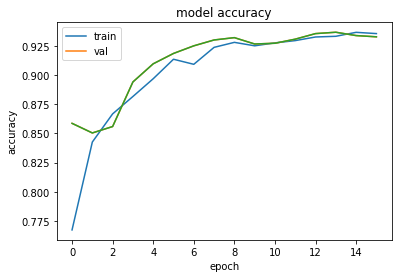

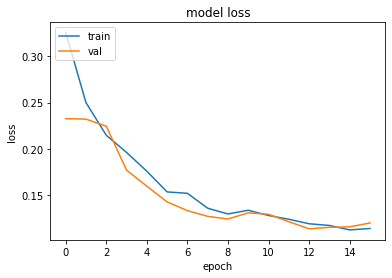

In [ ]:
# summarize history for accuracy
plt.plot(history_lstm_pro.history['accuracy'])
plt.plot(history_lstm_pro.history['val_accuracy'])
plt.plot(history_lstm_pro.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history_lstm_pro.history['loss'])
plt.plot(history_lstm_pro.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

##### Evaluation

In [ ]:
results_lstm_train_pro = model_lstm_pro.evaluate(train_padded_pro, train_labels, batch_size=32)
results_lstm_val_pro = model_lstm_pro.evaluate(val_padded_pro, val_labels, batch_size=32)
results_lstm_test_pro = model_lstm_pro.evaluate(test_padded_pro, test_labels, batch_size=32)

1639/1639 [==============================] - 29s 18ms/step - loss: 0.1196 - accuracy: 0.9333


##### Save Model

In [ ]:
model_lstm_pro.save('/content/drive/MyDrive/Nissrine/Misclassified/Proteines_Bi-LSTM')

#### Transformers

##### The Model

In [ ]:
embed_dim = 100  # Embedding size for each token
num_heads = 2  # Number of attention heads
ff_dim = 50  # Hidden layer size in feed forward network inside transformer

inputs = layers.Input(shape=(max_length_pro,), name="Input_Layer")
embedding_layer = TokenAndPositionEmbedding(max_length_pro, len(aa_alphabet), embed_dim)
x = embedding_layer(inputs)

transformer_block = TransformerBlock(embed_dim, num_heads, ff_dim)
x = transformer_block(x)

x = layers.GlobalAveragePooling1D(name="GlobalAveragePooling1D_Layer")(x)
x = layers.Dropout(0.1, name="Dropout_Layer_1")(x)

x = layers.Dense(100, activation="relu", name="Dense_Layer_1")(x)
x = layers.Dropout(0.1, name="Dropout_Layer_2")(x)

x = layers.Dense(100, activation="relu", name="Dense_Layer_2")(x)
x = layers.Dropout(0.1, name="Dropout_Layer_3")(x)

outputs = layers.Dense(3, activation="softmax", name="Softmax_Layer_1")(x)

model_trans_pro = keras.Model(inputs=inputs, outputs=outputs)

In [ ]:
model_trans_pro.compile("adam", "binary_crossentropy", metrics=["accuracy"])
model_trans_pro.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_Layer (InputLayer)    [(None, 770)]             0         
                                                                 
 token_and_position_embeddin  (None, 770, 100)         79000     
 g_1 (TokenAndPositionEmbedd                                     
 ing)                                                            
                                                                 
 transformer_block_1 (Transf  (None, 770, 100)         91250     
 ormerBlock)                                                     
                                                                 
 GlobalAveragePooling1D_Laye  (None, 100)              0         
 r (GlobalAveragePooling1D)                                      
                                                                 
 Dropout_Layer_1 (Dropout)   (None, 100)               0   

##### Training

In [ ]:
history_trans_pro = model_trans_pro.fit(
  train_padded_pro, train_labels,
  epochs=50, batch_size=32,
  validation_data=(val_padded_pro, val_labels),
  callbacks=[es]
  )

Epoch 1/50
7650/7650 [==============================] - 396s 51ms/step - loss: 0.3052 - accuracy: 0.7654 - val_loss: 0.1884 - val_accuracy: 0.8872
Epoch 2/50
7650/7650 [==============================] - 392s 51ms/step - loss: 0.1747 - accuracy: 0.8940 - val_loss: 0.1573 - val_accuracy: 0.8983
Epoch 3/50
7650/7650 [==============================] - 394s 51ms/step - loss: 0.1568 - accuracy: 0.9030 - val_loss: 0.1454 - val_accuracy: 0.9051
Epoch 4/50
7650/7650 [==============================] - 393s 51ms/step - loss: 0.1467 - accuracy: 0.9086 - val_loss: 0.1381 - val_accuracy: 0.9161
Epoch 5/50
7650/7650 [==============================] - 391s 51ms/step - loss: 0.1395 - accuracy: 0.9139 - val_loss: 0.1387 - val_accuracy: 0.9160
Epoch 6/50
7650/7650 [==============================] - 391s 51ms/step - loss: 0.1332 - accuracy: 0.9196 - val_loss: 0.1270 - val_accuracy: 0.9251
Epoch 7/50
7650/7650 [==============================] - 391s 51ms/step - loss: 0.1284 - accuracy: 0.9226 - val_loss: 0

##### Plot History

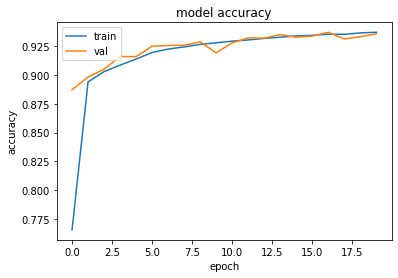

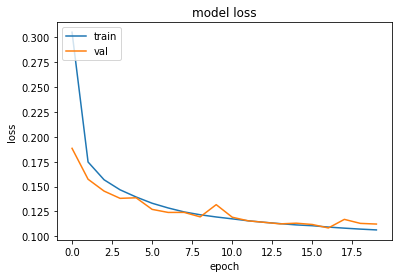

In [ ]:
# summarize history for accuracy
plt.plot(history_trans_pro.history['accuracy'])
plt.plot(history_trans_pro.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history_trans_pro.history['loss'])
plt.plot(history_trans_pro.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

##### Evaluation

In [ ]:
results_trans_train_pro = model_trans_pro.evaluate(train_padded_pro, train_labels, batch_size=32)
results_trans_val_pro = model_trans_pro.evaluate(val_padded_pro, val_labels, batch_size=32)
results_trans_test_pro = model_trans_pro.evaluate(test_padded_pro, test_labels, batch_size=32)

1639/1639 [==============================] - 30s 18ms/step - loss: 0.1134 - accuracy: 0.9352


##### Save Model

In [ ]:
model_trans_pro.save('/content/drive/MyDrive/Nissrine/Misclassified/Proteines_Transformers')

### ARN

#### Bi-LSTM

##### The Model

In [ ]:
x_input = Input(shape=(max_length_rna,), name="Input_Layer")

emb = Embedding(len(codon_index), 100, input_length=max_length, name="Embedding_Layer")(x_input)
bi_rnn = Bidirectional(LSTM(50), name="Bidirectional_LSTM_Layer")(emb)
x = Dropout(0.1, name="Dropout_Layer_1")(bi_rnn)
x = Dense(100, activation='relu', name="Dense_Layer_1")(x)
x = Dense(100, activation='relu', name="Dense_Layer_2")(x)

x_output = Dense(3, activation='softmax', name="Softmax_Layer_1")(x)
model_lstm_arn = Model(inputs=x_input, outputs=x_output)

In [ ]:
model_lstm_arn.compile("adam", "binary_crossentropy", metrics=["accuracy"])
model_lstm_arn.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_Layer (InputLayer)    [(None, 770)]             0         
                                                                 
 Embedding_Layer (Embedding)  (None, 770, 100)         6100      
                                                                 
 Bidirectional_LSTM_Layer (B  (None, 100)              60400     
 idirectional)                                                   
                                                                 
 Dropout_Layer_1 (Dropout)   (None, 100)               0         
                                                                 
 Dense_Layer_1 (Dense)       (None, 100)               10100     
                                                                 
 Dense_Layer_2 (Dense)       (None, 100)               10100     
                                                           

##### Training

In [ ]:
history_lstm_arn = model_lstm_arn.fit(
  train_padded_arn, train_labels,
  epochs=50, batch_size=32,
  validation_data=(val_padded_arn, val_labels),
  callbacks=[es]
  )

Epoch 1/50
7650/7650 [==============================] - 334s 43ms/step - loss: 0.1993 - accuracy: 0.8767 - val_loss: 0.1369 - val_accuracy: 0.9210
Epoch 2/50
7650/7650 [==============================] - 329s 43ms/step - loss: 0.1287 - accuracy: 0.9254 - val_loss: 0.1203 - val_accuracy: 0.9301
Epoch 3/50
7650/7650 [==============================] - 329s 43ms/step - loss: 0.1141 - accuracy: 0.9348 - val_loss: 0.1109 - val_accuracy: 0.9387
Epoch 4/50
7650/7650 [==============================] - 330s 43ms/step - loss: 0.1058 - accuracy: 0.9403 - val_loss: 0.0987 - val_accuracy: 0.9470
Epoch 5/50
7650/7650 [==============================] - 329s 43ms/step - loss: 0.1002 - accuracy: 0.9437 - val_loss: 0.0989 - val_accuracy: 0.9432
Epoch 6/50
7650/7650 [==============================] - 330s 43ms/step - loss: 0.0965 - accuracy: 0.9465 - val_loss: 0.0942 - val_accuracy: 0.9483
Epoch 7/50
7650/7650 [==============================] - 331s 43ms/step - loss: 0.0936 - accuracy: 0.9484 - val_loss: 0

##### Plot History

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


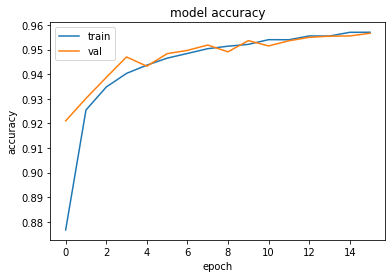

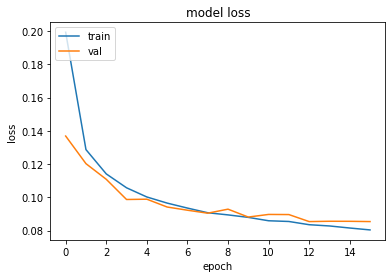

In [ ]:
# list all data in history
print(history_lstm_arn.history.keys())
# summarize history for accuracy
plt.plot(history_lstm_arn.history['accuracy'])
plt.plot(history_lstm_arn.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history_lstm_arn.history['loss'])
plt.plot(history_lstm_arn.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

##### Evaluation

In [ ]:
results_lstm_train_arn = model_lstm_arn.evaluate(train_padded_arn, train_labels, batch_size=32)
results_lstm_val_arn = model_lstm_arn.evaluate(val_padded_arn, val_labels, batch_size=32)
results_lstm_test_arn = model_lstm_arn.evaluate(test_padded_arn, test_labels, batch_size=32)

1639/1639 [==============================] - 29s 18ms/step - loss: 0.0849 - accuracy: 0.9565


##### Save Model

In [ ]:
model_lstm_arn.save('/content/drive/MyDrive/Nissrine/Misclassified/ARN_Bi-LSTM')

#### Transformers

##### The Model

In [ ]:
embed_dim = 100  # Embedding size for each token
num_heads = 2  # Number of attention heads
ff_dim = 50  # Hidden layer size in feed forward network inside transformer

inputs = layers.Input(shape=(max_length_rna,), name="Input_Layer")
embedding_layer = TokenAndPositionEmbedding(max_length_rna, len(codon_index), embed_dim)
x = embedding_layer(inputs)

transformer_block = TransformerBlock(embed_dim, num_heads, ff_dim)
x = transformer_block(x)

x = layers.GlobalAveragePooling1D(name="GlobalAveragePooling1D_Layer")(x)
x = layers.Dropout(0.1, name="Dropout_Layer_1")(x)

x = layers.Dense(100, activation="relu", name="Dense_Layer_1")(x)
x = layers.Dropout(0.1, name="Dropout_Layer_2")(x)

x = layers.Dense(100, activation="relu", name="Dense_Layer_2")(x)
x = layers.Dropout(0.1, name="Dropout_Layer_3")(x)

outputs = layers.Dense(3, activation="softmax", name="Softmax_Layer_1")(x)

model_trans_arn = keras.Model(inputs=inputs, outputs=outputs)

In [ ]:
model_trans_arn.compile("adam", "binary_crossentropy", metrics=["accuracy"])
model_trans_arn.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_Layer (InputLayer)    [(None, 770)]             0         
                                                                 
 token_and_position_embeddin  (None, 770, 100)         83100     
 g_2 (TokenAndPositionEmbedd                                     
 ing)                                                            
                                                                 
 transformer_block_2 (Transf  (None, 770, 100)         91250     
 ormerBlock)                                                     
                                                                 
 GlobalAveragePooling1D_Laye  (None, 100)              0         
 r (GlobalAveragePooling1D)                                      
                                                                 
 Dropout_Layer_1 (Dropout)   (None, 100)               0   

##### Training

In [ ]:
history_trans_arn = model_trans_arn.fit(
  train_padded_arn, train_labels,
  epochs=50, batch_size=32,
  validation_data=(val_padded_arn, val_labels),
  callbacks=[es]
  )

Epoch 1/50
7650/7650 [==============================] - 391s 50ms/step - loss: 0.2006 - accuracy: 0.8660 - val_loss: 0.1518 - val_accuracy: 0.9115
Epoch 2/50
7650/7650 [==============================] - 389s 51ms/step - loss: 0.1381 - accuracy: 0.9160 - val_loss: 0.1355 - val_accuracy: 0.9191
Epoch 3/50
7650/7650 [==============================] - 389s 51ms/step - loss: 0.1255 - accuracy: 0.9233 - val_loss: 0.1285 - val_accuracy: 0.9221
Epoch 4/50
7650/7650 [==============================] - 389s 51ms/step - loss: 0.1175 - accuracy: 0.9289 - val_loss: 0.1119 - val_accuracy: 0.9347
Epoch 5/50
7650/7650 [==============================] - 389s 51ms/step - loss: 0.1109 - accuracy: 0.9343 - val_loss: 0.1112 - val_accuracy: 0.9372
Epoch 6/50
7650/7650 [==============================] - 390s 51ms/step - loss: 0.1055 - accuracy: 0.9391 - val_loss: 0.1158 - val_accuracy: 0.9378
Epoch 7/50
7650/7650 [==============================] - 389s 51ms/step - loss: 0.1018 - accuracy: 0.9418 - val_loss: 0

##### Plot History

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


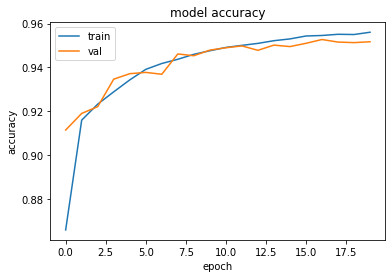

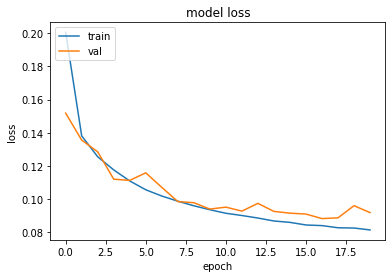

In [ ]:
# list all data in history
print(history_trans_arn.history.keys())
# summarize history for accuracy
plt.plot(history_trans_arn.history['accuracy'])
plt.plot(history_trans_arn.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history_trans_arn.history['loss'])
plt.plot(history_trans_arn.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

##### Evaluation

In [ ]:
results_trans_train_arn = model_trans_arn.evaluate(train_padded_arn, train_labels, batch_size=32)
results_trans_val_arn = model_trans_arn.evaluate(val_padded_arn, val_labels, batch_size=32)
results_trans_test_arn = model_trans_arn.evaluate(test_padded_arn, test_labels, batch_size=32)

1639/1639 [==============================] - 30s 18ms/step - loss: 0.0911 - accuracy: 0.9511


##### Save Model

In [ ]:
model_trans_arn.save('/content/drive/MyDrive/Nissrine/Misclassified/ARN_Transformers')

## Latent Space Visualization

In [ ]:
test_set = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Train_Val_Test/test_df.xlsx')
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(test_set.Sequence, test_set.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  3
Taille Maximale des séquences :  2301


### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (52448, 3)


### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 56, 45]


In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  767


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (52448, 770)


### Predictions


In [ ]:
model_arn_lstm.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_Layer (InputLayer)    [(None, 770)]             0         
                                                                 
 Embedding_Layer (Embedding)  (None, 770, 100)         6100      
                                                                 
 Bidirectional_LSTM_Layer (B  (None, 100)              60400     
 idirectional)                                                   
                                                                 
 Dropout_Layer_1 (Dropout)   (None, 100)               0         
                                                                 
 Dense_Layer_1 (Dense)       (None, 100)               10100     
                                                                 
 Dense_Layer_2 (Dense)       (None, 100)               10100     
                                                           

In [ ]:
test_loss, test_accuracy = model_arn_lstm.evaluate(test_padded_arn, test_labels, batch_size=32)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

1639/1639 [==============================] - 28s 17ms/step - loss: 0.0849 - accuracy: 0.9565
Test Loss: 0.08486826717853546
Test Accuracy: 0.9564902186393738


In [ ]:
arn_lstm = model_arn_lstm.predict(test_padded_arn, batch_size=32)

1639/1639 [==============================] - 27s 16ms/step


In [ ]:
tiers = {
    (0.95, 1.0): '[95-100]',
    (0.9, 0.95): '[90-95]',
    (0.85, 0.9): '[85-90]',
    (0.8, 0.85): '[80-85]',
    (0.75, 0.8): '[75-80]',
    (0.7, 0.75): '[70-75]',
    (0.65, 0.7): '[65-70]',
    (0.6, 0.65): '[60-65]',
    (0.55, 0.6): '[55-60]',
    (0.5, 0.55): '[50-55]',
    (0.45, 0.5): '[45-50]',
    (0.4, 0.45): '[40-45]',
    (0.35, 0.4): '[35-40]',
    (0.3, 0.35): '[30-35]',
}


def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    for range_, tier in tiers.items():
      if max >= range_[0] and max < range_[1]:
          tier = tier
          break 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, arn_lstm)

In [ ]:
df_test_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_test_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Avian
1,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human
2,[95-100],Human,1.000,0.000,1.000,0.000,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Human
3,[95-100],Swine,1.000,0.000,0.000,1.000,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Swine
4,[95-100],Human,1.000,0.000,1.000,0.000,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Human
...,...,...,...,...,...,...,...,...
52443,[95-100],Swine,1.000,0.000,0.000,1.000,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Swine
52444,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Swine
52445,[95-100],Swine,1.000,0.000,0.000,1.000,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Swine
52446,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Swine


In [ ]:
df=test_set
df= df.drop("Accession", axis=1)
df= df.drop("Host", axis=1)
df= df.drop("Sequence", axis=1)

df

,Database,Segment
0,NCBI,PB2
1,NCBI,HA
2,NCBI,PB2
3,NCBI,NS
4,NCBI,HA
...,...,...
52445,FLU DB,HA
52446,NCBI,_NA_
52447,NCBI,PB2
52448,NCBI,HA


In [ ]:
result = pd.concat([df, df_test_arn_lstm], axis=1).reindex(df_test_arn_lstm.index)
result

,Database,Segment,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,NCBI,PB2,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Avian
1,NCBI,HA,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human
2,NCBI,PB2,[95-100],Human,1.000,0.000,1.000,0.000,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Human
3,NCBI,NS,[95-100],Swine,1.000,0.000,0.000,1.000,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Swine
4,NCBI,HA,[95-100],Human,1.000,0.000,1.000,0.000,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Human
...,...,...,...,...,...,...,...,...,...,...
52443,NCBI,NP,[95-100],Swine,1.000,0.000,0.000,1.000,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Swine
52444,NCBI,PB1,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Swine
52445,FLU DB,HA,[95-100],Swine,1.000,0.000,0.000,1.000,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Swine
52446,NCBI,_NA_,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Swine


In [ ]:
result.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_test_arn_lstm.xlsx')

### Latent Space

In [ ]:
latent_space_model = tf.keras.models.Model(inputs=model_arn_lstm.input, outputs=model_arn_lstm.layers[-1].output)

In [ ]:
latent_space = latent_space_model.predict(test_padded_arn, batch_size=32)

1639/1639 [==============================] - 26s 15ms/step


In [ ]:
print("Taille de l'espace latent avant réduction : ", latent_space.shape)

Taille de l'espace latent avant réduction :  (52448, 3)


In [ ]:
mapper_rna = umap.UMAP(n_neighbors=15, min_dist=0.8, n_components=2, metric='canberra', random_state=42).fit(latent_space)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result)),'tiers':result['tiers'], 'host':result['host'], 'pred_class':result['pred_class']})
p_rna = umap.plot.interactive(mapper_rna, labels=result['pred_class'], hover_data=hover_data_rna,color_key_cmap='prism', point_size=3)
output_notebook()
show(p_rna)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result)),'tiers':result['tiers'], 'host':result['host'], 'pred_class':result['pred_class']})
p_rna = umap.plot.interactive(mapper_rna, labels=result['tiers'], hover_data=hover_data_rna,color_key_cmap='ocean', point_size=2.5)
output_notebook()
show(p_rna)

### K-means

In [ ]:
X_rna=mapper_rna.embedding_
X_rna

array([[ 11.772037 ,   6.5083365],
       [-14.407825 ,  -0.5347613],
       [-15.72872  ,   9.656747 ],
       ...,
       [  2.90898  ,  -5.3644447],
       [ 10.374342 ,   1.0672169],
       [  1.8066077,   0.8093277]], dtype=float32)

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3)
kmeans.fit(X_rna)
y_kmeans_rna = kmeans.predict(X_rna)

In [ ]:
df=result
avian_indices = df[(df['pred_class'] == 'Avian') & (df['host'] == 'Avian')].index[:1000]
human_indices = df[(df['pred_class'] == 'Human') & (df['host'] == 'Human')].index[:1000]
swine_indices = df[(df['pred_class'] == 'Swine') & (df['host'] == 'Swine')].index[:1000]

##### Avian

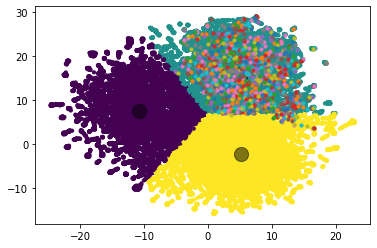

In [ ]:
plt.scatter(X_rna[:, 0], X_rna[:, 1], c=y_kmeans_rna, s=10, cmap='viridis')

centers_rna = kmeans.cluster_centers_
plt.scatter(centers_rna[:, 0], centers_rna[:, 1], c='black', s=200, alpha=0.5);
for i in avian_indices:
  plt.scatter(X_rna[i, 0], X_rna[i, 1], s=10)

In [ ]:
centers_rna

array([[-10.757223,   7.443989],
       [  5.121582,  15.939154],
       [  5.24963 ,  -2.317266]], dtype=float32)

In [ ]:
import numpy as np
dist=[]
for i in avian_indices:
  for j in range(len(centers_rna)):
    dist.append(np.linalg.norm(centers_rna[j] - X_rna[i]))
#print(dist)
shape = (len(avian_indices),len(centers_rna))
dist_avian = np.array(dist)
dist_avian.reshape(shape)


array([[22.54868  , 11.539881 , 10.974199 ],
       [26.434671 ,  8.851927 , 25.64004  ],
       [24.818628 ,  7.4805117, 19.580837 ],
       ...,
       [23.12319  ,  8.2727165, 15.286773 ],
       [21.968737 ,  7.8485904, 26.055447 ],
       [13.322417 ,  8.570832 , 10.429274 ]], dtype=float32)

In [ ]:
dist_df_avian = pd.DataFrame(dist_avian.reshape(shape), columns = ['distHuman','distAvian','distSwine'])
dist_df_avian

,distHuman,distAvian,distSwine
0,22.548679,11.539881,10.974199
1,26.434671,8.851927,25.640039
2,24.818628,7.480512,19.580837
3,23.059284,11.192196,11.969277
4,27.217932,12.290529,17.082565
...,...,...,...
995,25.130253,10.487217,28.729935
996,14.693319,4.269541,14.611851
997,23.123190,8.272717,15.286773
998,21.968737,7.848590,26.055447


In [ ]:
dist_df_avian.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/kmeans_dist_euc/dist_df_avian.xlsx')

##### Human

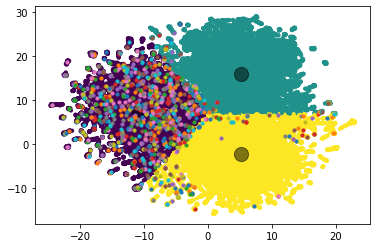

In [ ]:
plt.scatter(X_rna[:, 0], X_rna[:, 1], c=y_kmeans_rna, s=10, cmap='viridis')

centers_rna = kmeans.cluster_centers_
plt.scatter(centers_rna[:, 0], centers_rna[:, 1], c='black', s=200, alpha=0.5);
for i in human_indices:
  plt.scatter(X_rna[i, 0], X_rna[i, 1], s=10)

In [ ]:
centers_rna

array([[-10.757223,   7.443989],
       [  5.121582,  15.939154],
       [  5.24963 ,  -2.317266]], dtype=float32)

In [ ]:
import numpy as np
dist=[]
for i in human_indices:
  for j in range(len(centers_rna)):
    dist.append(np.linalg.norm(centers_rna[j] - X_rna[i]))
#print(dist)
shape = (len(human_indices),len(centers_rna))
dist_human= np.array(dist)
dist_human.reshape(shape)


array([[ 8.774243 , 25.54971  , 19.738108 ],
       [ 5.441698 , 21.776218 , 24.155085 ],
       [ 1.3721175, 17.766697 , 19.777397 ],
       ...,
       [14.1348715, 27.380476 , 32.86186  ],
       [ 9.803713 ,  8.401987 , 14.826967 ],
       [ 2.334399 , 20.12237  , 19.047789 ]], dtype=float32)

In [ ]:
dist_df_human = pd.DataFrame(dist_human.reshape(shape), columns = ['distHuman','distAvian','distSwine'])
dist_df_human

,distHuman,distAvian,distSwine
0,8.774243,25.549709,19.738108
1,5.441698,21.776218,24.155085
2,1.372118,17.766697,19.777397
3,10.890372,18.429506,27.478968
4,14.498859,10.492811,24.709969
...,...,...,...
995,2.258467,19.018902,20.991503
996,6.069552,13.746291,20.451674
997,14.134871,27.380476,32.861858
998,9.803713,8.401987,14.826967


In [ ]:
dist_df_human = dist_df_human[['distAvian', 'distHuman', 'distSwine']]
dist_df_human.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/kmeans_dist_euc/dist_df_human.xlsx')

##### Swine

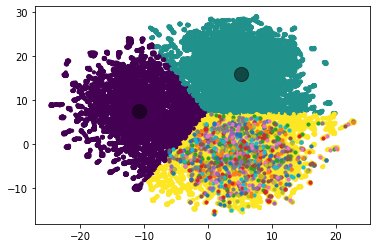

In [ ]:
plt.scatter(X_rna[:, 0], X_rna[:, 1], c=y_kmeans_rna, s=10, cmap='viridis')

centers_rna = kmeans.cluster_centers_
plt.scatter(centers_rna[:, 0], centers_rna[:, 1], c='black', s=200, alpha=0.5);
for i in swine_indices:
  plt.scatter(X_rna[i, 0], X_rna[i, 1], s=10)

In [ ]:
centers_rna

array([[-10.757223,   7.443989],
       [  5.121582,  15.939154],
       [  5.24963 ,  -2.317266]], dtype=float32)

In [ ]:
import numpy as np
dist=[]
for i in swine_indices:
  for j in range(len(centers_rna)):
    dist.append(np.linalg.norm(centers_rna[j] - X_rna[i]))
#print(dist)
shape = (len(swine_indices),len(centers_rna))
dist_swine= np.array(dist)
dist_swine.reshape(shape)


array([[25.169777 , 30.022709 , 11.975237 ],
       [16.380377 ,  9.997784 ,  8.27367  ],
       [19.65995  , 21.642284 ,  3.6156406],
       ...,
       [20.172337 , 17.804365 ,  2.0345402],
       [29.64835  , 24.495611 , 11.018775 ],
       [26.34512  , 18.243097 ,  9.744601 ]], dtype=float32)

In [ ]:
dist_df_swine = pd.DataFrame(dist_swine.reshape(shape), columns = ['distHuman','distAvian','distSwine'])
dist_df_swine

,distHuman,distAvian,distSwine
0,25.169777,30.022709,11.975237
1,16.380377,9.997784,8.273670
2,19.659950,21.642284,3.615641
3,22.773857,15.944317,6.843363
4,12.615956,14.476814,6.382204
...,...,...,...
995,17.164062,12.282191,6.050588
996,31.976591,22.564465,14.916557
997,20.172337,17.804365,2.034540
998,29.648350,24.495611,11.018775


In [ ]:
dist_df_swine = dist_df_swine[['distAvian', 'distHuman', 'distSwine']]
dist_df_swine.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/kmeans_dist_euc/dist_df_swine.xlsx')

## Test set augmentation 

In [ ]:
#test_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Testset_augmentation/test_df.xlsx')
#discarded_seq_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Testset_augmentation/discarded_seq_df.xlsx')

#test_set = pd.concat([test_df, discarded_seq_df])

#test_set.to_excel('/content/drive/MyDrive/Misclassified/Data/Testset_augmentation/test_set.xlsx', index=False)

In [ ]:
test_set = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Testset_augmentation/test_set.xlsx')
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(test_set.Sequence, test_set.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  3
Taille Maximale des séquences :  2337


### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (598414, 3)


### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 56, 45]


In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  779


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (598414, 770)


### Predictions


In [ ]:
model_arn_lstm.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input_Layer (InputLayer)    [(None, 770)]             0         
                                                                 
 Embedding_Layer (Embedding)  (None, 770, 100)         6100      
                                                                 
 Bidirectional_LSTM_Layer (B  (None, 100)              60400     
 idirectional)                                                   
                                                                 
 Dropout_Layer_1 (Dropout)   (None, 100)               0         
                                                                 
 Dense_Layer_1 (Dense)       (None, 100)               10100     
                                                                 
 Dense_Layer_2 (Dense)       (None, 100)               10100     
                                                           

In [ ]:
test_loss, test_accuracy = model_arn_lstm.evaluate(test_padded_arn, test_labels, batch_size=32)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

18701/18701 [==============================] - 409s 22ms/step - loss: 0.0835 - accuracy: 0.9666
Test Loss: 0.08350106328725815
Test Accuracy: 0.9666284322738647


In [ ]:
arn_lstm = model_arn_lstm.predict(test_padded_arn, batch_size=32)

18701/18701 [==============================] - 398s 21ms/step


In [ ]:
def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    if (max >=0.95 and max <=1):
      tier = '[95-100]'
    elif (max >=0.90 and max <0.95):
      tier = '[90-95]'
    elif (max >=0.85 and max <0.90):
      tier = '[85-90]'
    elif (max >=0.80 and max <0.85):
      tier = '[80-85]'
    elif (max >=0.75 and max <0.80):
      tier = '[75-80]'
    elif (max >=0.70 and max <0.75):
      tier = '[70-75]'
    elif (max >=0.65 and max <0.70):
      tier = '[65-70]'
    elif (max >=0.60 and max <0.65):
      tier = '[60-65]'
    elif (max >=0.55 and max <0.60):
      tier = '[55-60]'
    elif (max >=0.50 and max <0.55):
      tier = '[50-55]'      
    elif (max >=0.45 and max <0.50):
      tier = '[45-50]'
    elif (max >=0.40 and max <0.45):
      tier = '[40-45]'   
    elif (max >=0.35 and max <0.40):
      tier = '[35-40]'  
    elif (max >=0.30 and max <0.35):
      tier = '[30-35]' 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, arn_lstm)

In [ ]:
df_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Avian
1,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human
2,[95-100],Human,1.000,0.000,1.000,0.000,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Human
3,[95-100],Swine,1.000,0.000,0.000,1.000,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Swine
4,[95-100],Human,1.000,0.000,1.000,0.000,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Human
...,...,...,...,...,...,...,...,...
598409,[95-100],Swine,0.999,0.001,0.000,0.999,TAATTCCAATGATAAGCAAGTGCAGGACGAAAGAAGGAAGACGGAA...,Swine
598410,[90-95],Avian,0.938,0.938,0.024,0.037,GCGCAAAATGCTATAAGCACCACATTCCCTTATACTGGAGACCCTC...,Swine
598411,[95-100],Avian,0.979,0.979,0.011,0.010,ACCCTCCCTACAGTCATGGAACAGGGACAGGGTACACCATGGACAC...,Swine
598412,[90-95],Avian,0.938,0.938,0.024,0.037,CTCTACTTTTCTTGAAAGTGCCAGCGCAAAATGCTATAAGCACCAC...,Swine


In [ ]:
df=test_set
df= df.drop("Accession", axis=1)
df= df.drop("Host", axis=1)
df= df.drop("Sequence", axis=1)

df

,Database,Segment
0,NCBI,PB2
1,NCBI,HA
2,NCBI,PB2
3,NCBI,NS
4,NCBI,HA
...,...,...
598439,FLU DB,PA
598440,FLU DB,PB1
598441,FLU DB,PB1
598442,FLU DB,PB1


In [ ]:
result = pd.concat([df, df_arn_lstm], axis=1).reindex(df_arn_lstm.index)
result

,Database,Segment,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,NCBI,PB2,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Avian
1,NCBI,HA,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human
2,NCBI,PB2,[95-100],Human,1.000,0.000,1.000,0.000,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Human
3,NCBI,NS,[95-100],Swine,1.000,0.000,0.000,1.000,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Swine
4,NCBI,HA,[95-100],Human,1.000,0.000,1.000,0.000,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Human
...,...,...,...,...,...,...,...,...,...,...
598409,FLU DB,PB2,[95-100],Swine,0.999,0.001,0.000,0.999,TAATTCCAATGATAAGCAAGTGCAGGACGAAAGAAGGAAGACGGAA...,Swine
598410,FLU DB,PB2,[90-95],Avian,0.938,0.938,0.024,0.037,GCGCAAAATGCTATAAGCACCACATTCCCTTATACTGGAGACCCTC...,Swine
598411,FLU DB,PB2,[95-100],Avian,0.979,0.979,0.011,0.010,ACCCTCCCTACAGTCATGGAACAGGGACAGGGTACACCATGGACAC...,Swine
598412,FLU DB,PB2,[90-95],Avian,0.938,0.938,0.024,0.037,CTCTACTTTTCTTGAAAGTGCCAGCGCAAAATGCTATAAGCACCAC...,Swine


In [ ]:
result.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_arn_lstm.xlsx')

## Well/Misclassified Sequences

In [ ]:
df_arn_lstm = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_arn_lstm.xlsx')

In [ ]:
df_arn_lstm.head()

,Unnamed: 0,Database,Segment,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,0,NCBI,PB2,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Avian
1,1,NCBI,HA,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human
2,2,NCBI,PB2,[95-100],Human,1.000,0.000,1.000,0.000,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Human
3,3,NCBI,NS,[95-100],Swine,1.000,0.000,0.000,1.000,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Swine
4,4,NCBI,HA,[95-100],Human,1.000,0.000,1.000,0.000,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Human


In [ ]:
def groundTruth(data):
  
  x = (data['host']=='Avian') 
  y = (data['host']=='Human') 
  z = (data['host']=='Swine') 

  return(len(data[x]), len(data[y]), len(data[z]))

In [ ]:
def predictions(data):
  
  a = (data['pred_class']=='Avian') 
  b = (data['pred_class']=='Human') 
  c = (data['pred_class']=='Swine') 

  return(len(data[a]), len(data[b]), len(data[c]))

In [ ]:
def avian(data):
  
  avian_sur = (data['host']=='Avian') & (data['pred_class']=='Avian') 
  avian_ambigu = (data['host']=='Avian') & (data['pred_class']!='Avian') 
  avian_human = (data['host']=='Avian') & (data['pred_class']=='Human') 
  avian_swine = (data['host']=='Avian') & (data['pred_class']=='Swine') 

  return(avian_sur, avian_ambigu, avian_human, avian_swine)

In [ ]:
def human(data):

  human_sur = (data['host']=='Human') & (data['pred_class']=='Human') 
  human_ambigu = (data['host']=='Human') & (data['pred_class']!='Human') 
  human_avian = (data['host']=='Human') & (data['pred_class']=='Avian') 
  human_swine = (data['host']=='Human') & (data['pred_class']=='Swine') 

  return(human_sur, human_ambigu, human_avian, human_swine)

In [ ]:
def swine(data):

  swine_sur = (data['host']=='Swine') & (data['pred_class']=='Swine') 
  swine_ambigu = (data['host']=='Swine') & (data['pred_class']!='Swine') 
  swine_avian = (data['host']=='Swine') & (data['pred_class']=='Avian') 
  swine_human = (data['host']=='Swine') & (data['pred_class']=='Human') 

  return(swine_sur, swine_ambigu, swine_avian, swine_human)

In [ ]:
x, y, z = groundTruth(df_arn_lstm)
a, b, c = predictions(df_arn_lstm)

avian_sur_arn_lstm, avian_ambigu_arn_lstm, avian_human_arn_lstm, avian_swine_arn_lstm = avian(df_arn_lstm)
human_sur_arn_lstm, human_ambigu_arn_lstm, human_avian_arn_lstm, human_swine_arn_lstm = human(df_arn_lstm)
swine_sur_arn_lstm, swine_ambigu_arn_lstm, swine_avian_arn_lstm, swine_human_arn_lstm = swine(df_arn_lstm)

In [ ]:
def plot_avian(data, avian_sur, avian_human, avian_swine):
  labels = 'avian_sur','avian_human','avian_swine'
  sizes = [len(data[avian_sur]), len(data[avian_human]), len(data[avian_swine])]
  explode = (0, 0.1, 0.2)  

  fig1, ax1 = plt.subplots()
  ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%', shadow=False, startangle=90)
  ax1.axis('equal') 

  plt.show()

In [ ]:
def plot_human(data, human_sur, human_avian, human_swine):
  labels = 'human_sur','human_avian','human_swine'
  sizes = [len(data[human_sur]), len(data[human_avian]), len(data[human_swine])]
  explode = (0, 0.1, 0.2)  

  fig1, ax1 = plt.subplots()
  ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%', shadow=False, startangle=90)
  ax1.axis('equal') 

  plt.show()

In [ ]:
def plot_swine(data, swine_sur, swine_avian, swine_human):
  labels = 'swine_sur','swine_avian','swine_human'
  sizes = [len(data[swine_sur]), len(data[swine_avian]), len(data[swine_human])]
  explode = (0, 0.1, 0.2)  

  fig1, ax1 = plt.subplots()
  ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%', shadow=False, startangle=90)
  ax1.axis('equal') 

  plt.show()

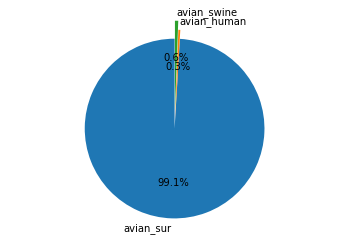

In [ ]:
plot_avian(df_arn_lstm, avian_sur_arn_lstm, avian_human_arn_lstm, avian_swine_arn_lstm)

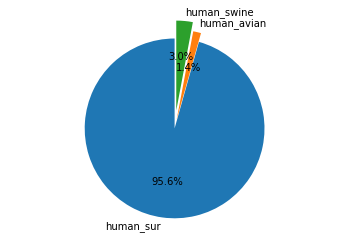

In [ ]:
plot_human(df_arn_lstm, human_sur_arn_lstm, human_avian_arn_lstm, human_swine_arn_lstm)

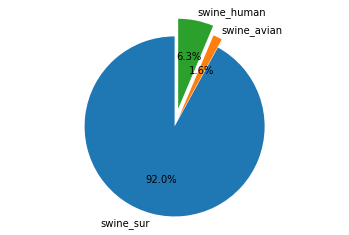

In [ ]:
plot_swine(df_arn_lstm, swine_sur_arn_lstm, swine_avian_arn_lstm, swine_human_arn_lstm)

## ZT well/misclassified

### H1N1_2009

#### H1N1_2009 & test_set

In [ ]:
zoonotic_seq_1 = pd.read_excel('/content/drive/MyDrive/Nissrine/misclassified/H1N1_2009.xlsx')
zoonotic_seq_1['Gene'].fillna('NA', inplace=True)

zoonotic_seq_1['Host']='Swine'
zoonotic_seq_1['State']='New'

zoonotic_seq_1 = zoonotic_seq_1.drop('Virus_Name', axis=1)
zoonotic_seq_1 = zoonotic_seq_1.drop('Taxonomy', axis=1)
zoonotic_seq_1 = zoonotic_seq_1.drop('Detected_in', axis=1)
zoonotic_seq_1 = zoonotic_seq_1.drop('Reference', axis=1)

# Get the column names of df1
column_names = test_set.columns

# Reorder the columns of df2 to match the order of df1
zoonotic_seq_1 = zoonotic_seq_1.reindex(columns=column_names)
zoonotic_seq_1.head()

,Accession_number,Database,Gene,Host,Sequence,State
0,GQ117067,GenBank,HA,Swine,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,New
1,GQ117063,GenBank,NP,Swine,ATGGCGTCTCAAGGCACCAAACGATCATATGAACAAATGGAGACTG...,New
2,GQ117064,GenBank,NA,Swine,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,New
3,GQ117066,GenBank,M,Swine,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,New
4,GQ117065,GenBank,NS,Swine,ATGGACTCCAACACCATGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,New


In [ ]:
len(zoonotic_seq_1)

476

#### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(zoonotic_seq_1.Sequence, zoonotic_seq_1.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

#### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  18
Taille Maximale des séquences :  2277


#### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (476, 1)


#### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 42, 31, 11, 7, 15, 13, 8, 7, 33, 27, 1, 31, 26, 31, 39, 31, 44, 27, 3, 47, 11, 58, 33, 35, 32, 40, 39, 19, 27, 44, 25, 15, 44, 27, 15, 7, 45, 42, 39, 15, 27, 15, 27, 36, 17, 13, 40, 5, 7, 45, 44, 42, 35, 40, 61, 41, 7, 48, 41, 7, 56, 61, 15, 30, 23, 4, 35, 4, 58, 41, 47, 40, 9, 29, 59, 49, 10, 8, 60, 39, 23, 46, 47, 45, 19, 6, 18, 27, 31, 55, 19, 49, 18, 34, 9, 16, 45, 27, 17, 54, 19, 44, 39, 60, 28, 47, 34, 23, 60, 43, 2, 10, 43, 33, 46, 46, 7, 56, 46, 37, 4, 55, 19, 16, 19, 19, 1, 45, 57, 1, 46, 11, 2, 22, 42, 27, 54, 19, 49, 22, 39, 35, 44, 20, 40, 41, 58, 15, 28, 31, 31, 47, 21, 35, 29, 60, 31, 41, 55, 2, 34, 41, 39, 3, 11, 49, 7, 13, 41, 41, 60, 39, 19, 34, 23, 42, 6, 55, 41, 18, 34, 9, 39, 43, 41, 61, 41, 45, 14, 6, 16, 7, 49, 59, 9, 36, 35, 23, 17, 25, 54, 29, 44, 37, 37, 54, 6, 33, 38, 39, 31, 43, 31, 33, 13, 1, 16, 61, 19, 19, 56, 34, 55, 42, 42, 2, 42, 24, 45, 11, 31, 11, 56, 22, 41, 16, 57, 43, 37, 45, 61, 56, 12, 40, 33, 34, 49, 27, 7, 15, 46, 24, 60, 44, 41, 11, 27, 2

In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  759


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (476, 770)


In [ ]:
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Nissrine/misclassified/ARN_Bi-LSTM')

In [ ]:
zoonotic_lstm = model_arn_lstm.predict(test_padded_arn) 

15/15 [==============================] - 1s 26ms/step


In [ ]:
def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    if (max >=0.95 and max <=1):
      tier = '[95-100]'
    elif (max >=0.90 and max <0.95):
      tier = '[90-95]'
    elif (max >=0.85 and max <0.90):
      tier = '[85-90]'
    elif (max >=0.80 and max <0.85):
      tier = '[80-85]'
    elif (max >=0.75 and max <0.80):
      tier = '[75-80]'
    elif (max >=0.70 and max <0.75):
      tier = '[70-75]'
    elif (max >=0.65 and max <0.70):
      tier = '[65-70]'
    elif (max >=0.60 and max <0.65):
      tier = '[60-65]'
    elif (max >=0.55 and max <0.60):
      tier = '[55-60]'
    elif (max >=0.50 and max <0.55):
      tier = '[50-55]'      
    elif (max >=0.45 and max <0.50):
      tier = '[45-50]'
    elif (max >=0.40 and max <0.45):
      tier = '[40-45]'   
    elif (max >=0.35 and max <0.40):
      tier = '[35-40]'  
    elif (max >=0.30 and max <0.35):
      tier = '[30-35]' 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, zoonotic_lstm)

In [ ]:
df_zoonotic_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_zoonotic_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Human,0.971,0.001,0.971,0.028,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,Swine
1,[90-95],Human,0.932,0.000,0.932,0.068,ATGGCGTCTCAAGGCACCAAACGATCATATGAACAAATGGAGACTG...,Swine
2,[90-95],Human,0.906,0.000,0.906,0.093,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,Swine
3,[65-70],Swine,0.668,0.001,0.331,0.668,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,Swine
4,[60-65],Human,0.615,0.001,0.615,0.385,ATGGACTCCAACACCATGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,Swine
...,...,...,...,...,...,...,...,...
471,[80-85],Human,0.801,0.001,0.801,0.198,ATGGATGTCAATCCGACTCTACTTTTCCTAAAAATTCCAGCGCAAA...,Swine
472,[95-100],Human,0.971,0.001,0.971,0.028,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,Swine
473,[90-95],Human,0.906,0.000,0.906,0.094,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,Swine
474,[65-70],Swine,0.668,0.001,0.331,0.668,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,Swine


#### %

In [ ]:
import pandas as pd

df=df_zoonotic_arn_lstm
# Calculate percentage of each combination
df['group'] = df.apply(lambda x: x['host'] if x['host'] == x['pred_class'] else f"{x['host']}_{x['pred_class']}", axis=1)
grouped = df.groupby('group').size().reset_index(name='count')
grouped['percentage'] = grouped['count'] / len(df) * 100

print(grouped)


         group  count  percentage
0        Swine     76   15.966387
1  Swine_Human    400   84.033613


### Transmission_to_Human

In [ ]:
zoonotic_seq_2 = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Zoonotic_Viruses/Transmission_to_Human.xlsx')

zoonotic_seq_2['State']='New'
zoonotic_seq_2 = zoonotic_seq_2.rename(columns={'Origin': 'Host'})

zoonotic_seq_2 = zoonotic_seq_2.drop('Virus_Name', axis=1)
zoonotic_seq_2 = zoonotic_seq_2.drop('Virus_type', axis=1)

zoonotic_seq_2 = zoonotic_seq_2.drop('Taxon', axis=1)
zoonotic_seq_2 = zoonotic_seq_2.drop('Detected_in', axis=1)
zoonotic_seq_2 = zoonotic_seq_2.drop('Reference', axis=1)


# Reorder the columns of df2 to match the order of df1
zoonotic_seq_2.head()

,Gene,Accession_number,Database,Host,Sequence,State
0,PB2,AJ293920,NCBI,Swine,AGCAAAAGCAGGTCAATTATATTCAATATGGAGAGAATAAAAGAAT...,New
1,PB1,AJ293921,NCBI,Swine,GAATGGATGTCAACCCGACTCTACTTTTCTTGAAAGTGCCAGCGCA...,New
2,PA,AJ293922,NCBI,Swine,AGCAAAAGCAGGTACTGATTCAAAATGGAAGACTTTGTGCGACAGT...,New
3,NaN,AJ293923,NCBI,Swine,AGCAAAAGCAGGAGTGAAAATGAATCCAAATCAAAAGATAATAACA...,New
4,NP,AJ293924,NCBI,Swine,AGCAGGGTTAATAATCACTCACTGAGTGACATCAACATCATGGCGT...,New


In [ ]:
df=zoonotic_seq_2
# filter the dataframe based on the host value
df_avian = (df[df['Host'] == 'Avian']).reset_index(drop=True)
df_swine = (df[df['Host'] == 'Swine']).reset_index(drop=True)

# print the resulting dataframes
print(df_avian)
print(df_swine)


### Transmission_to_Human Avian

#### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(df_avian.Sequence, df_avian.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

#### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  12
Taille Maximale des séquences :  2277


#### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (23, 1)


#### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 39, 23, 39, 38, 42, 11, 11, 26, 9, 60, 19, 10, 47, 12, 15, 13, 61, 11, 9, 55, 4, 12, 3, 37, 9, 61, 40, 11, 10, 19, 11, 49, 14, 54, 35, 19, 9, 38, 27, 61, 39, 37, 36, 37, 29, 45, 23, 48, 39, 37, 55, 9, 9, 25, 33, 45, 40, 40, 26, 49, 15, 39, 37, 27, 33, 14, 40, 10, 55, 39, 26, 39, 1, 5, 25, 45, 41, 29, 16, 29, 19, 15, 27, 3, 32, 59, 39, 19, 17, 5, 48, 22, 9, 55, 60, 49, 29, 15, 36, 54, 42, 44, 40, 58, 11, 56, 10, 58, 18, 42, 61, 43, 16, 1, 13, 11, 56, 46, 24, 2, 10, 19, 48, 18, 36, 4, 45, 48, 56, 25, 2, 1, 4, 25, 38, 60, 30, 4, 8, 39, 44, 42, 36, 18, 39, 61, 26, 14, 41, 44, 56, 55, 21, 36, 56, 27, 4, 12, 54, 47, 21, 16, 58, 46, 29, 22, 18, 23, 33, 40, 19, 57, 1, 46, 17, 13, 29, 49, 20, 31, 54, 29, 48, 35, 43, 59, 26, 54, 49, 4, 27, 9, 60, 9, 17, 59, 23, 44, 39, 61, 29, 16, 29, 15, 4, 41, 34, 40, 59, 11, 11, 27, 44, 25, 10, 42, 54, 49, 57, 40, 40, 11, 8, 56, 25, 37, 46, 17, 45, 47, 31, 47, 15, 39, 59, 17, 48, 1, 25, 15, 12, 25, 44, 60, 23, 54, 39, 61, 38, 30, 19, 33, 42, 10, 2, 41, 1

In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  759


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (23, 770)


In [ ]:
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

In [ ]:
zoonotic_lstm = model_arn_lstm.predict(test_padded_arn) 

1/1 [==============================] - 8s 8s/step


In [ ]:
def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    if (max >=0.95 and max <=1):
      tier = '[95-100]'
    elif (max >=0.90 and max <0.95):
      tier = '[90-95]'
    elif (max >=0.85 and max <0.90):
      tier = '[85-90]'
    elif (max >=0.80 and max <0.85):
      tier = '[80-85]'
    elif (max >=0.75 and max <0.80):
      tier = '[75-80]'
    elif (max >=0.70 and max <0.75):
      tier = '[70-75]'
    elif (max >=0.65 and max <0.70):
      tier = '[65-70]'
    elif (max >=0.60 and max <0.65):
      tier = '[60-65]'
    elif (max >=0.55 and max <0.60):
      tier = '[55-60]'
    elif (max >=0.50 and max <0.55):
      tier = '[50-55]'      
    elif (max >=0.45 and max <0.50):
      tier = '[45-50]'
    elif (max >=0.40 and max <0.45):
      tier = '[40-45]'   
    elif (max >=0.35 and max <0.40):
      tier = '[35-40]'  
    elif (max >=0.30 and max <0.35):
      tier = '[30-35]' 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, zoonotic_lstm)

In [ ]:
df_zoonotic_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_zoonotic_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Avian,1.000,1.000,0.000,0.000,AGCAAAAGCAGGAGATTAAAATGAATCCAAATCAGAAGATAATAAC...,Avian
1,[95-100],Avian,0.999,0.999,0.001,0.000,GCAGGGGTATAATCTGTCAAAATGGAGAAAATAGTGCTTCTTCTTG...,Avian
2,[95-100],Avian,1.000,1.000,0.000,0.000,GTGACAAAGACATAATGGATTCCAACACGATAACCTCGTTTCAGGT...,Avian
3,[95-100],Avian,1.000,1.000,0.000,0.000,ATGGAGAGAATAGTGCTTCTTCTTGCAATAGTCAGTCTTGTCAAAA...,Avian
4,[90-95],Avian,0.902,0.902,0.023,0.076,AGCAAAAGCAGGTCAATTATATTCAATATGGAAAGAATAAAAGACT...,Avian
5,[90-95],Avian,0.901,0.901,0.079,0.021,AGCAAAAGCAGGAGATTAAAATGAATCCAAATCAGAAGATAATAAC...,Avian
6,[45-50],Human,0.492,0.323,0.492,0.185,AGCAAAAGCAGGTACTGATCCAAAATGGAAGACTTTGTGCGACAAG...,Avian
7,[85-90],Swine,0.880,0.021,0.099,0.880,GCAGGGGTATAATCTGTCAAAATGGAGAAAATAGTGCTTCTTCTTG...,Avian
8,[95-100],Avian,0.967,0.967,0.016,0.017,AGCAAAAGCAGGGTAGATAATCACTCACTGAGTGACATCAACATCT...,Avian
9,[95-100],Avian,0.995,0.995,0.002,0.003,AGCAAAAGCAGGCAAACCATTTGAATGGATGTCAATCCGACTTTAT...,Avian


#### %

In [ ]:
df=df_zoonotic_arn_lstm
df['group'] = df.apply(lambda x: x['host'] if x['host'] == x['pred_class'] else f"{x['host']}_{x['pred_class']}", axis=1)
grouped = df.groupby('group').size().reset_index(name='count')
grouped['percentage'] = grouped['count'] / len(df) * 100

print(grouped)

         group  count  percentage
0        Avian     19   82.608696
1  Avian_Human      1    4.347826
2  Avian_Swine      3   13.043478


### Transmission_to_Human Swine

#### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(df_swine.Sequence, df_swine.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

#### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  3
Taille Maximale des séquences :  2277


#### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (85, 1)


#### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 46, 56, 11, 41, 45, 3, 56, 43, 7, 12, 19, 38, 17, 51, 25, 51, 46, 11, 8, 27, 41, 26, 25, 16, 44, 35, 12, 31, 11, 10, 41, 41, 34, 27, 19, 60, 56, 37, 46, 42, 40, 22, 29, 6, 56, 12, 41, 49, 12, 12, 31, 12, 41, 33, 24, 10, 27, 31, 40, 42, 56, 11, 12, 46, 12, 14, 21, 45, 56, 39, 45, 37, 60, 37, 27, 5, 49, 54, 42, 27, 39, 43, 29, 60, 19, 43, 57, 16, 12, 15, 19, 22, 7, 30, 15, 25, 49, 49, 39, 57, 39, 60, 24, 28, 27, 43, 27, 14, 35, 34, 24, 41, 14, 34, 41, 27, 33, 1, 45, 42, 13, 45, 57, 3, 41, 35, 61, 26, 1, 58, 21, 14, 35, 1, 52, 39, 37, 13, 41, 11, 51, 52, 56, 13, 44, 11, 40, 23, 59, 35, 31, 44, 6, 54, 30, 42, 45, 32, 37, 43, 14, 10, 12, 46, 14, 13, 2, 23, 39, 45, 16, 60, 30, 56, 11, 3, 27, 19, 46, 20, 37, 3, 27, 11, 27, 41, 46, 42, 41, 46, 46, 6, 38, 43, 47, 42, 9, 30, 21, 3, 12, 16, 31, 34, 12, 4, 45, 56, 45, 8, 13, 51, 41, 26, 56, 2, 7, 24, 15, 31, 59, 60, 27, 55, 54, 16, 34, 9, 45, 15, 3, 36, 8, 25, 37, 60, 26, 48, 49, 45, 38, 12, 34, 25, 23, 59, 61, 46, 16, 56, 40, 43, 43, 13, 44,

In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  759


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (85, 770)


In [ ]:
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

In [ ]:
zoonotic_lstm = model_arn_lstm.predict(test_padded_arn) 

3/3 [==============================] - 1s 36ms/step


In [ ]:
def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    if (max >=0.95 and max <=1):
      tier = '[95-100]'
    elif (max >=0.90 and max <0.95):
      tier = '[90-95]'
    elif (max >=0.85 and max <0.90):
      tier = '[85-90]'
    elif (max >=0.80 and max <0.85):
      tier = '[80-85]'
    elif (max >=0.75 and max <0.80):
      tier = '[75-80]'
    elif (max >=0.70 and max <0.75):
      tier = '[70-75]'
    elif (max >=0.65 and max <0.70):
      tier = '[65-70]'
    elif (max >=0.60 and max <0.65):
      tier = '[60-65]'
    elif (max >=0.55 and max <0.60):
      tier = '[55-60]'
    elif (max >=0.50 and max <0.55):
      tier = '[50-55]'      
    elif (max >=0.45 and max <0.50):
      tier = '[45-50]'
    elif (max >=0.40 and max <0.45):
      tier = '[40-45]'   
    elif (max >=0.35 and max <0.40):
      tier = '[35-40]'  
    elif (max >=0.30 and max <0.35):
      tier = '[30-35]' 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, zoonotic_lstm)

In [ ]:
df_zoonotic_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_zoonotic_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Swine,1.000,0.000,0.000,1.000,AGCAAAAGCAGGTCAATTATATTCAATATGGAGAGAATAAAAGAAT...,Swine
1,[95-100],Swine,1.000,0.000,0.000,1.000,GAATGGATGTCAACCCGACTCTACTTTTCTTGAAAGTGCCAGCGCA...,Swine
2,[95-100],Swine,1.000,0.000,0.000,1.000,AGCAAAAGCAGGTACTGATTCAAAATGGAAGACTTTGTGCGACAGT...,Swine
3,[95-100],Swine,1.000,0.000,0.000,1.000,AGCAAAAGCAGGAGTGAAAATGAATCCAAATCAAAAGATAATAACA...,Swine
4,[95-100],Swine,1.000,0.000,0.000,1.000,AGCAGGGTTAATAATCACTCACTGAGTGACATCAACATCATGGCGT...,Swine
...,...,...,...,...,...,...,...,...
80,[65-70],Avian,0.673,0.673,0.032,0.295,AGCAAAAGCAGGGTGACAAAAACATAATGGACTCCAACACCATGCA...,Swine
81,[45-50],Human,0.470,0.203,0.470,0.327,AGCAAAAGCAGGGGAAAAACAAAAGCAAAAAATGAAGGCAATATAG...,Swine
82,[95-100],Avian,0.997,0.997,0.001,0.002,AGCGAAAGCAGGCAAACCATTTGAATGGATGTCAATCCGACTCTAT...,Swine
83,[95-100],Avian,0.994,0.994,0.002,0.004,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGACT...,Swine


#### %

In [ ]:
df=df_zoonotic_arn_lstm
df['group'] = df.apply(lambda x: x['host'] if x['host'] == x['pred_class'] else f"{x['host']}_{x['pred_class']}", axis=1)
grouped = df.groupby('group').size().reset_index(name='count')
grouped['percentage'] = grouped['count'] / len(df) * 100

print(grouped)

         group  count  percentage
0        Swine     70   82.352941
1  Swine_Avian     10   11.764706
2  Swine_Human      5    5.882353


## Re-Test H1N1_2009

### H1N1_2009 & test_set

In [ ]:
test_set = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Train_Val_Test/test_df.xlsx')
test_set = test_set.rename(columns={'Segment': 'Gene'})
test_set = test_set.rename(columns={'Accession': 'Accession_number'})
test_set['Gene'].fillna('NA', inplace=True)
test_set['State']='Old'
test_set.head()

,Accession_number,Database,Gene,Host,Sequence,State
0,AY862710,NCBI,PB2,Avian,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Old
1,KX088388,NCBI,HA,Human,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Old
2,MH080081,NCBI,PB2,Human,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Old
3,OP870882,NCBI,NS,Swine,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Old
4,OP775285,NCBI,HA,Human,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Old


In [ ]:
zoonotic_seq_1 = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Zoonotic_Viruses/H1N1_2009.xlsx')
zoonotic_seq_1['Gene'].fillna('NA', inplace=True)

zoonotic_seq_1['Host']='Swine'
zoonotic_seq_1['State']='New'

zoonotic_seq_1 = zoonotic_seq_1.drop('Virus_Name', axis=1)
zoonotic_seq_1 = zoonotic_seq_1.drop('Taxonomy', axis=1)
zoonotic_seq_1 = zoonotic_seq_1.drop('Detected_in', axis=1)
zoonotic_seq_1 = zoonotic_seq_1.drop('Reference', axis=1)

# Get the column names of df1
column_names = test_set.columns

# Reorder the columns of df2 to match the order of df1
zoonotic_seq_1 = zoonotic_seq_1.reindex(columns=column_names)
zoonotic_seq_1.head()

,Accession_number,Database,Gene,Host,Sequence,State
0,GQ117067,GenBank,HA,Swine,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,New
1,GQ117066,GenBank,M,Swine,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,New
2,GQ117064,GenBank,_NA_,Swine,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,New
3,GQ117063,GenBank,NP,Swine,ATGGCGTCTCAAGGCACCAAACGATCATATGAACAAATGGAGACTG...,New
4,GQ117065,GenBank,NS,Swine,ATGGACTCCAACACCATGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,New


In [ ]:
len(zoonotic_seq_1)

476

In [ ]:
df_concat = pd.concat([zoonotic_seq_1, test_set], ignore_index=True)
df_concat

,Accession_number,Database,Gene,Host,Sequence,State
0,GQ117067,GenBank,HA,Swine,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,New
1,GQ117066,GenBank,M,Swine,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,New
2,GQ117064,GenBank,_NA_,Swine,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,New
3,GQ117063,GenBank,NP,Swine,ATGGCGTCTCAAGGCACCAAACGATCATATGAACAAATGGAGACTG...,New
4,GQ117065,GenBank,NS,Swine,ATGGACTCCAACACCATGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,New
...,...,...,...,...,...,...
52921,JQ522629,FLU DB,HA,Swine,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Old
52922,MG520684,NCBI,_NA_,Swine,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Old
52923,MK367364,NCBI,PB2,Swine,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Old
52924,MW127168,NCBI,HA,Swine,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Old


### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(df_concat.Sequence, df_concat.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  3
Taille Maximale des séquences :  2301


### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (52924, 3)


### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 42, 31, 11, 7, 15, 13, 8, 7, 33, 27, 1, 31, 26, 31, 39, 31, 44, 27, 3, 47, 11, 58, 33, 35, 32, 40, 39, 19, 27, 44, 25, 15, 44, 27, 15, 7, 45, 42, 39, 15, 27, 15, 27, 36, 17, 13, 40, 5, 7, 45, 44, 42, 35, 40, 61, 41, 7, 48, 41, 7, 56, 61, 15, 30, 23, 4, 35, 4, 58, 41, 47, 40, 9, 29, 59, 49, 10, 8, 60, 39, 23, 46, 47, 45, 19, 6, 18, 27, 31, 55, 19, 49, 18, 34, 9, 16, 45, 27, 17, 54, 19, 44, 39, 60, 28, 47, 34, 23, 60, 43, 2, 10, 43, 33, 46, 46, 7, 56, 46, 37, 4, 55, 19, 16, 19, 19, 1, 45, 57, 1, 46, 11, 2, 22, 42, 27, 54, 19, 49, 22, 39, 35, 44, 20, 40, 41, 58, 15, 28, 31, 31, 47, 21, 35, 29, 60, 31, 41, 55, 2, 34, 41, 39, 3, 11, 49, 7, 13, 41, 41, 60, 39, 19, 34, 23, 42, 6, 55, 41, 18, 34, 9, 39, 43, 41, 61, 41, 45, 14, 6, 16, 7, 49, 59, 9, 36, 35, 23, 17, 25, 54, 29, 44, 37, 37, 54, 6, 33, 38, 39, 31, 43, 31, 33, 13, 1, 16, 61, 19, 19, 56, 34, 55, 42, 42, 2, 42, 24, 45, 11, 31, 11, 56, 22, 41, 16, 57, 43, 37, 45, 61, 56, 12, 40, 33, 34, 49, 27, 7, 15, 46, 24, 60, 44, 41, 11, 27, 2

In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  767


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (52924, 770)


In [ ]:
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

In [ ]:
zoonotic_lstm = model_arn_lstm.predict(test_padded_arn) 

1654/1654 [==============================] - 31s 16ms/step


In [ ]:
def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    if (max >=0.95 and max <=1):
      tier = '[95-100]'
    elif (max >=0.90 and max <0.95):
      tier = '[90-95]'
    elif (max >=0.85 and max <0.90):
      tier = '[85-90]'
    elif (max >=0.80 and max <0.85):
      tier = '[80-85]'
    elif (max >=0.75 and max <0.80):
      tier = '[75-80]'
    elif (max >=0.70 and max <0.75):
      tier = '[70-75]'
    elif (max >=0.65 and max <0.70):
      tier = '[65-70]'
    elif (max >=0.60 and max <0.65):
      tier = '[60-65]'
    elif (max >=0.55 and max <0.60):
      tier = '[55-60]'
    elif (max >=0.50 and max <0.55):
      tier = '[50-55]'      
    elif (max >=0.45 and max <0.50):
      tier = '[45-50]'
    elif (max >=0.40 and max <0.45):
      tier = '[40-45]'   
    elif (max >=0.35 and max <0.40):
      tier = '[35-40]'  
    elif (max >=0.30 and max <0.35):
      tier = '[30-35]' 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, zoonotic_lstm)

In [ ]:
df_zoonotic_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_zoonotic_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Human,0.971,0.001,0.971,0.028,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,Swine
1,[65-70],Swine,0.668,0.001,0.331,0.668,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,Swine
2,[90-95],Human,0.906,0.000,0.906,0.093,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,Swine
3,[90-95],Human,0.932,0.000,0.932,0.068,ATGGCGTCTCAAGGCACCAAACGATCATATGAACAAATGGAGACTG...,Swine
4,[60-65],Human,0.615,0.001,0.615,0.385,ATGGACTCCAACACCATGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,Swine
...,...,...,...,...,...,...,...,...
52919,[95-100],Swine,1.000,0.000,0.000,1.000,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Swine
52920,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Swine
52921,[95-100],Swine,1.000,0.000,0.000,1.000,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Swine
52922,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Swine


In [ ]:
df=zoonotic_seq_1
df= df.drop("Host", axis=1)
df= df.drop("Sequence", axis=1)
df.head()

,Accession_number,Database,Gene,State
0,GQ117067,GenBank,HA,New
1,GQ117066,GenBank,M,New
2,GQ117064,GenBank,_NA_,New
3,GQ117063,GenBank,NP,New
4,GQ117065,GenBank,NS,New


In [ ]:
result = pd.concat([df, df_zoonotic_arn_lstm], axis=1).reindex(df_zoonotic_arn_lstm.index)
result

,Accession_number,Database,Gene,State,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,GQ117067,GenBank,HA,New,[95-100],Human,0.971,0.001,0.971,0.028,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTGCAACCGCAA...,Swine
1,GQ117066,GenBank,M,New,[65-70],Swine,0.668,0.001,0.331,0.668,ATGAGTCTTCTAACCGAGGTCGAAACGTACGTTCTTTCTATCATCC...,Swine
2,GQ117064,GenBank,_NA_,New,[90-95],Human,0.906,0.000,0.906,0.093,ATGAATCCAAACCAAAAGATAATAACCATTGGTTCGGTCTGTATGA...,Swine
3,GQ117063,GenBank,NP,New,[90-95],Human,0.932,0.000,0.932,0.068,ATGGCGTCTCAAGGCACCAAACGATCATATGAACAAATGGAGACTG...,Swine
4,GQ117065,GenBank,NS,New,[60-65],Human,0.615,0.001,0.615,0.385,ATGGACTCCAACACCATGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,Swine
...,...,...,...,...,...,...,...,...,...,...,...,...
52919,NaN,NaN,NaN,NaN,[95-100],Swine,1.000,0.000,0.000,1.000,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Swine
52920,NaN,NaN,NaN,NaN,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Swine
52921,NaN,NaN,NaN,NaN,[95-100],Swine,1.000,0.000,0.000,1.000,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Swine
52922,NaN,NaN,NaN,NaN,[95-100],Swine,1.000,0.000,0.000,1.000,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Swine


In [ ]:
result.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_zoonotic_test_arn_lstm.xlsx')

In [ ]:
len(result)

52924

### Latent Space

In [ ]:
df_zoonotic_test_arn_lstm = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_zoonotic_test_arn_lstm.xlsx')

In [ ]:
latent_space_model = tf.keras.models.Model(inputs=model_arn_lstm.input, outputs=model_arn_lstm.layers[-1].output)

In [ ]:
latent_space = latent_space_model.predict(test_padded_arn, batch_size=32)

1654/1654 [==============================] - 26s 15ms/step


In [ ]:
print("Taille de l'espace latent avant réduction : ", latent_space.shape)

Taille de l'espace latent avant réduction :  (52924, 3)


In [ ]:
mapper_rna = umap.UMAP(n_neighbors=15, min_dist=0.8, n_components=2, metric='canberra', random_state=42).fit(latent_space)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result)),'tiers':result['tiers'], 'host':result['host'], 'pred_class':result['pred_class']})
p_rna = umap.plot.interactive(mapper_rna, labels=result['pred_class'], hover_data=hover_data_rna,color_key_cmap='prism', point_size=3)
output_notebook()
show(p_rna)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result[0:len(zoonotic_seq_1)])),'tiers':result[0:len(zoonotic_seq_1)]['tiers'],'gene':result[0:len(zoonotic_seq_1)]['Gene'], 'host':result[0:len(zoonotic_seq_1)]['host'], 'pred_class':result[0:len(zoonotic_seq_1)]['pred_class']})
p_rna = umap.plot.interactive(mapper_rna,  labels=result[0:len(zoonotic_seq_1)]['State'], hover_data=hover_data_rna,color_key_cmap='prism', point_size=5, theme='fire')

output_notebook()
show(p_rna)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result)),'tiers':result['tiers'], 'host':result['host'], 'pred_class':result['pred_class']})
p_rna = umap.plot.interactive(mapper_rna, labels=result['tiers'], hover_data=hover_data_rna,color_key_cmap='ocean', point_size=2.5)
output_notebook()
show(p_rna)

### K-means

In [ ]:
X_rna=mapper_rna.embedding_
X_rna

array([[ 17.751482 ,  16.51889  ],
       [ 11.238173 , -11.34917  ],
       [ 14.2041855,  10.159878 ],
       ...,
       [ -8.984774 ,   7.855953 ],
       [  0.4197335,  11.7523985],
       [ -0.8942203,   7.7256327]], dtype=float32)

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3)
kmeans.fit(X_rna)
y_kmeans_rna = kmeans.predict(X_rna)

In [ ]:
len(zoonotic_seq_1)

476

In [ ]:
for i in range(len(zoonotic_seq_1)):
  print(y_kmeans_rna[i])

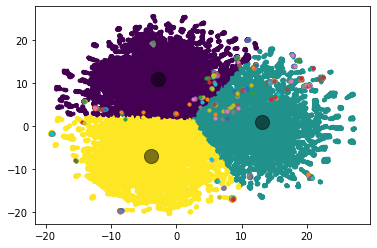

In [ ]:
plt.scatter(X_rna[:, 0], X_rna[:, 1], c=y_kmeans_rna, s=10, cmap='viridis')

centers_rna = kmeans.cluster_centers_
plt.scatter(centers_rna[:, 0], centers_rna[:, 1], c='black', s=200, alpha=0.5);
for i in range(len(zoonotic_seq_1)):
  plt.scatter(X_rna[i, 0], X_rna[i, 1], s=10)

In [ ]:
centers_rna

array([[-2.8577285, 10.807459 ],
       [13.083117 ,  0.8909497],
       [-3.8368783, -6.9821897]], dtype=float32)

In [ ]:
import numpy as np
dist=[]
for i in range(len(zoonotic_seq_1)):
  for j in range(len(centers_rna)):
    dist.append(np.linalg.norm(centers_rna[j] - X_rna[i]))
#print(dist)
shape = (len(zoonotic_seq_1),len(centers_rna))
dist_ = np.array(dist)
dist_.reshape(shape)


array([[21.385977, 16.310308, 31.911722],
       [26.260437, 12.378383, 15.694829],
       [17.0742  ,  9.336478, 24.88635 ],
       ...,
       [21.924343, 11.781608, 29.143442],
       [30.961336, 29.86755 , 13.50924 ],
       [24.960758, 13.712969, 31.687923]], dtype=float32)

In [ ]:
dist_df = pd.DataFrame(dist_.reshape(shape), columns = ['distAvian','distHuman','distSwine'])
dist_df

,distAvian,distHuman,distSwine
0,21.385977,16.310308,31.911722
1,26.260437,12.378383,15.694829
2,17.074200,9.336478,24.886351
3,30.932968,29.901043,13.498342
4,24.978008,13.569323,31.584562
...,...,...,...
471,8.282742,13.281159,10.707393
472,22.009897,15.501854,31.710836
473,21.924343,11.781608,29.143442
474,30.961336,29.867550,13.509240


In [ ]:
zoonotic_seq_1

,Gene,Accession_number,Virus_Name,Taxonomy,Detected_in,Database,Host
0,HA,GQ117067,A/ARIZONA/01/2009,643842,Human,GenBank,Swine
1,NP,GQ117063,A/ARIZONA/01/2009,643842,Human,GenBank,Swine
2,NA,GQ117064,A/ARIZONA/01/2009,643842,Human,GenBank,Swine
3,M,GQ117066,A/ARIZONA/01/2009,643842,Human,GenBank,Swine
4,NS,GQ117065,A/ARIZONA/01/2009,643842,Human,GenBank,Swine
...,...,...,...,...,...,...,...
471,PB1,GQ160546,A/TEXAS/23/2009,645249,Human,GenBank,Swine
472,HA,GQ160550,A/TEXAS/23/2009,645249,Human,GenBank,Swine
473,NA,GQ160547,A/TEXAS/23/2009,645249,Human,GenBank,Swine
474,M,GQ160549,A/TEXAS/23/2009,645249,Human,GenBank,Swine


In [ ]:
dist_H1N1_2009 = zoonotic_seq_1.merge(dist_df, left_index=True, right_index=True)
dist_H1N1_2009

,Gene,Accession_number,Virus_Name,Taxonomy,Detected_in,Database,Host,distAvian,distHuman,distSwine
0,HA,GQ117067,A/ARIZONA/01/2009,643842,Human,GenBank,Swine,21.385977,16.310308,31.911722
1,NP,GQ117063,A/ARIZONA/01/2009,643842,Human,GenBank,Swine,26.260437,12.378383,15.694829
2,NA,GQ117064,A/ARIZONA/01/2009,643842,Human,GenBank,Swine,17.074200,9.336478,24.886351
3,M,GQ117066,A/ARIZONA/01/2009,643842,Human,GenBank,Swine,30.932968,29.901043,13.498342
4,NS,GQ117065,A/ARIZONA/01/2009,643842,Human,GenBank,Swine,24.978008,13.569323,31.584562
...,...,...,...,...,...,...,...,...,...,...
471,PB1,GQ160546,A/TEXAS/23/2009,645249,Human,GenBank,Swine,8.282742,13.281159,10.707393
472,HA,GQ160550,A/TEXAS/23/2009,645249,Human,GenBank,Swine,22.009897,15.501854,31.710836
473,NA,GQ160547,A/TEXAS/23/2009,645249,Human,GenBank,Swine,21.924343,11.781608,29.143442
474,M,GQ160549,A/TEXAS/23/2009,645249,Human,GenBank,Swine,30.961336,29.867550,13.509240


In [ ]:
dist_H1N1_2009.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/kmeans_dist_euc/dist_H1N1_2009.xlsx')

## Re-Test Transmission_to_Human

### Transmission_to_Human & test_set

In [ ]:
test_set = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Train_Val_Test/test_df.xlsx')
test_set = test_set.rename(columns={'Segment': 'Gene'})
test_set = test_set.rename(columns={'Accession': 'Accession_number'})
test_set['Gene'].fillna('NA', inplace=True)
test_set['State']='Old'
test_set.head()

,Accession_number,Database,Gene,Host,Sequence,State
0,AY862710,NCBI,PB2,Avian,ATGAGAGAATAAAGGAACTAAGAGATTTGATGTCACAGTCCCGCAC...,Old
1,KX088388,NCBI,HA,Human,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Old
2,MH080081,NCBI,PB2,Human,TCAATTATATTCAGCATGGAAAGAATAAAAGAACTACGGAATCTAA...,Old
3,OP870882,NCBI,NS,Swine,GTGACAAAGACATAATGGACTCCAATACTGTGTCAAGCTTTCAGGT...,Old
4,OP775285,NCBI,HA,Human,AGCAAAAGCAGGGGATAATTCTATTAACCATGAAGACTATCATTGC...,Old


In [ ]:
zoonotic_seq_2 = pd.read_excel('/content/drive/MyDrive/Misclassified/Data/Zoonotic_Viruses/Transmission_to_Human.xlsx')
zoonotic_seq_2['Gene'].fillna('NA', inplace=True)

zoonotic_seq_2['State']='New'
zoonotic_seq_2 = zoonotic_seq_2.rename(columns={'Origin': 'Host'})

zoonotic_seq_2 = zoonotic_seq_2.drop('Virus_Name', axis=1)
zoonotic_seq_2 = zoonotic_seq_2.drop('Virus_type', axis=1)

zoonotic_seq_2 = zoonotic_seq_2.drop('Taxon', axis=1)
zoonotic_seq_2 = zoonotic_seq_2.drop('Detected_in', axis=1)
zoonotic_seq_2 = zoonotic_seq_2.drop('Reference', axis=1)

# Get the column names of df1
column_names = test_set.columns

# Reorder the columns of df2 to match the order of df1
zoonotic_seq_2 = zoonotic_seq_2.reindex(columns=column_names)
zoonotic_seq_2.head()

,Accession_number,Database,Gene,Host,Sequence,State
0,AJ293920,NCBI,PB2,Swine,AGCAAAAGCAGGTCAATTATATTCAATATGGAGAGAATAAAAGAAT...,New
1,AJ293921,NCBI,PB1,Swine,GAATGGATGTCAACCCGACTCTACTTTTCTTGAAAGTGCCAGCGCA...,New
2,AJ293922,NCBI,PA,Swine,AGCAAAAGCAGGTACTGATTCAAAATGGAAGACTTTGTGCGACAGT...,New
3,AJ293923,NCBI,_NA_,Swine,AGCAAAAGCAGGAGTGAAAATGAATCCAAATCAAAAGATAATAACA...,New
4,AJ293924,NCBI,NP,Swine,AGCAGGGTTAATAATCACTCACTGAGTGACATCAACATCATGGCGT...,New


In [ ]:
len(zoonotic_seq_2)

108

In [ ]:
df_concat = pd.concat([zoonotic_seq_2, test_set], ignore_index=True)
df_concat

,Accession_number,Database,Gene,Host,Sequence,State
0,AJ293920,NCBI,PB2,Swine,AGCAAAAGCAGGTCAATTATATTCAATATGGAGAGAATAAAAGAAT...,New
1,AJ293921,NCBI,PB1,Swine,GAATGGATGTCAACCCGACTCTACTTTTCTTGAAAGTGCCAGCGCA...,New
2,AJ293922,NCBI,PA,Swine,AGCAAAAGCAGGTACTGATTCAAAATGGAAGACTTTGTGCGACAGT...,New
3,AJ293923,NCBI,_NA_,Swine,AGCAAAAGCAGGAGTGAAAATGAATCCAAATCAAAAGATAATAACA...,New
4,AJ293924,NCBI,NP,Swine,AGCAGGGTTAATAATCACTCACTGAGTGACATCAACATCATGGCGT...,New
...,...,...,...,...,...,...
52553,JQ522629,FLU DB,HA,Swine,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Old
52554,MG520684,NCBI,_NA_,Swine,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Old
52555,MK367364,NCBI,PB2,Swine,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Old
52556,MW127168,NCBI,HA,Swine,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Old


### Open Reading Frame

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X_test, y_test, idxStart_test = codonStart(df_concat.Sequence, df_concat.Host)

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq_test = toSeq(X_test, idxStart_test)

### Length

In [ ]:
def length(data):
  length = []
  for i in range(len(data)):
    length.append(len(data[i]))

  min = int(np.min(length))
  max = int(np.max(length))
  median = int(np.median(length))

  return (min, max, median)

In [ ]:
min_length, max_length, median_length = length(seq_test)

print("Taille Minimale des séquences : ", min_length)
print("Taille Maximale des séquences : ", max_length)

Taille Minimale des séquences :  3
Taille Maximale des séquences :  2301


### Labels

In [ ]:
le = LabelEncoder()

test_labels = le.fit_transform(y_test)
test_labels = to_categorical(test_labels)

In [ ]:
print("Test: ", test_labels.shape)

Test:  (52556, 3)


### RNA

In [ ]:
# Define a dictionary mapping each codon to a unique index
codon_index = {
    'TTT': 1, 'TTC': 2, 'TTA': 3, 'TTG': 4, 'CTT': 5, 'CTC': 6, 'CTA': 7, 'CTG': 8, 'ATT': 9, 'ATC': 10, 'ATA': 11, 'ATG': 12, 'GTT': 13, 'GTC': 14, 'GTA': 15, 'GTG': 16, 'TCT': 17, 'TCC': 18, 'TCA': 19, 'TCG': 20, 'CCT': 21, 'CCC': 22, 'CCA': 23, 'CCG': 24, 'ACT': 25, 'ACC': 26, 'ACA': 27, 'ACG': 28, 'GCT': 29, 'GCC': 30, 'GCA': 31, 'GCG': 32, 'TAT': 33, 'TAC': 34, 'CAT': 35, 'CAC': 36, 'CAA': 37, 'CAG': 38, 'AAT': 39, 'AAC': 40, 'AAA': 41, 'AAG': 42, 'GAT': 43, 'GAC': 44, 'GAA': 45, 'GAG': 46, 'TGT': 47, 'TGC': 48, 'TGG': 49, 'CGT': 50, 'CGC': 51, 'CGA': 52, 'CGG': 53, 'AGT': 54, 'AGC': 55, 'AGA': 56, 'AGG': 57, 'GGT': 58, 'GGC': 59, 'GGA': 60, 'GGG': 61
}

# Define a function that encodes RNA sequences using the codon index
def encode_sequences_rna(sequences, codon_index):
    all_codon_indices = []
    for sequence in sequences:
        codon_indices = []
        for i in range(0, len(sequence), 3):
            codon = sequence[i:i+3]
            if len(codon) == 3:
                if set(codon).issubset(set('ATCG')):
                    codon_indices.append(codon_index[codon])
                else:
                    raise ValueError('Invalid nucleotide character in sequence: {}'.format(codon))
        all_codon_indices.append(codon_indices)
    return all_codon_indices


In [ ]:
test_sequences_rna = encode_sequences_rna(seq_test, codon_index)
print(test_sequences_rna[0])

[12, 46, 56, 11, 41, 45, 3, 56, 43, 7, 12, 19, 38, 17, 51, 25, 51, 46, 11, 8, 27, 41, 26, 25, 16, 44, 35, 12, 31, 11, 10, 41, 41, 34, 27, 19, 60, 56, 37, 46, 42, 40, 22, 29, 6, 56, 12, 41, 49, 12, 12, 31, 12, 41, 33, 24, 10, 27, 31, 40, 42, 56, 11, 12, 46, 12, 14, 21, 45, 56, 39, 45, 37, 60, 37, 27, 5, 49, 54, 42, 27, 39, 43, 29, 60, 19, 43, 57, 16, 12, 15, 19, 22, 7, 30, 15, 25, 49, 49, 39, 57, 39, 60, 24, 28, 27, 43, 27, 14, 35, 34, 24, 41, 14, 34, 41, 27, 33, 1, 45, 42, 13, 45, 57, 3, 41, 35, 61, 26, 1, 58, 21, 14, 35, 1, 52, 39, 37, 13, 41, 11, 51, 52, 56, 13, 44, 11, 40, 23, 59, 35, 31, 44, 6, 54, 30, 42, 45, 32, 37, 43, 14, 10, 12, 46, 14, 13, 2, 23, 39, 45, 16, 60, 30, 56, 11, 3, 27, 19, 46, 20, 37, 3, 27, 11, 27, 41, 46, 42, 41, 46, 46, 6, 38, 43, 47, 42, 9, 30, 21, 3, 12, 16, 31, 34, 12, 4, 45, 56, 45, 8, 13, 51, 41, 26, 56, 2, 7, 24, 15, 31, 59, 60, 27, 55, 54, 16, 34, 9, 45, 15, 3, 36, 8, 25, 37, 60, 26, 48, 49, 45, 38, 12, 34, 25, 23, 59, 61, 46, 16, 56, 40, 43, 43, 13, 44,

In [ ]:
# Sequences Length
min_length_rna, max_length_rna, median_length_rna = length(test_sequences_rna)
print("Taille Maximale des séquences : ", max_length_rna)

Taille Maximale des séquences :  767


In [ ]:
max_length_rna=770
test_padded_arn = pad_sequences(test_sequences_rna, maxlen=(max_length_rna), padding="post", truncating="post")

In [ ]:
print("Test: ", test_padded_arn.shape)

Test:  (52556, 770)


In [ ]:
model_arn_lstm = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

In [ ]:
zoonotic_lstm = model_arn_lstm.predict(test_padded_arn) 

1643/1643 [==============================] - 27s 16ms/step


In [ ]:
def getResultsARN(y_test, X_test, predictions):

  tiers = []
  pred_class = []
  pred_max = []
  pred_avian = []
  pred_human = []
  pred_swine = []
  seq_arn = []
  host = []

  for i in range(len(y_test)):
    host.append(y_test[i])
  i=0
  for i in range(len(X_test)):
    seq_arn.append(X_test[i])  
  i=0 
  for i in range(len(predictions)):
    pred = predictions[i]

    av = pred[0]
    hu = pred[1]
    sw = pred[2]
    pred_avian.append(av.round(3))
    pred_human.append(hu.round(3))
    pred_swine.append(sw.round(3))

    max = pred.max()
    pred_max.append(max.round(3))

    if (max == av):
      classe = 'Avian'
    elif (max == hu):
      classe = 'Human'
    elif (max == sw):
      classe = 'Swine'
    pred_class.append(classe)

    if (max >=0.95 and max <=1):
      tier = '[95-100]'
    elif (max >=0.90 and max <0.95):
      tier = '[90-95]'
    elif (max >=0.85 and max <0.90):
      tier = '[85-90]'
    elif (max >=0.80 and max <0.85):
      tier = '[80-85]'
    elif (max >=0.75 and max <0.80):
      tier = '[75-80]'
    elif (max >=0.70 and max <0.75):
      tier = '[70-75]'
    elif (max >=0.65 and max <0.70):
      tier = '[65-70]'
    elif (max >=0.60 and max <0.65):
      tier = '[60-65]'
    elif (max >=0.55 and max <0.60):
      tier = '[55-60]'
    elif (max >=0.50 and max <0.55):
      tier = '[50-55]'      
    elif (max >=0.45 and max <0.50):
      tier = '[45-50]'
    elif (max >=0.40 and max <0.45):
      tier = '[40-45]'   
    elif (max >=0.35 and max <0.40):
      tier = '[35-40]'  
    elif (max >=0.30 and max <0.35):
      tier = '[30-35]' 

    tiers.append(tier)

  return(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host)

In [ ]:
def toDataframesARN(tiers, pred_class, pred_max, pred_avian, pred_human, pred_swine, seq_arn, host):

  df = pd.DataFrame(columns=['tiers', 'pred_class', 'pred_max', 'pred_avian', 'pred_human', 'pred_swine', 'seq_arn', 'host'])
  df['tiers'] = tiers
  df['pred_class'] = pred_class
  df['pred_max'] = pred_max
  df['pred_avian'] = pred_avian
  df['pred_human'] = pred_human
  df['pred_swine'] = pred_swine
  df['seq_arn'] = seq_arn
  df['host'] = host

  return(df)

In [ ]:
tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn = getResultsARN(y_test, X_test, zoonotic_lstm)

In [ ]:
df_zoonotic_arn_lstm = toDataframesARN(tiers_lstm_arn, pred_class_lstm_arn, pred_max_lstm_arn, pred_avian_lstm_arn, pred_human_lstm_arn, pred_swine_lstm_arn, seq_arn_lstm_arn, host_lstm_arn)

In [ ]:
df_zoonotic_arn_lstm

,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAAAAGCAGGTCAATTATATTCAATATGGAGAGAATAAAAGAAT...,Swine
1,[95-100],Swine,1.0,0.0,0.0,1.0,GAATGGATGTCAACCCGACTCTACTTTTCTTGAAAGTGCCAGCGCA...,Swine
2,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAAAAGCAGGTACTGATTCAAAATGGAAGACTTTGTGCGACAGT...,Swine
3,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAAAAGCAGGAGTGAAAATGAATCCAAATCAAAAGATAATAACA...,Swine
4,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAGGGTTAATAATCACTCACTGAGTGACATCAACATCATGGCGT...,Swine
...,...,...,...,...,...,...,...,...
52551,[95-100],Swine,1.0,0.0,0.0,1.0,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Swine
52552,[95-100],Swine,1.0,0.0,0.0,1.0,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Swine
52553,[95-100],Swine,1.0,0.0,0.0,1.0,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Swine
52554,[95-100],Swine,1.0,0.0,0.0,1.0,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Swine


In [ ]:
df=zoonotic_seq_2
df= df.drop("Host", axis=1)
df= df.drop("Sequence", axis=1)
df.head()

,Accession_number,Database,Gene,State
0,AJ293920,NCBI,PB2,New
1,AJ293921,NCBI,PB1,New
2,AJ293922,NCBI,PA,New
3,AJ293923,NCBI,_NA_,New
4,AJ293924,NCBI,NP,New


In [ ]:
result = pd.concat([df, df_zoonotic_arn_lstm], axis=1).reindex(df_zoonotic_arn_lstm.index)
result

,Accession_number,Database,Gene,State,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host
0,AJ293920,NCBI,PB2,New,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAAAAGCAGGTCAATTATATTCAATATGGAGAGAATAAAAGAAT...,Swine
1,AJ293921,NCBI,PB1,New,[95-100],Swine,1.0,0.0,0.0,1.0,GAATGGATGTCAACCCGACTCTACTTTTCTTGAAAGTGCCAGCGCA...,Swine
2,AJ293922,NCBI,PA,New,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAAAAGCAGGTACTGATTCAAAATGGAAGACTTTGTGCGACAGT...,Swine
3,AJ293923,NCBI,_NA_,New,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAAAAGCAGGAGTGAAAATGAATCCAAATCAAAAGATAATAACA...,Swine
4,AJ293924,NCBI,NP,New,[95-100],Swine,1.0,0.0,0.0,1.0,AGCAGGGTTAATAATCACTCACTGAGTGACATCAACATCATGGCGT...,Swine
...,...,...,...,...,...,...,...,...,...,...,...,...
52551,NaN,NaN,NaN,NaN,[95-100],Swine,1.0,0.0,0.0,1.0,ATGGAAGCAAAACTGTTTGTATTATTCTGTACATTTACTGCGTTGA...,Swine
52552,NaN,NaN,NaN,NaN,[95-100],Swine,1.0,0.0,0.0,1.0,ATGAATCCAAATCAAAAGATAATAACGATTGGCTCTATTTCTCTTA...,Swine
52553,NaN,NaN,NaN,NaN,[95-100],Swine,1.0,0.0,0.0,1.0,AGCGAAAGCAGGTCAAATATATTCAATATGGAGAGAATAAAAGAAT...,Swine
52554,NaN,NaN,NaN,NaN,[95-100],Swine,1.0,0.0,0.0,1.0,ATGAAGGCAATACTAGTAGTCCTGCTATATACATTTACAACAGCAA...,Swine


In [ ]:
result.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_zoonotic_2_test_arn_lstm.xlsx')

In [ ]:
len(result)

52556

### Latent Space

In [ ]:
df_zoonotic_test_arn_lstm = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/df_zoonotic_2_test_arn_lstm.xlsx')

In [ ]:
latent_space_model = tf.keras.models.Model(inputs=model_arn_lstm.input, outputs=model_arn_lstm.layers[-1].output)

In [ ]:
latent_space = latent_space_model.predict(test_padded_arn, batch_size=32)

1643/1643 [==============================] - 26s 15ms/step


In [ ]:
print("Taille de l'espace latent avant réduction : ", latent_space.shape)

Taille de l'espace latent avant réduction :  (52556, 3)


In [ ]:
mapper_rna = umap.UMAP(n_neighbors=15, min_dist=0.8, n_components=2, metric='canberra', random_state=42).fit(latent_space)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result)),'tiers':result['tiers'], 'host':result['host'], 'pred_class':result['pred_class']})
p_rna = umap.plot.interactive(mapper_rna, labels=result['pred_class'], hover_data=hover_data_rna,color_key_cmap='prism', point_size=3)
output_notebook()
show(p_rna)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result[0:len(zoonotic_seq_2)])),'tiers':result[0:len(zoonotic_seq_2)]['tiers'],'gene':result[0:len(zoonotic_seq_2)]['Gene'], 'host':result[0:len(zoonotic_seq_2)]['host'], 'pred_class':result[0:len(zoonotic_seq_2)]['pred_class']})
p_rna = umap.plot.interactive(mapper_rna,  labels=result[0:len(zoonotic_seq_2)]['State'], hover_data=hover_data_rna,color_key_cmap='prism', point_size=5, theme='fire')

output_notebook()
show(p_rna)

In [ ]:
hover_data_rna = pd.DataFrame({'index':np.arange(len(result)),'tiers':result['tiers'], 'host':result['host'], 'pred_class':result['pred_class']})
p_rna = umap.plot.interactive(mapper_rna, labels=result['tiers'], hover_data=hover_data_rna,color_key_cmap='ocean', point_size=2.5)
output_notebook()
show(p_rna)

Kmeans

### K-means

In [ ]:
X_rna=mapper_rna.embedding_
X_rna

array([[ 6.584763 , 23.39069  ],
       [-3.7313159, 21.37003  ],
       [-7.6730776, 15.304723 ],
       ...,
       [-6.537494 , 16.762873 ],
       [ 7.1102858, 21.670702 ],
       [ 1.891075 , 21.904848 ]], dtype=float32)

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3)
kmeans.fit(X_rna)
y_kmeans_rna = kmeans.predict(X_rna)

In [ ]:
len(zoonotic_seq_2)

108

In [ ]:
for i in range(len(zoonotic_seq_2)):
  print(y_kmeans_rna[i])

In [ ]:
y_kmeans_rna[0], y_kmeans_rna[1], y_kmeans_rna[2], y_kmeans_rna[3], y_kmeans_rna[4]

(2, 2, 2, 2, 2)

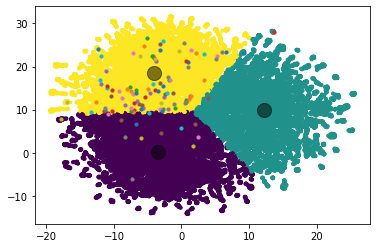

In [ ]:
plt.scatter(X_rna[:, 0], X_rna[:, 1], c=y_kmeans_rna, s=10, cmap='viridis')

centers_rna = kmeans.cluster_centers_
plt.scatter(centers_rna[:, 0], centers_rna[:, 1], c='black', s=200, alpha=0.5);
for i in range(len(zoonotic_seq_2)):
  plt.scatter(X_rna[i, 0], X_rna[i, 1], s=10)

In [ ]:
centers_rna

array([[-3.4044342 ,  0.22218609],
       [12.251082  ,  9.974572  ],
       [-3.9936733 , 18.486803  ]], dtype=float32)

In [ ]:
import numpy as np
dist=[]
for i in range(len(zoonotic_seq_2)):
  for j in range(len(centers_rna)):
    dist.append(np.linalg.norm(centers_rna[j] - X_rna[i]))
#print(dist)
shape = (len(zoonotic_seq_2),len(centers_rna))
dist_ = np.array(dist)
dist_.reshape(shape)


In [ ]:
dist_df = pd.DataFrame(dist_.reshape(shape), columns = ['distAvian','distHuman','distSwine'])
dist_df

,distAvian,distHuman,distSwine
0,25.230211,14.563633,11.659821
1,21.150368,19.628895,2.895138
2,15.674955,20.624805,4.864530
3,21.693624,20.243235,3.419503
4,21.134123,19.632784,2.877237
...,...,...,...
103,11.928024,19.307175,7.510087
104,11.858462,20.698641,8.728622
105,9.300385,21.293934,11.851054
106,10.843579,19.717733,8.913215


In [ ]:
zoonotic_seq_2

,Gene,Virus_Name,Virus_type,Accession_number,Database,Origin,Detected_in,Taxon
0,PB2,A/Hong Kong/1774/1999,H3N2,AJ293920,NCBI,Swine,Human,NaN
1,PB1,A/Hong Kong/1774/1999,H3N2,AJ293921,NCBI,Swine,Human,NaN
2,PA,A/Hong Kong/1774/1999,H3N2,AJ293922,NCBI,Swine,Human,NaN
3,NA,A/Hong Kong/1774/1999,H3N2,AJ293923,NCBI,Swine,Human,NaN
4,NP,A/Hong Kong/1774/1999,H3N2,AJ293924,NCBI,Swine,Human,NaN
...,...,...,...,...,...,...,...,...
103,HA,A/chicken/Lebanon/157/2016,H5N1,KX644141,GenBank,Avian,Human,NaN
104,NP,A/chicken/Lebanon/157/2016,H5N1,KX644142,GenBank,Avian,Human,NaN
105,NA,A/chicken/Lebanon/157/2016,H5N1,KX644143,GenBank,Avian,Human,NaN
106,M,A/chicken/Lebanon/157/2016,H5N1,KX644144,GenBank,Avian,Human,NaN


In [ ]:
dist_Transmission_to_Human= zoonotic_seq_2.merge(dist_df, left_index=True, right_index=True)
dist_Transmission_to_Human

,Gene,Virus_Name,Virus_type,Accession_number,Database,Origin,Detected_in,Taxon,distAvian,distHuman,distSwine
0,PB2,A/Hong Kong/1774/1999,H3N2,AJ293920,NCBI,Swine,Human,NaN,25.230211,14.563633,11.659821
1,PB1,A/Hong Kong/1774/1999,H3N2,AJ293921,NCBI,Swine,Human,NaN,21.150368,19.628895,2.895138
2,PA,A/Hong Kong/1774/1999,H3N2,AJ293922,NCBI,Swine,Human,NaN,15.674955,20.624805,4.864530
3,NA,A/Hong Kong/1774/1999,H3N2,AJ293923,NCBI,Swine,Human,NaN,21.693624,20.243235,3.419503
4,NP,A/Hong Kong/1774/1999,H3N2,AJ293924,NCBI,Swine,Human,NaN,21.134123,19.632784,2.877237
...,...,...,...,...,...,...,...,...,...,...,...
103,HA,A/chicken/Lebanon/157/2016,H5N1,KX644141,GenBank,Avian,Human,NaN,11.928024,19.307175,7.510087
104,NP,A/chicken/Lebanon/157/2016,H5N1,KX644142,GenBank,Avian,Human,NaN,11.858462,20.698641,8.728622
105,NA,A/chicken/Lebanon/157/2016,H5N1,KX644143,GenBank,Avian,Human,NaN,9.300385,21.293934,11.851054
106,M,A/chicken/Lebanon/157/2016,H5N1,KX644144,GenBank,Avian,Human,NaN,10.843579,19.717733,8.913215


In [ ]:
dist_Transmission_to_Human.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/kmeans_dist_euc/dist_Transmission_to_Human.xlsx)

## Tests

### Globally

#### Dataframes: Classes

In [ ]:
def codonStart(X,y):
  seq = X
  host = y.to_list()

  N = []
  X_ = []
  y_ = []

  numero = 0
  numbis = 0
  for i in range(len(seq)):
    seq_ = seq[i]
    host_ = host[i]

    numero = 0
    numbis = 0
    while numero < len(seq_)-2:
        if seq_[numero:numero+3] == 'ATG':
            numbis = numero
            N.append(numbis)
            X_.append(seq_)
            y_.append(host_)

            break
        numero += 1
  return (X_, y_, N)

In [ ]:
X, y, idxStart = codonStart(df_arn_lstm.seq_arn, df_arn_lstm['class'])

In [ ]:
nonStop = ['GCT', 'GCC', 'GCA', 'GCG', 'CGT', 'CGC', 'CGA', 'CGG', 'AGA', 'AGG', 'AAT', 'AAC', 'GAT', 'GAC', 'TGT', 'TGC', 'CAA', 'CAG', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG', 'CAT', 'CAC', 'ATT', 'ATC', 'ATA', 'TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG', 'AAA', 'AAG', 'ATG', 'TTT', 'TTC', 'CCT', 'CCC', 'CCA', 'CCG', 'TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC', 'ACT', 'ACC', 'ACA', 'ACG', 'TGG', 'TAT', 'TAC', 'GTT', 'GTC', 'GTA', 'GTG']
stop = ['TAG', 'TGA', 'TAA']

In [ ]:
def toSeq(X, N):
  seq_ = []
  tmp = []
  for i in range(len(X)):
    seq = X[i]
    numbis = N[i]
    while numbis < len(seq)-2:
      if seq[numbis:numbis+3] in nonStop:
        tmp += seq[numbis:numbis+3]
      elif seq[numbis:numbis+3] in stop:
        break

      numbis += 3
    str = ""
    seq_.append(str.join(tmp))
    tmp=[]

  return(seq_)

In [ ]:
seq = toSeq(X, idxStart)

In [ ]:
seq[0]

'ATGAGAGAA'

In [ ]:
df_arn_lstm.seq_arn=seq
df_arn_lstm.head()

,Unnamed: 0,Database,Segment,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host,class
0,0,NCBI,PB2,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAA,Avian,Avian
1,1,NCBI,HA,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human,Human
2,2,NCBI,PB2,[95-100],Human,1.000,0.000,1.000,0.000,ATGGAAAGAATAAAAGAACTACGGAATCTAATGTCGCAGTCTCGCA...,Human,Human
3,3,NCBI,NS,[95-100],Swine,1.000,0.000,0.000,1.000,ATGGACTCCAATACTGTGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,Swine,Swine
4,4,NCBI,HA,[95-100],Human,1.000,0.000,1.000,0.000,ATGAAGACTATCATTGCTTTGAGCAACATTCTATGTCTTGTTTTCG...,Human,Human


In [ ]:
def get_class(row):
    if row['pred_class'] == row['host']:
        return row['host']
    else:
        return f"{row['host']}_{row['pred_class']}"

# Apply the function to create the new column
df_arn_lstm['class'] = df_arn_lstm.apply(lambda row: get_class(row), axis=1)

In [ ]:
df_arn_lstm

,Unnamed: 0,Database,Segment,tiers,pred_class,pred_max,pred_avian,pred_human,pred_swine,seq_arn,host,class
0,0,NCBI,PB2,[95-100],Avian,0.984,0.984,0.004,0.012,ATGAGAGAA,Avian,Avian
1,1,NCBI,HA,[95-100],Human,0.973,0.001,0.973,0.026,ATGAAGGCAATACTAGTAGTTCTGCTATATACATTTACAACCGCAA...,Human,Human
2,2,NCBI,PB2,[95-100],Human,1.000,0.000,1.000,0.000,ATGGAAAGAATAAAAGAACTACGGAATCTAATGTCGCAGTCTCGCA...,Human,Human
3,3,NCBI,NS,[95-100],Swine,1.000,0.000,0.000,1.000,ATGGACTCCAATACTGTGTCAAGCTTTCAGGTAGACTGTTTCCTTT...,Swine,Swine
4,4,NCBI,HA,[95-100],Human,1.000,0.000,1.000,0.000,ATGAAGACTATCATTGCTTTGAGCAACATTCTATGTCTTGTTTTCG...,Human,Human
...,...,...,...,...,...,...,...,...,...,...,...,...
598409,598409,FLU DB,PB2,[95-100],Swine,0.999,0.001,0.000,0.999,ATGATAAGCAAGTGCAGGACGAAAGAAGGAAGACGGAAGACAAATC...,Swine,Swine
598410,598410,FLU DB,PB2,[90-95],Avian,0.938,0.938,0.024,0.037,ATGCTA,Swine,Swine_Avian
598411,598411,FLU DB,PB2,[95-100],Avian,0.979,0.979,0.011,0.010,ATGGAACAGGGACAGGGTACACCATGGACACGGTCAACAGGACACA...,Swine,Swine_Avian
598412,598412,FLU DB,PB2,[90-95],Avian,0.938,0.938,0.024,0.037,ATGCTA,Swine,Swine_Avian


In [ ]:
classes = ['Avian', 'Avian_Human', 'Avian_Swine', 'Human', 'Human_Avian', 'Human_Swine', 'Swine', 'Swine_Avian', 'Swine_Human']

for classe in classes:
  df = df_arn_lstm[df_arn_lstm['class'] == classe]
  df.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/' + classe + '_df.xlsx')

#### Frequencies 

##### Globally

###### Functions

In [ ]:
def toText_ARN(seq_arn):
  arn = []
  for i in range(len(seq_arn)):
    seq_ = seq_arn[i]
    arn.append(' '.join([seq_[i:i+3] for i in range(0, len(seq_), 3)]))
  return(pd.Series(arn))

In [ ]:
def counterCodon(text):
    count = Counter()
    for i in text.values:
        for word in i.split():
            count[word] += 1
            
    return count

In [ ]:
def getFreqARN(arn_seq):
  seq = toText_ARN(arn_seq)
  counter = counterCodon(seq)

  column_names = ["Codon", "Nbr", "Frequence"]
  df = pd.DataFrame(columns = column_names)

  df["Codon"] = counter.keys()
  df["Nbr"] = counter.values()

  nbr_apparition = df["Nbr"]
  nbr_total = df["Nbr"].sum()

  df["Frequence"] = nbr_apparition/nbr_total

  df = df.sort_values('Codon').reset_index()
  df = df.drop(columns=["index"])
  #print(df.Frequence.sum())
  return(df)

###### Avian

In [ ]:
for classe in classes:
  df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/' + classe + '_df.xlsx')
  arn = getFreqARN(list(avian_df.seq_arn))
  arn['Class'] = classe

In [ ]:
avian_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/avian_df.xlsx')
arn_av = getFreqARN(list(avian_df.seq_arn))
arn_av['Class'] = "Avian"
arn_av

,Codon,Nbr,Frequence,Class
0,AAA,2977861,0.031674,Avian
1,AAC,2329690,0.024780,Avian
2,AAG,2313140,0.024604,Avian
3,AAT,2980061,0.031698,Avian
4,ACA,2803878,0.029824,Avian
...,...,...,...,...
56,TGT,750972,0.007988,Avian
57,TTA,657755,0.006996,Avian
58,TTC,2053719,0.021845,Avian
59,TTG,1198172,0.012744,Avian


In [ ]:
avian_human_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/avian_human_df.xlsx')
arn_av_hu = getFreqARN(list(avian_human_df.seq_arn))
arn_av_hu['Class'] = "Avian_Human"
arn_av_hu.head()

,Codon,Nbr,Frequence,Class
0,AAA,3257,0.034276,Avian_Human
1,AAC,2211,0.023268,Avian_Human
2,AAG,2468,0.025973,Avian_Human
3,AAT,2986,0.031424,Avian_Human
4,ACA,2850,0.029993,Avian_Human


In [ ]:
avian_swine_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/avian_swine_df.xlsx')
arn_av_sw = getFreqARN(list(avian_swine_df.seq_arn))
arn_av_sw['Class'] = "Avian_Swine"
arn_av_sw.head()

,Codon,Nbr,Frequence,Class
0,AAA,10641,0.033362,Avian_Swine
1,AAC,7701,0.024145,Avian_Swine
2,AAG,7706,0.024160,Avian_Swine
3,AAT,10344,0.032431,Avian_Swine
4,ACA,9272,0.029070,Avian_Swine


###### Human

In [ ]:
human_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/human_df.xlsx')
arn_hu = getFreqARN(list(human_df.seq_arn))
arn_hu['Class'] = "Human"
arn_hu

,Codon,Nbr,Frequence,Class
0,AAA,6752445,0.038468,Human
1,AAC,4313292,0.024572,Human
2,AAG,3990159,0.022731,Human
3,AAT,5901007,0.033617,Human
4,ACA,5144787,0.029309,Human
...,...,...,...,...
56,TGT,1581190,0.009008,Human
57,TTA,1550400,0.008832,Human
58,TTC,3593694,0.020473,Human
59,TTG,2522194,0.014369,Human


In [ ]:
human_avian_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/human_avian_df.xlsx')
arn_hu_av = getFreqARN(list(human_avian_df.seq_arn))
arn_hu_av['Class'] = "Human_Avian"
arn_hu_av.head()

,Codon,Nbr,Frequence,Class
0,AAA,58916,0.032800,Human_Avian
1,AAC,45455,0.025306,Human_Avian
2,AAG,43877,0.024427,Human_Avian
3,AAT,55634,0.030973,Human_Avian
4,ACA,50591,0.028165,Human_Avian


In [ ]:
human_swine_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/human_swine_df.xlsx')
arn_hu_sw = getFreqARN(list(human_swine_df.seq_arn))
arn_hu_sw['Class'] = "Human_Swine"
arn_hu_sw.head()

,Codon,Nbr,Frequence,Class
0,AAA,114930,0.028816,Human_Swine
1,AAC,91247,0.022878,Human_Swine
2,AAG,116887,0.029307,Human_Swine
3,AAT,119639,0.029997,Human_Swine
4,ACA,99482,0.024943,Human_Swine


###### Swine

In [ ]:
swine_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/swine_df.xlsx')
arn_sw = getFreqARN(list(swine_df.seq_arn))
arn_sw['Class'] = "Swine"
arn_sw.head()

,Codon,Nbr,Frequence,Class
0,AAA,291006,0.035948,Swine
1,AAC,201609,0.024905,Swine
2,AAG,186726,0.023066,Swine
3,AAT,276655,0.034175,Swine
4,ACA,236204,0.029178,Swine


In [ ]:
swine_avian_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/swine_avian_df.xlsx')
arn_sw_av = getFreqARN(list(swine_avian_df.seq_arn))
arn_sw_av['Class'] = "Swine_Avian"
arn_sw_av.head()

,Codon,Nbr,Frequence,Class
0,AAA,3171,0.033993,Swine_Avian
1,AAC,2236,0.023970,Swine_Avian
2,AAG,2348,0.025171,Swine_Avian
3,AAT,2790,0.029909,Swine_Avian
4,ACA,2788,0.029888,Swine_Avian


In [ ]:
swine_human_df = pd.read_excel('/content/drive/MyDrive/Misclassified/Notebooks/well_mis_df/swine_human_df.xlsx')
arn_sw_hu = getFreqARN(list(swine_human_df.seq_arn))
arn_sw_hu['Class'] = "Swine_Human"
arn_sw_hu.head()

,Codon,Nbr,Frequence,Class
0,AAA,20714,0.036154,Swine_Human
1,AAC,14462,0.025242,Swine_Human
2,AAG,15313,0.026727,Swine_Human
3,AAT,20896,0.036472,Swine_Human
4,ACA,18490,0.032272,Swine_Human


##### Position

###### Functions

In [ ]:
def paddingARN(data):
  seq_padded_arn = []

  seq = data
  max = 2310
  
  for i in range(len(seq)):
    x = seq[i].ljust(max, 'X')
    seq_padded_arn.append(x[0:int(max)])

  return(seq_padded_arn)

In [ ]:
def toText_ARN(seq_arn):
  arn = []
  seq = seq_arn
  for i in range(len(seq)):
    seq_ = seq[i]
    arn.append(' '.join([seq_[i:i+3] for i in range(0, len(seq_), 3)]))
  return(arn)

In [ ]:
def convert(data):
  li = []
  for i in range(len(data)):
    string = data[i]
    li.append(list(string.split(" ")))
  return(li)

In [ ]:
def indexARN(seq_arn_padded):
  indexARN = {'AAA': [], 'AAC': [], 'AAG': [], 'AAT': [], 'ACA': [], 'ACC': [], 'ACG': [], 'ACT': [], 'AGA': [], 'AGC': [], 'AGG': [], 'AGT': [], 'ATA': [], 'ATC': [], 'ATG': [], 'ATT': [], 'CAA': [], 'CAC': [], 'CAG': [], 'CAT': [], 'CCA': [], 'CCC': [], 'CCG': [], 'CCT': [], 'CGA': [], 'CGC': [], 'CGG': [], 'CGT': [], 'CTA': [], 'CTC': [], 'CTG': [], 'CTT': [], 'GAA': [], 'GAC': [], 'GAG': [], 'GAT': [], 'GCA': [], 'GCC': [], 'GCG': [], 'GCT': [], 'GGA': [], 'GGC': [], 'GGG': [], 'GGT': [], 'GTA': [], 'GTC': [], 'GTG': [], 'GTT': [], 'TAC': [], 'TAT': [], 'TCA': [], 'TCC': [], 'TCG': [], 'TCT': [], 'TGC': [], 'TGG': [], 'TGT': [], 'TTA': [], 'TTC': [], 'TTG': [], 'TTT': []}
  codon=['TTT', 'TTC', 'TTA', 'TTG', 'TCT', 'TCC', 'TCA', 'TCG', 'TAT', 'TAC', 'TGT', 'TGC', 'TGG', 'CTT', 'CTC', 'CTA', 'CTG', 'CCT', 'CCC', 'CCA', 'CCG', 'CAT', 'CAC', 'CAA', 'CAG', 'CGT', 'CGC', 'CGA', 'CGG', 'ATT', 'ATC', 'ATA', 'ATG', 'ACT', 'ACC', 'ACA', 'ACG', 'AAT', 'AAC', 'AAA', 'AAG', 'AGT', 'AGC', 'AGA', 'AGG', 'GTT', 'GTC', 'GTA', 'GTG', 'GCT', 'GCC', 'GCA', 'GCG', 'GAT', 'GAC', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG']
  for i in range(len(seq_arn_padded)): 
    seq=seq_arn_padded[i]
    for j in range(len(seq)):
      if (seq[j] in codon):
        indexARN[seq[j]].append(j)
  return(indexARN)

In [ ]:
def df_indexARN(data):
  codon = list(data.keys())
  indexes = list(data.values())

  column_names = ["Codon", "Positions"]
  dfARN = pd.DataFrame(columns = column_names)
  dfARN["Codon"] = codon
  dfARN["Positions"] = indexes

  return(dfARN)

In [ ]:
def df_count_arn(data):
  data_arn=[]
  count_arn=[]
  idx_arn=[]
  cnt_arn=[]

  for i in range(len(data.Codon)):
    data_arn.append(sorted(data.Positions[i]))
  i=0
  for i in range(len(data_arn)):
    count_arn.append(Counter(data_arn[i]))
  i=0
  for i in range(len(count_arn)):
    idx_arn.append(list(count_arn[i].keys()))
    cnt_arn.append(list(count_arn[i].values()))

  return(idx_arn, cnt_arn)


In [ ]:
codons=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

In [ ]:
def countARN(idx_arn):
  codon = []
  for i in range(len(idx_arn)):
    for j in range(len(idx_arn[i])):
      codon.append(codons[i])
  count=[]
  count.append(Counter(codon))
  c = list(count[0].values())
  return(c)

In [ ]:
codons_names = ['AAA', 'AAC','AAG','AAT','ACA','ACC','ACG','ACT','AGA','AGC','AGG','AGT','ATA','ATC','ATG','ATT','CAA','CAC','CAG','CAT','CCA','CCC','CCG','CCT','CGA','CGC','CGG','CGT','CTA','CTC','CTG','CTT','GAA','GAC','GAG','GAT','GCA','GCC','GCG','GCT','GGA','GGC','TTG','TTT','GGG','GGT','GTA','GTC','GTG','GTT','TAC','TAT','TCA','TCC','TCG','TCT','TGC','TGG','TGT','TTA','TTC']

def codon(c):
  codons = []
  for i in range(len(c)):
    list_codon = [codons_names[i]] * c[i]
    codons.append(list_codon)
  return(codons)

In [ ]:
def codontoidx(codon):
  c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  nbr = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]
  
  for i in range(len(c)):
    if codon == c[i]:
      idx = nbr[i]
      
  return(idx)

In [ ]:
def df_codon_indices_count_ARN(codon, idx_arn, cnt_arn, i):
  column_names = ["Codon", "Position", "Nbr"]
  dfARN = pd.DataFrame(columns = column_names)

  i = codontoidx(i)

  dfARN["Codon"] = codon[i]
  dfARN["Position"] = idx_arn[i]
  dfARN["Nbr"] = cnt_arn[i]
  dfARN['Frequence'] = dfARN['Nbr']/dfARN['Nbr'].sum()

  
  return(dfARN)

###### Avian

In [ ]:
seq_arn_padded_av = convert(toText_ARN(paddingARN(avian_df.seq_arn)))
seq_arn_padded_av_hu = convert(toText_ARN(paddingARN(avian_human_df.seq_arn)))
seq_arn_padded_av_sw = convert(toText_ARN(paddingARN(avian_swine_df.seq_arn)))

indexARN_av = indexARN(seq_arn_padded_av)
indexARN_av_hu = indexARN(seq_arn_padded_av_hu)
indexARN_av_sw = indexARN(seq_arn_padded_av_sw)

dfARN_av = df_indexARN(indexARN_av)
dfARN_av_hu = df_indexARN(indexARN_av_hu)
dfARN_av_sw = df_indexARN(indexARN_av_sw)

In [ ]:
dfARN_av.head()

In [ ]:
idx_arn_av, cnt_arn_av = df_count_arn(dfARN_av)
idx_arn_av_hu, cnt_arn_av_hu = df_count_arn(dfARN_av_hu)
idx_arn_av_sw, cnt_arn_av_sw = df_count_arn(dfARN_av_sw)

In [ ]:
cnt_av = countARN(idx_arn_av)
cnt_av_hu = countARN(idx_arn_av_hu)
cnt_av_sw = countARN(idx_arn_av_sw)

codon_av = codon(cnt_av)
codon_av_hu = codon(cnt_av_hu)
codon_av_sw = codon(cnt_av_sw)

In [ ]:
dfARN_Av = df_codon_indices_count_ARN(codon_av, idx_arn_av, cnt_arn_av, 'ATG')
dfARN_Av.head()

###### Human

In [ ]:
seq_arn_padded_hu = convert(toText_ARN(paddingARN(human_df.seq_arn)))
seq_arn_padded_hu_av = convert(toText_ARN(paddingARN(human_avian_df.seq_arn)))
seq_arn_padded_hu_sw = convert(toText_ARN(paddingARN(human_swine_df.seq_arn)))

indexARN_hu = indexARN(seq_arn_padded_hu)
indexARN_hu_av = indexARN(seq_arn_padded_hu_av)
indexARN_hu_sw = indexARN(seq_arn_padded_hu_sw)

dfARN_hu = df_indexARN(indexARN_hu)
dfARN_hu_av = df_indexARN(indexARN_hu_av)
dfARN_hu_sw = df_indexARN(indexARN_hu_sw)

In [ ]:
dfARN_hu.head()

In [ ]:
idx_arn_hu, cnt_arn_hu = df_count_arn(dfARN_hu)
idx_arn_hu_av, cnt_arn_hu_av = df_count_arn(dfARN_hu_av)
idx_arn_hu_sw, cnt_arn_hu_sw = df_count_arn(dfARN_hu_sw)

In [ ]:
cnt_hu = countARN(idx_arn_hu)
cnt_hu_av = countARN(idx_arn_hu_av)
cnt_hu_sw = countARN(idx_arn_hu_sw)

codon_hu = codon(cnt_hu)
codon_hu_av = codon(cnt_hu_av)
codon_hu_sw = codon(cnt_hu_sw)

In [ ]:
dfARN_Hu = df_codon_indices_count_ARN(codon_hu, idx_arn_hu, cnt_arn_hu, 'ATG')
dfARN_Hu.head()

###### Swine

In [ ]:
seq_arn_padded_sw = convert(toText_ARN(paddingARN(swine_df.seq_arn)))
seq_arn_padded_sw_av = convert(toText_ARN(paddingARN(swine_avian_df.seq_arn)))
seq_arn_padded_sw_hu = convert(toText_ARN(paddingARN(swine_human_df.seq_arn)))

indexARN_sw = indexARN(seq_arn_padded_sw)
indexARN_sw_av = indexARN(seq_arn_padded_sw_av)
indexARN_sw_hu = indexARN(seq_arn_padded_sw_hu)

dfARN_sw = df_indexARN(indexARN_sw)
dfARN_sw_av = df_indexARN(indexARN_sw_av)
dfARN_sw_hu = df_indexARN(indexARN_sw_hu)

In [ ]:
dfARN_sw.head()

In [ ]:
idx_arn_sw, cnt_arn_sw = df_count_arn(dfARN_sw)
idx_arn_sw_av, cnt_arn_sw_av = df_count_arn(dfARN_sw_av)
idx_arn_sw_hu, cnt_arn_sw_hu = df_count_arn(dfARN_sw_hu)

In [ ]:
cnt_sw = countARN(idx_arn_sw)
cnt_sw_av = countARN(idx_arn_sw_av)
cnt_sw_hu = countARN(idx_arn_sw_hu)

codon_sw = codon(cnt_sw)
codon_sw_av = codon(cnt_sw_av)
codon_sw_hu = codon(cnt_sw_hu)

In [ ]:
dfARN_Sw = df_codon_indices_count_ARN(codon_sw, idx_arn_sw, cnt_arn_sw, 'ATG')
dfARN_Sw.head()

#### Tests

##### Student's test

###### Functions

In [ ]:
def t_student(a, b):
  statistic, pvalue = stats.ttest_ind(a, b)
  return (statistic, pvalue)

In [ ]:
def t_student_c_ARN(classes,arn_1, arn_2, codon_1, idx_arn_1, cnt_arn_1, codon_2, idx_arn_2, cnt_arn_2):
  statistics = []
  pvalues = []
  key = []
  codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  for i in range(len(codon)):
    data1 = df_codon_indices_count_ARN(codon_1, idx_arn_1, cnt_arn_1, codon[i]).Nbr
    data2 = df_codon_indices_count_ARN(codon_2, idx_arn_2, cnt_arn_2, codon[i]).Nbr

    stat, p = (t_student(data1, data2))
    statistics.append(stat)
    pvalues.append(p)
    
    if p<=0.05 : 
      if p>=0 :
        if p>0.01 :
          key.append("Significant Up *")
        else:
          if p>0.001:
            key.append("Significant Up **")
          else :
            key.append("Significant Up ***")
      else :
        key.append("Significant Down")
    else :
      key.append("Not Significant")

  foldChange = [i / j for i, j in zip(arn_1.Frequence, arn_2.Frequence)]

  column_names = ["classes","codon", "statistic", "pvalue", "foldChange", "key"]
  t_student_c_ARN = pd.DataFrame(columns = column_names)
  t_student_c_ARN['classes'] = [classes]*61
  t_student_c_ARN['codon'] = codon
  t_student_c_ARN['statistic'] = statistics
  t_student_c_ARN['pvalue'] = pvalues
  t_student_c_ARN["foldChange"] = foldChange
  t_student_c_ARN['key'] = key

  return(t_student_c_ARN)


In [ ]:
def get_diffSets_c(df1, df2):
  set1 = set(tuple(x) for x in (df1.iloc[df1.index[df1['key'] != "Not Significant"].tolist()].codon.tolist()))
  set2 = set(tuple(x) for x in (df2.iloc[df2.index[df2['key'] != "Not Significant"].tolist()].codon.tolist()))

  set_1_2 = sorted([list(ele) for ele in sorted(set1.difference(set2))])
  set_2_1 = sorted([list(ele) for ele in sorted(set2.difference(set1))])

  set_1_2 = [''.join(ele) for ele in set_1_2]
  set_2_1 = [''.join(ele) for ele in set_2_1]

  return set_1_2, set_2_1


In [ ]:
def get_df_importants_c(df, set_):
  index = []
  for i in range(len(df)):
    for j in range(len(set_)):
      if df.codon[i] == set_[j] :
        index.append(i)
  df_ = df.iloc[index].reset_index()
  return(df_)

###### Avian

In [ ]:
t_student_c_av_huVSavARN = t_student_c_ARN('av_hu av', arn_av_hu, arn_av, codon_av_hu, idx_arn_av_hu, cnt_arn_av_hu, codon_av, idx_arn_av, cnt_arn_av)
t_student_c_av_huVShuARN = t_student_c_ARN('av_hu hu', arn_av_hu, arn_hu, codon_av_hu, idx_arn_av_hu, cnt_arn_av_hu, codon_hu, idx_arn_hu, cnt_arn_hu)
t_student_c_av_swVSavARN = t_student_c_ARN('av_sw av', arn_av_sw, arn_av, codon_av_sw, idx_arn_av_sw, cnt_arn_av_sw, codon_av, idx_arn_av, cnt_arn_av)
t_student_c_av_swVSswARN = t_student_c_ARN('av_sw sw', arn_av_sw, arn_sw, codon_av_sw, idx_arn_av_sw, cnt_arn_av_sw, codon_sw, idx_arn_sw, cnt_arn_sw)

In [ ]:
df_c_av_huVSavARN = t_student_c_av_huVSavARN
df_c_av_huVShuARN = t_student_c_av_huVShuARN
df_c_av_swVSavARN = t_student_c_av_swVSavARN
df_c_av_swVSswARN = t_student_c_av_swVSswARN

set_c_av_huVSavARN, set_c_av_huVShuARN = get_diffSets_c(df_c_av_huVSavARN, df_c_av_huVShuARN)
set_c_av_swVSavARN, set_c_av_swVSswARN = get_diffSets_c(df_c_av_swVSavARN, df_c_av_swVSswARN)

df_imp_t_student_c_av_huVSavARN = get_df_importants_c(df_c_av_huVSavARN, set_c_av_huVSavARN)
df_imp_t_student_c_av_huVShuARN = get_df_importants_c(df_c_av_huVShuARN, set_c_av_huVShuARN)
df_imp_t_student_c_av_swVSavARN = get_df_importants_c(df_c_av_swVSavARN, set_c_av_swVSavARN)
df_imp_t_student_c_av_swVSswARN = get_df_importants_c(df_c_av_swVSswARN, set_c_av_swVSswARN)

In [ ]:
df_imp_t_student_c_av_huVSavARN

,index,classes,codon,statistic,pvalue,foldChange,key


In [ ]:
df_imp_t_student_c_av_swVSavARN

,index,classes,codon,statistic,pvalue,foldChange,key


###### Human

In [ ]:
t_student_c_hu_avVShuARN = t_student_c_ARN('hu_av hu', arn_hu_av, arn_hu, codon_hu_av, idx_arn_hu_av, cnt_arn_hu_av, codon_hu, idx_arn_hu, cnt_arn_hu)
t_student_c_hu_avVSavARN = t_student_c_ARN('hu_av av', arn_hu_av, arn_av, codon_hu_av, idx_arn_hu_av, cnt_arn_hu_av, codon_av, idx_arn_av, cnt_arn_av)
t_student_c_hu_swVShuARN = t_student_c_ARN('hu_sw hu', arn_hu_sw, arn_hu, codon_hu_sw, idx_arn_hu_sw, cnt_arn_hu_sw, codon_hu, idx_arn_hu, cnt_arn_hu)
t_student_c_hu_swVSswARN = t_student_c_ARN('hu_sw sw', arn_hu_sw, arn_sw, codon_hu_sw, idx_arn_hu_sw, cnt_arn_hu_sw, codon_sw, idx_arn_sw, cnt_arn_sw)

In [ ]:
df_c_hu_avVShuARN = t_student_c_hu_avVShuARN
df_c_hu_avVSavARN = t_student_c_hu_avVSavARN
df_c_hu_swVShuARN = t_student_c_hu_swVShuARN
df_c_hu_swVSswARN = t_student_c_hu_swVSswARN

set_c_hu_avVShuARN, set_c_hu_avVSavARN = get_diffSets_c(df_c_hu_avVShuARN, df_c_hu_avVSavARN)
set_c_hu_swVShuARN, set_c_hu_swVSswARN = get_diffSets_c(df_c_hu_swVShuARN, df_c_hu_swVSswARN)

df_imp_t_student_c_hu_avVShuARN = get_df_importants_c(df_c_hu_avVShuARN, set_c_hu_avVShuARN)
df_imp_t_student_c_hu_avVSavARN = get_df_importants_c(df_c_hu_avVSavARN, set_c_hu_avVSavARN)
df_imp_t_student_c_hu_swVShuARN = get_df_importants_c(df_c_hu_swVShuARN, set_c_hu_swVShuARN)
df_imp_t_student_c_hu_swVSswARN = get_df_importants_c(df_c_hu_swVSswARN, set_c_hu_swVSswARN)

In [ ]:
df_imp_t_student_c_hu_avVShuARN

,index,classes,codon,statistic,pvalue,foldChange,key


In [ ]:
df_imp_t_student_c_hu_swVShuARN

,index,classes,codon,statistic,pvalue,foldChange,key
0,6,hu_sw hu,ACG,-4.433525,1.030982e-05,1.735474,Significant Up ***
1,18,hu_sw hu,CAG,-9.010826,7.017229e-19,1.842700,Significant Up ***
2,22,hu_sw hu,CCG,-4.390951,1.259247e-05,1.203467,Significant Up ***
3,24,hu_sw hu,CGA,-5.040348,5.544343e-07,1.497754,Significant Up ***
4,25,hu_sw hu,CGC,-2.738403,6.355909e-03,1.454112,Significant Up **
5,26,hu_sw hu,CGG,-4.488961,7.940894e-06,0.905081,Significant Up ***
6,28,hu_sw hu,CTA,-8.866099,2.434272e-18,1.503356,Significant Up ***
7,29,hu_sw hu,CTC,-7.268150,6.385169e-13,1.296028,Significant Up ***
8,37,hu_sw hu,GCC,-7.907327,5.580718e-15,1.320426,Significant Up ***
9,38,hu_sw hu,GCG,-4.118095,4.142562e-05,1.139772,Significant Up ***


###### Swine

In [ ]:
t_student_c_sw_avVSswARN = t_student_c_ARN('sw_av sw', arn_sw_av, arn_sw, codon_sw_av, idx_arn_sw_av, cnt_arn_sw_av, codon_sw, idx_arn_sw, cnt_arn_sw)
t_student_c_sw_avVSavARN = t_student_c_ARN('sw_av av', arn_sw_av, arn_av, codon_sw_av, idx_arn_sw_av, cnt_arn_sw_av, codon_av, idx_arn_av, cnt_arn_av)
t_student_c_sw_huVSswARN = t_student_c_ARN('sw_hu sw', arn_sw_hu, arn_sw, codon_sw_hu, idx_arn_sw_hu, cnt_arn_sw_hu, codon_sw, idx_arn_sw, cnt_arn_sw)
t_student_c_sw_huVShuARN = t_student_c_ARN('sw_hu hu', arn_sw_hu, arn_hu, codon_sw_hu, idx_arn_sw_hu, cnt_arn_sw_hu, codon_hu, idx_arn_hu, cnt_arn_hu)

In [ ]:
df_c_sw_avVSswARN = t_student_c_sw_avVSswARN
df_c_sw_avVSavARN = t_student_c_sw_avVSavARN
df_c_sw_huVSswARN = t_student_c_sw_huVSswARN
df_c_sw_huVShuARN = t_student_c_sw_huVShuARN

set_c_sw_avVSswARN, set_c_sw_avVSavARN = get_diffSets_c(df_c_sw_avVSswARN, df_c_sw_avVSavARN)
set_c_sw_huVSswARN, set_c_sw_huVShuARN = get_diffSets_c(df_c_sw_huVSswARN, df_c_sw_huVShuARN)

df_imp_t_student_c_sw_avVSswARN = get_df_importants_c(df_c_sw_avVSswARN, set_c_sw_avVSswARN)
df_imp_t_student_c_sw_avVSavARN = get_df_importants_c(df_c_sw_avVSavARN, set_c_sw_avVSavARN)
df_imp_t_student_c_sw_huVSswARN = get_df_importants_c(df_c_sw_huVSswARN, set_c_sw_huVSswARN)
df_imp_t_student_c_sw_huVShuARN = get_df_importants_c(df_c_sw_huVShuARN, set_c_sw_huVShuARN)

In [ ]:
df_imp_t_student_c_sw_avVSswARN

,index,classes,codon,statistic,pvalue,foldChange,key
0,25,sw_av sw,CGC,-2.33518,0.020272,1.081319,Significant Up *


In [ ]:
df_imp_t_student_c_sw_huVSswARN

,index,classes,codon,statistic,pvalue,foldChange,key


###### to_dfs

In [ ]:
df_imp_t_student_c_av_huVSavARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks//Tests/Globally/student/av_hu.xlsx')
df_imp_t_student_c_av_swVSavARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/student/av_sw.xlsx')
df_imp_t_student_c_hu_avVShuARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/student/hu_av.xlsx')
df_imp_t_student_c_hu_swVShuARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/student/hu_sw.xlsx')
df_imp_t_student_c_sw_avVSswARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/student/sw_av.xlsx')
df_imp_t_student_c_sw_huVSswARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/student/sw_hu.xlsx')

##### Fisher's test

###### Functions

In [ ]:
def codontoidx(codon):
  c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  nbr = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]
  
  for i in range(len(c)):
    if codon == c[i]:
      idx = nbr[i]
      
  return(idx)

In [ ]:
def df_FisherARN(arn):
  Codon = []
  NonCodon = []
  total = arn.Nbr.sum()
  c = 0
  non_c = 0

  for i in range(len(arn)):
    c = arn.Nbr[i]
    non_c = total - c

    Codon.append(c)
    NonCodon.append(non_c)

  c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

  column_names = ["Codon", "Nbr_Codon", "Nbr_nonCodon"]
  df = pd.DataFrame(columns = column_names)
  df['Codon'] = c
  df['Nbr_Codon'] = Codon
  df['Nbr_nonCodon'] = NonCodon

  return(df)

In [ ]:
def fisherTestARN(c, df1, df2):

  nb1 = df1.Nbr_Codon[codontoidx(c)]
  nb2 = df2.Nbr_Codon[codontoidx(c)]

  nb3 = df1.Nbr_nonCodon[codontoidx(c)]
  nb4 = df2.Nbr_nonCodon[codontoidx(c)]

  (oddsratio, pvalue) = stats.fisher_exact([[nb1, nb2], [nb3, nb4]])
  #print(" oddsratio = ", oddsratio, "\n pvalue    = ", pvalue)
  #return(oddsratio, pvalue, nb1, nb2, nb3, nb4) 
  return(oddsratio, pvalue) 

In [ ]:
c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

def dfFisherPositionsARN(classes, df1, df2):
  oddsratio = []
  pvalue = []
  key = []
  column = []
  for i in range(len(c)):
    #odds, p, nb1, nb2, nb3, nb4 = fisherTestARN(c[i], df1, df2)
    odds, p = fisherTestARN(c[i], df1, df2)
    #print(nb1, nb2, nb3, nb4)

    oddsratio.append(odds)
    pvalue.append(p)

    if p<=0.05 : 
      if p>=0 :
        if p>0.01 :
          key.append("Significant Up *")
          column.append(str(c[i])+str('*'))
        else:
          if p>0.001:
            key.append("Significant Up **")
            column.append(str(c[i])+str('**'))
          else :
            key.append("Significant Up ***")
            column.append(str(c[i])+str('***'))
      else :
        key.append("Significant Down")
        column.append(str(c[i])+str('-'))
    else :
      key.append("Not Significant")
      column.append(c[i])


    #print(odds, p)

    #oddsratio.append(math.log(2,odds))
    #pvalue.append(-math.log(10,p))

  column_names = ["classes", "codon", "oddsratio", "pvalue", "key", "column"]
  df = pd.DataFrame(columns = column_names)

  df['classes'] = [classes]*61
  df['codon'] = c
  df['oddsratio'] = oddsratio
  df['pvalue'] = pvalue
  df['key'] = key
  df['column'] = column


  return(df)

In [ ]:
def get_diffSets_c(df1, df2):
  set1 = set(tuple(x) for x in (df1.iloc[df1.index[df1['key'] != "Not Significant"].tolist()].codon.tolist()))
  set2 = set(tuple(x) for x in (df2.iloc[df2.index[df2['key'] != "Not Significant"].tolist()].codon.tolist()))

  set_1_2 = sorted([list(ele) for ele in sorted(set1.difference(set2))])
  set_2_1 = sorted([list(ele) for ele in sorted(set2.difference(set1))])

  set_1_2 = [''.join(ele) for ele in set_1_2]
  set_2_1 = [''.join(ele) for ele in set_2_1]

  return set_1_2, set_2_1


In [ ]:
def get_df_importants_c(df, set_):
  index = []
  for i in range(len(df)):
    for j in range(len(set_)):
      if df.codon[i] == set_[j] :
        index.append(i)
  df_ = df.iloc[index].reset_index()
  return(df_)

In [ ]:
df_av_arn = df_FisherARN(arn_av)
df_av_hu_arn = df_FisherARN(arn_av_hu)
df_av_sw_arn = df_FisherARN(arn_av_sw)

df_hu_arn = df_FisherARN(arn_hu)
df_hu_av_arn = df_FisherARN(arn_hu_av)
df_hu_sw_arn = df_FisherARN(arn_hu_sw)

df_sw_arn = df_FisherARN(arn_sw)
df_sw_av_arn = df_FisherARN(arn_sw_av)
df_sw_hu_arn = df_FisherARN(arn_sw_hu)

###### Avian

In [ ]:
fisher_av_hu_VS_av_arn = dfFisherPositionsARN("av_hu av", df_av_hu_arn, df_av_arn)
fisher_av_hu_VS_hu_arn = dfFisherPositionsARN("av_hu hu", df_av_hu_arn, df_hu_arn)

fisher_av_sw_VS_av_arn = dfFisherPositionsARN("av_sw av", df_av_sw_arn, df_av_arn)
fisher_av_sw_VS_sw_arn = dfFisherPositionsARN("av_sw sw", df_av_sw_arn, df_sw_arn)

In [ ]:
set_aa_av_huVSavARN, set_aa_av_huVShuARN = get_diffSets_c(fisher_av_hu_VS_av_arn, fisher_av_hu_VS_hu_arn)
set_aa_av_swVSavARN, set_aa_av_swVSswARN = get_diffSets_c(fisher_av_sw_VS_av_arn, fisher_av_sw_VS_sw_arn)

df_imp_fisher_c_av_huVSavARN = get_df_importants_c(fisher_av_hu_VS_av_arn, set_aa_av_huVSavARN)
df_imp_fisher_c_av_huVShuARN = get_df_importants_c(fisher_av_hu_VS_hu_arn, set_aa_av_huVShuARN)
df_imp_fisher_c_av_swVSavARN = get_df_importants_c(fisher_av_sw_VS_av_arn, set_aa_av_swVSavARN)
df_imp_fisher_c_av_swVSswARN = get_df_importants_c(fisher_av_sw_VS_sw_arn, set_aa_av_swVSswARN)

In [ ]:
df_imp_fisher_c_av_huVSavARN

,index,classes,codon,oddsratio,pvalue,key,column
0,9,av_hu av,AGC,1.053961,4.578972e-02,Significant Up *,AGC*
1,13,av_hu av,ATC,0.945703,2.392807e-02,Significant Up *,ATC*
2,26,av_hu av,CGG,0.849463,3.808740e-04,Significant Up ***,CGG***
3,38,av_hu av,GCG,0.703514,3.876001e-12,Significant Up ***,GCG***
4,41,av_hu av,GGC,1.101960,2.889439e-03,Significant Up **,GGC**
5,42,av_hu av,GGG,0.927257,2.386195e-03,Significant Up **,GGG**
6,45,av_hu av,GTC,0.920621,8.834006e-03,Significant Up **,GTC**
7,56,av_hu av,TGT,1.079718,3.003560e-02,Significant Up *,TGT*
8,57,av_hu av,TTA,1.215733,8.435405e-08,Significant Up ***,TTA***
9,59,av_hu av,TTG,1.140768,1.927230e-06,Significant Up ***,TTG***


In [ ]:
df_imp_fisher_c_av_swVSavARN

,index,classes,codon,oddsratio,pvalue,key,column
0,4,av_sw av,ACA,0.973982,1.250863e-02,Significant Up *,ACA*
1,8,av_sw av,AGA,0.933636,3.410295e-11,Significant Up ***,AGA***
2,13,av_sw av,ATC,0.961443,3.386636e-03,Significant Up **,ATC**
3,20,av_sw av,CCA,0.958356,2.825977e-03,Significant Up **,CCA**
4,21,av_sw av,CCC,1.100171,3.051860e-06,Significant Up ***,CCC***
5,23,av_sw av,CCT,1.045636,8.321665e-03,Significant Up **,CCT**
6,25,av_sw av,CGC,0.882081,9.838757e-05,Significant Up ***,CGC***
7,33,av_sw av,GAC,0.951694,7.045330e-05,Significant Up ***,GAC***
8,35,av_sw av,GAT,1.036870,1.221333e-03,Significant Up **,GAT**
9,36,av_sw av,GCA,0.945635,4.584260e-07,Significant Up ***,GCA***


###### Human

In [ ]:
fisher_hu_av_VS_hu_arn = dfFisherPositionsARN("hu_av hu", df_hu_av_arn, df_hu_arn)
fisher_hu_av_VS_av_arn = dfFisherPositionsARN("hu_av av", df_hu_av_arn, df_av_arn)

fisher_hu_sw_VS_hu_arn = dfFisherPositionsARN("hu_sw hu", df_hu_sw_arn, df_hu_arn)
fisher_hu_sw_VS_sw_arn = dfFisherPositionsARN("hu_sw sw", df_hu_sw_arn, df_sw_arn)

In [ ]:
set_aa_hu_avVShuARN, set_aa_hu_avVSavARN = get_diffSets_c(fisher_hu_av_VS_hu_arn, fisher_hu_av_VS_av_arn)
set_aa_hu_swVShuARN, set_aa_hu_swVSswARN = get_diffSets_c(fisher_hu_sw_VS_hu_arn, fisher_hu_sw_VS_sw_arn)

df_imp_fisher_c_hu_avVShuARN = get_df_importants_c(fisher_hu_av_VS_hu_arn, set_aa_hu_avVShuARN)
df_imp_fisher_c_hu_avVSavARN = get_df_importants_c(fisher_hu_av_VS_av_arn, set_aa_hu_avVSavARN)
df_imp_fisher_c_hu_swVShuARN = get_df_importants_c(fisher_hu_sw_VS_hu_arn, set_aa_hu_swVShuARN)
df_imp_fisher_c_hu_swVSswARN = get_df_importants_c(fisher_hu_sw_VS_sw_arn, set_aa_hu_swVSswARN)

In [ ]:
df_imp_fisher_c_hu_avVShuARN

,index,classes,codon,oddsratio,pvalue,key,column
0,2,hu_av hu,AAG,1.076476,8.211306e-51,Significant Up ***,AAG***
1,15,hu_av hu,ATT,0.954417,2.438179e-21,Significant Up ***,ATT***
2,16,hu_av hu,CAA,0.891269,9.958544e-110,Significant Up ***,CAA***
3,27,hu_av hu,CGT,1.780749,5.621750e-238,Significant Up ***,CGT***
4,34,hu_av hu,GAG,1.079895,4.791350e-67,Significant Up ***,GAG***
5,36,hu_av hu,GCA,1.110711,3.724277e-111,Significant Up ***,GCA***
6,38,hu_av hu,GCG,1.409667,5.148601e-216,Significant Up ***,GCG***
7,41,hu_av hu,GGC,0.930309,9.413775e-21,Significant Up ***,GGC***
8,46,hu_av hu,GTG,1.158380,2.939523e-165,Significant Up ***,GTG***
9,47,hu_av hu,GTT,0.854961,1.176353e-124,Significant Up ***,GTT***


In [ ]:
df_imp_fisher_c_hu_swVShuARN

,index,classes,codon,oddsratio,pvalue,key,column


###### Swine

In [ ]:
fisher_sw_av_VS_sw_arn = dfFisherPositionsARN("sw_av sw", df_sw_av_arn, df_sw_arn)
fisher_sw_av_VS_av_arn = dfFisherPositionsARN("sw_av av", df_sw_av_arn, df_av_arn)

fisher_sw_hu_VS_sw_arn = dfFisherPositionsARN("sw_hu sw", df_sw_hu_arn, df_sw_arn)
fisher_sw_hu_VS_hu_arn = dfFisherPositionsARN("sw_hu hu", df_sw_hu_arn, df_hu_arn)

In [ ]:
set_aa_sw_avVSswARN, set_aa_sw_avVSavARN = get_diffSets_c(fisher_sw_av_VS_sw_arn, fisher_sw_av_VS_av_arn)
set_aa_sw_huVSswARN, set_aa_sw_huVShuARN = get_diffSets_c(fisher_sw_hu_VS_sw_arn, fisher_sw_hu_VS_hu_arn)

df_imp_fisher_c_sw_avVSswARN = get_df_importants_c(fisher_sw_av_VS_sw_arn, set_aa_sw_avVSswARN)
df_imp_fisher_c_sw_avVSavARN = get_df_importants_c(fisher_sw_av_VS_av_arn, set_aa_sw_avVSavARN)
df_imp_fisher_c_sw_huVSswARN = get_df_importants_c(fisher_sw_hu_VS_sw_arn, set_aa_sw_huVSswARN)
df_imp_fisher_c_sw_huVShuARN = get_df_importants_c(fisher_sw_hu_VS_hu_arn, set_aa_sw_huVShuARN)

In [ ]:
df_imp_fisher_c_sw_avVSswARN

,index,classes,codon,oddsratio,pvalue,key,column
0,2,sw_av sw,AAG,1.093601,2.676904e-05,Significant Up ***,AAG***
1,8,sw_av sw,AGA,1.074819,1.340856e-04,Significant Up ***,AGA***
2,10,sw_av sw,AGG,1.120413,2.561808e-06,Significant Up ***,AGG***
3,12,sw_av sw,ATA,0.926499,3.619696e-04,Significant Up ***,ATA***
4,18,sw_av sw,CAG,1.201105,2.796780e-13,Significant Up ***,CAG***
5,19,sw_av sw,CAT,0.880991,9.971320e-05,Significant Up ***,CAT***
6,22,sw_av sw,CCG,1.277278,2.386019e-07,Significant Up ***,CCG***
7,26,sw_av sw,CGG,1.292559,2.262424e-08,Significant Up ***,CGG***
8,27,sw_av sw,CGT,1.444409,1.661237e-07,Significant Up ***,CGT***
9,28,sw_av sw,CTA,0.918193,2.419107e-03,Significant Up **,CTA**


In [ ]:
df_imp_fisher_c_sw_huVSswARN

,index,classes,codon,oddsratio,pvalue,key,column
0,5,sw_hu sw,ACC,0.855258,1.025806e-36,Significant Up ***,ACC***
1,11,sw_hu sw,AGT,0.920314,1.215185e-12,Significant Up ***,AGT***
2,12,sw_hu sw,ATA,1.039350,5.928049e-06,Significant Up ***,ATA***
3,21,sw_hu sw,CCC,0.963229,1.797663e-02,Significant Up *,CCC*
4,22,sw_hu sw,CCG,1.181941,1.455152e-16,Significant Up ***,CCG***
5,25,sw_hu sw,CGC,0.897428,2.331112e-05,Significant Up ***,CGC***
6,30,sw_hu sw,CTG,0.936368,1.223813e-08,Significant Up ***,CTG***
7,45,sw_hu sw,GTC,1.047397,5.474843e-04,Significant Up ***,GTC***
8,46,sw_hu sw,GTG,0.968488,1.879397e-03,Significant Up **,GTG**


###### to_dfs

In [ ]:
df_imp_fisher_c_av_huVSavARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/fisher/av_hu.xlsx')
df_imp_fisher_c_av_swVSavARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/fisher/av_sw.xlsx')
df_imp_fisher_c_hu_avVShuARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/fisher/hu_av.xlsx')
df_imp_fisher_c_hu_swVShuARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/fisher/hu_sw.xlsx')
df_imp_fisher_c_sw_avVSswARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/fisher/sw_av.xlsx')
df_imp_fisher_c_sw_huVSswARN.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/fisher/sw_hu.xlsx')

##### KL

###### Functions

In [ ]:
def KL(a, b):
    a = np.asarray(a, dtype=float)
    b = np.asarray(b, dtype=float)

    return (kl_div(a, b))

In [ ]:
def kl_PositionsARN(classes, df1, df2):
  kl = []
  codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  for i in range(len(codon)):
    data1 = df1.Frequence[i]
    data2 = df2.Frequence[i]

    kl.append(KL(data1, data2))

  column_names = ["classes","codon", "kl"]
  kl_PositionsARN = pd.DataFrame(columns = column_names)
  kl_PositionsARN['classes'] = [classes]*61
  kl_PositionsARN['codon'] = codon
  kl_PositionsARN['kl'] = kl

  return (kl_PositionsARN)

###### to_dfs

In [ ]:
def calculate_limits(df):
    codons = ['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

    # Calculate Kullback-Leibler divergence
    kl = df.kl
    sorted_kl = {codons[i]: kl[i] for i in range(len(codons))}
    df_kl = pd.DataFrame(list(sorted_kl.items()), columns=['codons', 'Kullback_Leibler'])

    # Calculate upper and lower limits
    percentile25 = df_kl['Kullback_Leibler'].quantile(0.25)
    percentile75 = df_kl['Kullback_Leibler'].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr

    return df_kl, upper_limit, lower_limit


In [ ]:
kl_Positions_av_hu_VSav = kl_PositionsARN('av_hu av', arn_av, arn_av_hu)
kl_Positions_av_sw_VSav = kl_PositionsARN('av_sw av', arn_av, arn_av_sw)

kl_Positions_hu_av_VShu = kl_PositionsARN('hu_av hu', arn_hu, arn_hu_av)
kl_Positions_hu_sw_VShu = kl_PositionsARN('hu_sw hu', arn_hu, arn_hu_sw)

kl_Positions_sw_av_VSsw = kl_PositionsARN('sw_av sw', arn_sw, arn_sw_av)
kl_Positions_sw_hu_VSsw = kl_PositionsARN('sw_hu sw', arn_sw, arn_sw_hu)

In [ ]:
avian_human_kl, avian_human_upper, avian_human_lower = calculate_limits(kl_Positions_av_hu_VSav)
avian_swine_kl, avian_swine_upper, avian_swine_lower = calculate_limits(kl_Positions_av_sw_VSav)

human_avian_kl, human_avian_upper, human_avian_lower = calculate_limits(kl_Positions_hu_av_VShu)
human_swine_kl, human_swine_upper, human_swine_lower = calculate_limits(kl_Positions_hu_sw_VShu)

swine_avian_kl, swine_avian_upper, swine_avian_lower = calculate_limits(kl_Positions_sw_av_VSsw)
swine_human_kl, swine_human_upper, swine_human_lower = calculate_limits(kl_Positions_sw_hu_VSsw)

In [ ]:
avian_human_kl= avian_human_kl[(avian_human_kl['Kullback_Leibler'] > avian_human_upper) | (avian_human_kl['Kullback_Leibler'] < avian_human_lower )]
avian_swine_kl = avian_swine_kl[(avian_swine_kl['Kullback_Leibler'] > avian_swine_upper) | (avian_swine_kl['Kullback_Leibler'] < avian_swine_lower)]

human_avian_kl = human_avian_kl[(human_avian_kl['Kullback_Leibler'] > human_avian_upper) | (human_avian_kl['Kullback_Leibler'] < human_avian_lower)]
human_swine_kl = human_swine_kl[(human_swine_kl['Kullback_Leibler'] > human_swine_upper) | (human_swine_kl['Kullback_Leibler'] < human_swine_lower)]

swine_avian_kl = swine_avian_kl[(swine_avian_kl['Kullback_Leibler'] > swine_avian_upper) | (swine_avian_kl['Kullback_Leibler'] < swine_avian_lower)]
swine_human_kl = swine_human_kl[(swine_human_kl['Kullback_Leibler'] > swine_human_upper) | (swine_human_kl['Kullback_Leibler'] < swine_human_lower)]

In [ ]:
avian_human_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/kl/av_hu.xlsx')
avian_swine_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/kl/av_sw.xlsx')
human_avian_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/kl/hu_av.xlsx')
human_swine_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/kl/hu_sw.xlsx')
swine_avian_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/kl/sw_av.xlsx')
swine_human_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/kl/sw_hu.xlsx')

##### LIME

In [ ]:
model = keras.models.load_model('/content/drive/MyDrive/Nissrine/Misclassified/ARN_Bi-LSTM')

In [ ]:
avian_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/avian_df.xlsx')
avian_human_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/avian_human_df.xlsx')
avian_swine_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/avian_swine_df.xlsx')

human_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/human_df.xlsx')
human_avian_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/human_avian_df.xlsx')
human_swine_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/human_swine_df.xlsx')

swine_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/swine_df.xlsx')
swine_avian_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/swine_avian_df.xlsx')
swine_human_df = pd.read_excel('/content/drive/MyDrive/Nissrine/Misclassified/well_mis_df/swine_human_df.xlsx')

In [ ]:
explainer = LimeTextExplainer(class_names=["Avian", "Human", "Swine"])

In [ ]:
tokenizer = Tokenizer(num_words=61)
maxlen=770

In [ ]:
def new_predict(texts):
    _seq = tokenizer.texts_to_sequences(texts)
    _text_data = pad_sequences(_seq, maxlen=770, padding="post", truncating="post")
    return model.predict(_text_data)

In [ ]:
def Convert(tup, di):
    for a, b in tup:
        di.setdefault(a, []).append(b)
    return di

In [ ]:
def get_filtered_lime_weights(sequences):
    new_sequences = []
    for seq in sequences:
        new_seq = ' '.join([seq[i:i+3] for i in range(0, len(seq), 3)])
        new_sequences.append(new_seq)

    exp = []
    for i in range(len(new_sequences)):
      exp_ = explainer.explain_instance(
          new_sequences[i], new_predict, top_labels=3
      )

      exp.append(exp_.as_list())
      exp_list_= [val for sublist in exp for val in sublist]

    dictionary = {}
    ds = (Convert(exp_list_, dictionary))

    mean = dict()
    for key in ds:
        mean[key] = sum(ds[key]) / len(ds[key])

    sorted_mean_ = {k: v for k, v in sorted(mean.items(), key=lambda item: item[1])}

    weights = OrderedDict(sorted_mean_)
    lime_weights = pd.DataFrame({"Codon": list(weights.keys()), "weights": list(weights.values())})
    filtered_lime_weights= lime_weights[lime_weights['weights'] > 0].reset_index(drop=True)
    
    return filtered_lime_weights


In [ ]:
seq_list = [
    avian_human_df.seq_arn,
    avian_swine_df.seq_arn,
    human_avian_df.seq_arn,
    human_swine_df.seq_arn,
    swine_avian_df.seq_arn,
    swine_human_df.seq_arn
]

for i, seq in enumerate(seq_list):
    df_name = ['av_hu', 'av_sw', 'hu_av', 'hu_sw', 'sw_av', 'sw_hu'][i]
    filtered_lime_weights = get_filtered_lime_weights(seq)
    filename = f"/content/drive/MyDrive/Nissrine/Misclassified/Tests/Globally/lime/{df_name}.xlsx"
    filtered_lime_weights.to_excel(filename, index=False)
    print(f"{os.getcwd()}/{filename} saved successfully!")


157/157 [==============================] - 3s 17ms/step
/content//content/drive/MyDrive/Nissrine/Misclassified/Tests/Globally/lime/av_hu.xlsx saved successfully!
113/157 [====================>.........] - ETA: 0s

### Genes & Positions

#### Dataframes: Classes > Genes

In [ ]:
dfs = {
    'avian_df': avian_df,
    'human_df': human_df,
    'swine_df': swine_df,
    'avian_human_df': avian_human_df,
    'avian_swine_df': avian_swine_df,
    'human_avian_df': human_avian_df,
    'human_swine_df': human_swine_df,
    'swine_avian_df': swine_avian_df,
    'swine_human_df': swine_human_df
}

for df_name, df in dfs.items():
    segments = df['Segment'].unique()
    for segment in segments:
        segment_df = df[df['Segment'] == segment]
        folder_path = f"/content/drive/MyDrive/Misclassified/Notebooks/genes_df/{df_name}"
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        file_path = f"{folder_path}/{segment}.xlsx"
        segment_df.to_excel(file_path, index=False)


In [ ]:
genes_path = "/content/drive/MyDrive/Misclassified/Notebooks/genes_df/"

# Create a dictionary to store the data frames
data_dict = {}

# Loop through the folders and files, and store the data frames in the dictionary
for folder in os.listdir(genes_path):
    if os.path.isdir(os.path.join(genes_path, folder)):
        for file in os.listdir(os.path.join(genes_path, folder)):
            if file.endswith(".xlsx"):
                file_path = os.path.join(genes_path, folder, file)
                file_name = os.path.splitext(file)[0]
                df_name = f"{folder}_{file_name}"
                data_dict[df_name] = pd.read_excel(file_path)


###### Functions

In [ ]:
def toText_ARN(seq_arn):
  arn = []
  for i in range(len(seq_arn)):
    seq_ = seq_arn[i]
    arn.append(' '.join([seq_[i:i+3] for i in range(0, len(seq_), 3)]))
  return(pd.Series(arn))

In [ ]:
def counterCodon(text):
    count = Counter()
    text_series = pd.Series(text)
    for i in text_series.values:
        for word in i.split():
            count[word] += 1
    return count


In [ ]:
def getFreqARN(arn_seq):
  seq = toText_ARN(arn_seq)
  counter = counterCodon(seq)

  column_names = ["Codon", "Nbr", "Frequence"]
  df = pd.DataFrame(columns = column_names)

  df["Codon"] = counter.keys()
  df["Nbr"] = counter.values()

  nbr_apparition = df["Nbr"]
  nbr_total = df["Nbr"].sum()

  df["Frequence"] = nbr_apparition/nbr_total

  df = df.sort_values('Codon').reset_index()
  df = df.drop(columns=["index"])
  #print(df.Frequence.sum())
  return(df)

In [ ]:
def paddingARN(data, max):
  seq_padded_arn = []

  seq = data
  #max = 2322
  
  for i in range(len(seq)):
    x = seq[i].ljust(max, 'X')
    seq_padded_arn.append(x[0:int(max)])

  return(seq_padded_arn)

In [ ]:
def toText_ARN(seq_arn):
  arn = []
  seq = seq_arn
  for i in range(len(seq)):
    seq_ = seq[i]
    arn.append(' '.join([seq_[i:i+3] for i in range(0, len(seq_), 3)]))
  return(arn)

In [ ]:
def convert(data):
  li = []
  for i in range(len(data)):
    string = data[i]
    li.append(list(string.split(" ")))
  return(li)

In [ ]:
def indexARN(seq_arn_padded):
  indexARN = {'AAA': [], 'AAC': [], 'AAG': [], 'AAT': [], 'ACA': [], 'ACC': [], 'ACG': [], 'ACT': [], 'AGA': [], 'AGC': [], 'AGG': [], 'AGT': [], 'ATA': [], 'ATC': [], 'ATG': [], 'ATT': [], 'CAA': [], 'CAC': [], 'CAG': [], 'CAT': [], 'CCA': [], 'CCC': [], 'CCG': [], 'CCT': [], 'CGA': [], 'CGC': [], 'CGG': [], 'CGT': [], 'CTA': [], 'CTC': [], 'CTG': [], 'CTT': [], 'GAA': [], 'GAC': [], 'GAG': [], 'GAT': [], 'GCA': [], 'GCC': [], 'GCG': [], 'GCT': [], 'GGA': [], 'GGC': [], 'GGG': [], 'GGT': [], 'GTA': [], 'GTC': [], 'GTG': [], 'GTT': [], 'TAC': [], 'TAT': [], 'TCA': [], 'TCC': [], 'TCG': [], 'TCT': [], 'TGC': [], 'TGG': [], 'TGT': [], 'TTA': [], 'TTC': [], 'TTG': [], 'TTT': []}
  codon=['TTT', 'TTC', 'TTA', 'TTG', 'TCT', 'TCC', 'TCA', 'TCG', 'TAT', 'TAC', 'TGT', 'TGC', 'TGG', 'CTT', 'CTC', 'CTA', 'CTG', 'CCT', 'CCC', 'CCA', 'CCG', 'CAT', 'CAC', 'CAA', 'CAG', 'CGT', 'CGC', 'CGA', 'CGG', 'ATT', 'ATC', 'ATA', 'ATG', 'ACT', 'ACC', 'ACA', 'ACG', 'AAT', 'AAC', 'AAA', 'AAG', 'AGT', 'AGC', 'AGA', 'AGG', 'GTT', 'GTC', 'GTA', 'GTG', 'GCT', 'GCC', 'GCA', 'GCG', 'GAT', 'GAC', 'GAA', 'GAG', 'GGT', 'GGC', 'GGA', 'GGG']
  for i in range(len(seq_arn_padded)): 
    seq=seq_arn_padded[i]
    for j in range(len(seq)):
      if (seq[j] in codon):
        indexARN[seq[j]].append(j)
  return(indexARN)

In [ ]:
def df_indexARN(data):
  codon = list(data.keys())
  indexes = list(data.values())

  column_names = ["Codon", "Positions"]
  dfARN = pd.DataFrame(columns = column_names)
  dfARN["Codon"] = codon
  dfARN["Positions"] = indexes

  return(dfARN)

In [ ]:
def df_count_arn(data):
  data_arn=[]
  count_arn=[]
  idx_arn=[]
  cnt_arn=[]

  for i in range(len(data.Codon)):
    data_arn.append(sorted(data.Positions[i]))
  i=0
  for i in range(len(data_arn)):
    count_arn.append(Counter(data_arn[i]))
  i=0
  for i in range(len(count_arn)):
    idx_arn.append(list(count_arn[i].keys()))
    cnt_arn.append(list(count_arn[i].values()))

  return(idx_arn, cnt_arn)


In [ ]:
codons=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

In [ ]:
def countARN(idx_arn):
  codon = []
  for i in range(len(idx_arn)):
    for j in range(len(idx_arn[i])):
      codon.append(codons[i])
  count=[]
  count.append(Counter(codon))
  c = list(count[0].values())
  return(c)

In [ ]:
codons_names = ['AAA', 'AAC','AAG','AAT','ACA','ACC','ACG','ACT','AGA','AGC','AGG','AGT','ATA','ATC','ATG','ATT','CAA','CAC','CAG','CAT','CCA','CCC','CCG','CCT','CGA','CGC','CGG','CGT','CTA','CTC','CTG','CTT','GAA','GAC','GAG','GAT','GCA','GCC','GCG','GCT','GGA','GGC','TTG','TTT','GGG','GGT','GTA','GTC','GTG','GTT','TAC','TAT','TCA','TCC','TCG','TCT','TGC','TGG','TGT','TTA','TTC']

def codon(c):
  codons = []
  for i in range(len(c)):
    list_codon = [codons_names[i]] * c[i]
    codons.append(list_codon)
  return(codons)

In [ ]:
def codontoidx(codon):
  c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  nbr = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]
  
  for i in range(len(c)):
    if codon == c[i]:
      idx = nbr[i]
      
  return(idx)

In [ ]:
def df_codon_indices_count_ARN(codon, idx_arn, cnt_arn, i):
  column_names = ["Codon", "Position", "Nbr"]
  dfARN = pd.DataFrame(columns = column_names)

  i = codontoidx(i)

  dfARN["Codon"] = codon[i]
  dfARN["Position"] = idx_arn[i]
  dfARN["Nbr"] = cnt_arn[i]
  dfARN['Frequence'] = dfARN['Nbr']/dfARN['Nbr'].sum()

  
  return(dfARN)

#### Frequencies

##### Globally

In [ ]:
avian_NS_freq = getFreqARN(data_dict["avian_df_NS"]["seq_arn"])
avian_NA_freq = getFreqARN(data_dict["avian_df_NA"]["seq_arn"])
avian_PA_freq = getFreqARN(data_dict["avian_df_PA"]["seq_arn"])
avian_HA_freq = getFreqARN(data_dict["avian_df_HA"]["seq_arn"])
avian_PB1_freq = getFreqARN(data_dict["avian_df_PB1"]["seq_arn"])
avian_PB2_freq = getFreqARN(data_dict["avian_df_PB2"]["seq_arn"])
avian_MP_freq = getFreqARN(data_dict["avian_df_MP"]["seq_arn"])
avian_NP_freq = getFreqARN(data_dict["avian_df_NP"]["seq_arn"])

human_NS_freq = getFreqARN(data_dict["human_df_NS"]["seq_arn"])
human_NA_freq = getFreqARN(data_dict["human_df_NA"]["seq_arn"])
human_PA_freq = getFreqARN(data_dict["human_df_PA"]["seq_arn"])
human_HA_freq = getFreqARN(data_dict["human_df_HA"]["seq_arn"])
human_PB1_freq = getFreqARN(data_dict["human_df_PB1"]["seq_arn"])
human_PB2_freq = getFreqARN(data_dict["human_df_PB2"]["seq_arn"])
human_MP_freq = getFreqARN(data_dict["human_df_MP"]["seq_arn"])
human_NP_freq = getFreqARN(data_dict["human_df_NP"]["seq_arn"])

swine_NS_freq = getFreqARN(data_dict["swine_df_NS"]["seq_arn"])
swine_NA_freq = getFreqARN(data_dict["swine_df_NA"]["seq_arn"])
swine_PA_freq = getFreqARN(data_dict["swine_df_PA"]["seq_arn"])
swine_HA_freq = getFreqARN(data_dict["swine_df_HA"]["seq_arn"])
swine_PB1_freq = getFreqARN(data_dict["swine_df_PB1"]["seq_arn"])
swine_PB2_freq = getFreqARN(data_dict["swine_df_PB2"]["seq_arn"])
swine_MP_freq = getFreqARN(data_dict["swine_df_MP"]["seq_arn"])
swine_NP_freq = getFreqARN(data_dict["swine_df_NP"]["seq_arn"])

avian_human_NS_freq = getFreqARN(data_dict["avian_human_df_NS"]["seq_arn"])
avian_human_NA_freq = getFreqARN(data_dict["avian_human_df_NA"]["seq_arn"])
avian_human_PA_freq = getFreqARN(data_dict["avian_human_df_PA"]["seq_arn"])
avian_human_HA_freq = getFreqARN(data_dict["avian_human_df_HA"]["seq_arn"])
avian_human_PB1_freq = getFreqARN(data_dict["avian_human_df_PB1"]["seq_arn"])
avian_human_PB2_freq = getFreqARN(data_dict["avian_human_df_PB2"]["seq_arn"])
avian_human_MP_freq = getFreqARN(data_dict["avian_human_df_MP"]["seq_arn"])
avian_human_NP_freq = getFreqARN(data_dict["avian_human_df_NP"]["seq_arn"])

avian_swine_NS_freq = getFreqARN(data_dict["avian_swine_df_NS"]["seq_arn"])
avian_swine_NA_freq = getFreqARN(data_dict["avian_swine_df_NA"]["seq_arn"])
avian_swine_PA_freq = getFreqARN(data_dict["avian_swine_df_PA"]["seq_arn"])
avian_swine_HA_freq = getFreqARN(data_dict["avian_swine_df_HA"]["seq_arn"])
avian_swine_PB1_freq = getFreqARN(data_dict["avian_swine_df_PB1"]["seq_arn"])
avian_swine_PB2_freq = getFreqARN(data_dict["avian_swine_df_PB2"]["seq_arn"])
avian_swine_MP_freq = getFreqARN(data_dict["avian_swine_df_MP"]["seq_arn"])
avian_swine_NP_freq = getFreqARN(data_dict["avian_swine_df_NP"]["seq_arn"])

human_avian_NA_freq = getFreqARN(data_dict["human_avian_df_NA"]["seq_arn"])
human_avian_PA_freq = getFreqARN(data_dict["human_avian_df_PA"]["seq_arn"])
human_avian_HA_freq = getFreqARN(data_dict["human_avian_df_HA"]["seq_arn"])
human_avian_PB1_freq = getFreqARN(data_dict["human_avian_df_PB1"]["seq_arn"])
human_avian_PB2_freq = getFreqARN(data_dict["human_avian_df_PB2"]["seq_arn"])
human_avian_MP_freq = getFreqARN(data_dict["human_avian_df_MP"]["seq_arn"])
human_avian_NP_freq = getFreqARN(data_dict["human_avian_df_NP"]["seq_arn"])
human_avian_NS_freq = getFreqARN(data_dict["human_avian_df_NS"]["seq_arn"])

human_swine_NA_freq = getFreqARN(data_dict["human_swine_df_NA"]["seq_arn"])
human_swine_PA_freq = getFreqARN(data_dict["human_swine_df_PA"]["seq_arn"])
human_swine_HA_freq = getFreqARN(data_dict["human_swine_df_HA"]["seq_arn"])
human_swine_PB1_freq = getFreqARN(data_dict["human_swine_df_PB1"]["seq_arn"])
human_swine_PB2_freq = getFreqARN(data_dict["human_swine_df_PB2"]["seq_arn"])
human_swine_MP_freq = getFreqARN(data_dict["human_swine_df_MP"]["seq_arn"])
human_swine_NP_freq = getFreqARN(data_dict["human_swine_df_NP"]["seq_arn"])
human_swine_NS_freq = getFreqARN(data_dict["human_swine_df_NS"]["seq_arn"])

swine_avian_NA_freq = getFreqARN(data_dict["swine_avian_df_NA"]["seq_arn"])
swine_avian_PA_freq = getFreqARN(data_dict["swine_avian_df_PA"]["seq_arn"])
swine_avian_HA_freq = getFreqARN(data_dict["swine_avian_df_HA"]["seq_arn"])
swine_avian_PB1_freq = getFreqARN(data_dict["swine_avian_df_PB1"]["seq_arn"])
swine_avian_PB2_freq = getFreqARN(data_dict["swine_avian_df_PB2"]["seq_arn"])
swine_avian_MP_freq = getFreqARN(data_dict["swine_avian_df_MP"]["seq_arn"])
swine_avian_NP_freq = getFreqARN(data_dict["swine_avian_df_NP"]["seq_arn"])
swine_avian_NS_freq = getFreqARN(data_dict["swine_avian_df_NS"]["seq_arn"])

swine_human_NA_freq = getFreqARN(data_dict["swine_human_df_NA"]["seq_arn"])
swine_human_PA_freq = getFreqARN(data_dict["swine_human_df_PA"]["seq_arn"])
swine_human_HA_freq = getFreqARN(data_dict["swine_human_df_HA"]["seq_arn"])
swine_human_PB1_freq = getFreqARN(data_dict["swine_human_df_PB1"]["seq_arn"])
swine_human_PB2_freq = getFreqARN(data_dict["swine_human_df_PB2"]["seq_arn"])
swine_human_MP_freq = getFreqARN(data_dict["swine_human_df_MP"]["seq_arn"])
swine_human_NP_freq = getFreqARN(data_dict["swine_human_df_NP"]["seq_arn"])
swine_human_NS_freq = getFreqARN(data_dict["swine_human_df_NS"]["seq_arn"])


In [ ]:
classes = ["avian", "human", "swine", "avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
column = "seq_arn"
freq = {}

for classe in classes:
  for gene in genes:
    freq[classe + "_df_" + gene] = getFreqARN(data_dict[classe + "_df_" + gene][column])

##### Position

In [ ]:
length_class_gene = {
    "length_avian_NA" : 1410
    "length_avian_PA" : 2341
    "length_avian_HA" : 1776
    "length_avian_PB1" : 2274
    "length_avian_PB2" : 2280
    "length_avian_MP" : 1086
    "length_avian_NP" : 1497
    "length_avian_NS" : 890

    "length_human_NA" : 1410
    "length_human_PA" : 2151
    "length_human_HA" : 1701
    "length_human_PB1" : 2274
    "length_human_PB2" : 2280
    "length_human_MP" : 1008
    "length_human_NP" : 1497
    "length_human_NS" : 890

    "length_swine_NA" : 1410
    "length_swine_PA" : 2151
    "length_swine_HA" : 1701
    "length_swine_PB1" : 2274
    "length_swine_PB2" : 2280
    "length_swine_MP" : 1017
    "length_swine_NP" : 1497
    "length_swine_NS" : 890
  }

In [ ]:
def getARNCounts(data_dict, host, gene, length_host_gene):
    seq_host_gene = convert(toText_ARN(paddingARN(data_dict[f"{host}_df_{gene}"]["seq_arn"], length_host_gene)))
    index_host_gene = indexARN(seq_host_gene)
    dfARN_host_gene = df_indexARN(index_host_gene)

    idx_arn_host_gene, cnt_arn_host_gene = df_count_arn(dfARN_host_gene)
    cnt_host_gene = countARN(idx_arn_host_gene)
    codon_host_gene = codon(cnt_host_gene)
    
    return idx_arn_host_gene, cnt_arn_host_gene, codon_host_gene


In [ ]:
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
classes = ["avian", "human", "swine", "avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]

idx_arns = {}
cnt_arns = {}
codons = {}

for classe in classes:
	for gene in genes:
		idx_arn, cnt_arn, codon = getARNCounts(data_dict, classe, gene, length_class_gene["length_" + classe[:5] + "_" + gene])
		idx_arns[classe + "_" + gene] = idx_arn
		cnt_arns[classe + "_" + gene] = cnt_arn
		codons[classe + "_" + gene] = codon

#### Test

In [ ]:
max_length = {
	"avian_NA" : int(1410/3),
	"avian_PA" : int(2341/3),
	"avian_HA" : int(1776/3),
	"avian_PB1" : int(2274/3),
	"avian_PB2" : int(2280/3),
	"avian_MP" : int(1086/3),
	"avian_NP" : int(1497/3),
	"avian_NS" : int(890/3),

	"human_NA" : int(1410/3),
	"human_PA" : int(2151/3),
	"human_HA" : int(1701/3),
	"human_PB1" : int(2274/3),
	"human_PB2" : int(2280/3),
	"human_MP" : int(1008/3),
	"human_NP" : int(1497/3),
	"human_NS" : int(890/3),

	"swine_NA" : int(1410/3),
	"swine_PA" : int(2151/3),
	"swine_HA" : int(1701/3),
	"swine_PB1" : int(2274/3),
	"swine_PB2" : int(2280/3),
	"swine_MP" : int(1017/3),
	"swine_NP" : int(1497/3),
	"swine_NS" : int(890/3)
}

In [ ]:
def split_df(df):
    dfs = []
    for i in range(0, len(df), 30):
        dfs.append(df.iloc[i:i+30])
    return dfs


##### Student's test

###### Functions

In [ ]:
def t_student(a, b):
  statistic, pvalue = stats.ttest_ind(a, b)
  return (statistic, pvalue)

In [ ]:
def t_student_c_ARN(classes,arn_1, arn_2, codon_1, idx_arn_1, cnt_arn_1, codon_2, idx_arn_2, cnt_arn_2):
  statistics = []
  pvalues = []
  key = []
  codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  for i in range(len(codon)):
    data1 = df_codon_indices_count_ARN(codon_1, idx_arn_1, cnt_arn_1, codon[i]).Nbr
    data2 = df_codon_indices_count_ARN(codon_2, idx_arn_2, cnt_arn_2, codon[i]).Nbr

    stat, p = (t_student(data1, data2))
    statistics.append(stat)
    pvalues.append(p)
    
    if p<=0.05 : 
      if p>=0 :
        if p>0.01 :
          key.append("Significant Up *")
        else:
          if p>0.001:
            key.append("Significant Up **")
          else :
            key.append("Significant Up ***")
      else :
        key.append("Significant Down")
    else :
      key.append("Not Significant")
  
  

  foldChange = [i / j for i, j in zip(arn_1.Frequence, arn_2.Frequence)]

  column_names = ["classes","codon", "statistic", "pvalue", "foldChange", "key"]
  t_student_c_ARN = pd.DataFrame(columns = column_names)
  t_student_c_ARN['classes'] = [classes]*61
  t_student_c_ARN['codon'] = codon
  t_student_c_ARN['statistic'] = statistics
  t_student_c_ARN['pvalue'] = pvalues
  t_student_c_ARN["foldChange"] = foldChange

  t_student_c_ARN['key'] = key

  return(t_student_c_ARN)


In [ ]:
def get_diffSets_c(df1, df2):
  set1 = set(tuple(x) for x in (df1.iloc[df1.index[df1['key'] != "Not Significant"].tolist()].codon.tolist()))
  set2 = set(tuple(x) for x in (df2.iloc[df2.index[df2['key'] != "Not Significant"].tolist()].codon.tolist()))

  set_1_2 = sorted([list(ele) for ele in sorted(set1.difference(set2))])
  set_2_1 = sorted([list(ele) for ele in sorted(set2.difference(set1))])

  set_1_2 = [''.join(ele) for ele in set_1_2]
  set_2_1 = [''.join(ele) for ele in set_2_1]

  return set_1_2, set_2_1


In [ ]:
def get_df_importants_c(df, set_):
  index = []
  for i in range(len(df)):
    for j in range(len(set_)):
      if df.codon[i] == set_[j] :
        index.append(i)
  df_ = df.iloc[index].reset_index()
  return(df_)

In [ ]:
def newDf_Nbr(c, data1, data2, max_len):
  #max_len = 770

  position = list(range(max_len))
  nbr_data1 = [0]*max_len
  nbr_data2 = [0]*max_len
  frequence1 = [0]*max_len
  frequence2 = [0]*max_len

  for i in range(max_len):
    for j in range(len(data1)):
      if data1.Position[j] == i:
        nbr_data1[i] = data1.Nbr[j]
        frequence1[i] = data1.Frequence[j]

    for k in range(len(data2)):
      if data2.Position[k] == i:
        nbr_data2[i] = data2.Nbr[k]
        frequence2[i] = data2.Frequence[k]
    
    

  column_names = ["codon","position", "nbr_data1", "nbr_data2", "frequence1", "frequence2"]
  df = pd.DataFrame(columns = column_names)

  df["codon"] = [c]*len(position)
  df["position"] = position
  df["nbr_data1"] = nbr_data1
  df["nbr_data2"] = nbr_data2
  df["frequence1"] = frequence1
  df["frequence2"] = frequence2
  return(df)

In [ ]:
def t_student_parPositionARN(c, df):
  statistics = []
  pvalues = []
  inter = []
  foldChange = []
  key = []
  column = []
  FC=[]
  min = 0
  max = 0

  dfs = split_df(df)
  for i in range(len(dfs)):
    data1 = dfs[i].nbr_data1
    data2 = dfs[i].nbr_data2
    stat, p = (t_student(data1, data2))
    statistics.append(stat)
    pvalues.append(p)

    freq1 = dfs[i].frequence1.sum()
    freq2 = dfs[i].frequence2.sum()

    freq = float(freq1/freq2)
    
    if freq1<freq2:
      FC.append(1)
    else:
      FC.append(-1)
    foldChange.append(freq)

    min = (dfs[i].position).min()
    max = (dfs[i].position).max()
    inter.append([min, max+1])
    
    if p<=0.05 : 
      if p>=0 :
        if p>0.01 :
          key.append("Significant Up *")
          column.append(str([min,max])+str('*'))
        else:
          if p>0.001:
            key.append("Significant Up **")
            column.append(str([min,max])+str('**'))
          else :
            key.append("Significant Up ***")
            column.append(str([min,max])+str('***'))
      else :
        key.append("Significant Down")
        column.append(str([min,max])+str('-'))
    else :
      key.append("Not Significant")
      column.append(str([min,max]))

  column_names = ["codon", "positions", "statistic", "pvalue", "foldChange", "key", "column", "FC"]
  dataframe = pd.DataFrame(columns = column_names)

  dataframe["codon"] = [c]*len(inter)
  dataframe['positions'] = inter
  dataframe['statistic'] = statistics
  dataframe['pvalue'] = pvalues
  dataframe['foldChange'] = foldChange
  dataframe['key'] = key
  dataframe['column'] = column
  dataframe['FC'] = FC

  return(dataframe)

In [ ]:
def get_diffSetsPositions(df1, df2):
  set1 = set(tuple(x) for x in (df1.iloc[df1.index[df1['key'] != "Not Significant"].tolist()].positions.tolist()))
  set2 = set(tuple(x) for x in (df2.iloc[df2.index[df2['key'] != "Not Significant"].tolist()].positions.tolist()))

  set_1_2 = sorted([list(ele) for ele in sorted(set1.difference(set2))])
  set_2_1 = sorted([list(ele) for ele in sorted(set2.difference(set1))])

  
  return set_1_2, set_2_1


In [ ]:
def get_df_importantsPositions(df, set_):
  index = []
  for i in range(len(df)):
    for j in range(len(set_)):
      if df.positions[i] == set_[j] :
        index.append(i)
  df_ = df.iloc[index].reset_index()
  return(df_)

###### Gene

In [ ]:
def t_student_c_gene_mis_class1_class2(gene, mis, class1, class2, codon_mis_gene, idx_arn_mis_gene, cnt_arn_mis_gene, codon_class1_gene, idx_arn_class1_gene, cnt_arn_class1_gene, codon_class2_gene, idx_arn_class2_gene, cnt_arn_class2_gene):
    t_student_c_mis_class1 = t_student_c_ARN(f"{mis} {class1}", eval(f"{mis}_{gene}_freq"), eval(f"{class1}_{gene}_freq"), codon_mis_gene, idx_arn_mis_gene, cnt_arn_mis_gene, codon_class1_gene, idx_arn_class1_gene, cnt_arn_class1_gene)
    t_student_c_mis_class2 = t_student_c_ARN(f"{mis} {class2}", eval(f"{mis}_{gene}_freq"), eval(f"{class2}_{gene}_freq"), codon_mis_gene, idx_arn_mis_gene, cnt_arn_mis_gene, codon_class2_gene, idx_arn_class2_gene, cnt_arn_class2_gene)
    
    df_c_mis_class1 = t_student_c_mis_class1
    df_c_mis_class2 = t_student_c_mis_class2

    set_c_mis_class1, set_c_mis_class2 = get_diffSets_c(df_c_mis_class1, df_c_mis_class2)
    df_imp_t_student_c_mis_class1_gene = get_df_importants_c(df_c_mis_class1, set_c_mis_class1)
    df_imp_t_student_c_mis_class2_gene = get_df_importants_c(df_c_mis_class2, set_c_mis_class2)

    df_imp_t_student_c_mis_gene=df_imp_t_student_c_mis_class1_gene
    return t_student_c_mis_class1, df_imp_t_student_c_mis_gene


In [ ]:
codon_mis_gene = {
	'codon_avian_human_NA' : codon["avian_human_NA"], 'codon_avian_human_PA' : codon["avian_human_PA"], 'codon_avian_human_HA' : codon["avian_human_HA"], 'codon_avian_human_PB1' : codon["avian_human_PB1"], 'codon_avian_human_PB2' : codon["avian_human_PB2"], 'codon_avian_human_MP' : codon["avian_human_MP"], 'codon_avian_human_NP' : codon["avian_human_NP"], 'codon_avian_human_NS' : codon["avian_human_NS"], 'codon_avian_swine_NA' : codon["avian_swine_NA"], 'codon_avian_swine_PA' : codon["avian_swine_PA"], 'codon_avian_swine_HA' : codon["avian_swine_HA"], 'codon_avian_swine_PB1' : codon["avian_swine_PB1"], 'codon_avian_swine_PB2' : codon["avian_swine_PB2"], 'codon_avian_swine_MP' : codon["avian_swine_MP"], 'codon_avian_swine_NP' : codon["avian_swine_NP"], 'codon_avian_swine_NS' : codon["avian_swine_NS"], 'codon_human_avian_NA' : codon["human_avian_NA"], 'codon_human_avian_PA' : codon["human_avian_PA"], 'codon_human_avian_HA' : codon["human_avian_HA"], 'codon_human_avian_PB1' : codon["human_avian_PB1"], 'codon_human_avian_PB2' : codon["human_avian_PB2"], 'codon_human_avian_MP' : codon["human_avian_MP"], 'codon_human_avian_NP' : codon["human_avian_NP"], 'codon_human_avian_NS' : codon["human_avian_NS"], 'codon_human_swine_NA' : codon["human_swine_NA"], 'codon_human_swine_PA' : codon["human_swine_PA"], 'codon_human_swine_HA' : codon["human_swine_HA"], 'codon_human_swine_PB1' : codon["human_swine_PB1"], 'codon_human_swine_PB2' : codon["human_swine_PB2"], 'codon_human_swine_MP' : codon["human_swine_MP"], 'codon_human_swine_NP' : codon["human_swine_NP"], 'codon_human_swine_NS' : codon["human_swine_NS"], 'codon_swine_avian_NA' : codon["swine_avian_NA"], 'codon_swine_avian_PA' : codon["swine_avian_PA"], 'codon_swine_avian_HA' : codon["swine_avian_HA"], 'codon_swine_avian_PB1' : codon["swine_avian_PB1"], 'codon_swine_avian_PB2' : codon["swine_avian_PB2"], 'codon_swine_avian_MP' : codon["swine_avian_MP"], 'codon_swine_avian_NP' : codon["swine_avian_NP"], 'codon_swine_avian_NS' : codon["swine_avian_NS"], 'codon_swine_human_NA' : codon["swine_human_NA"], 'codon_swine_human_PA' : codon["swine_human_PA"], 'codon_swine_human_HA' : codon["swine_human_HA"], 'codon_swine_human_PB1' : codon["swine_human_PB1"], 'codon_swine_human_PB2' : codon["swine_human_PB2"], 'codon_swine_human_MP' : codon["swine_human_MP"], 'codon_swine_human_NP' : codon["swine_human_NP"], 'codon_swine_human_NS' : codon["swine_human_NS"], 'codon_avian_human_NA' : codon["avian_human_NA"], 'codon_avian_human_PA' : codon["avian_human_PA"], 'codon_avian_human_HA' : codon["avian_human_HA"], 'codon_avian_human_PB1' : codon["avian_human_PB1"], 'codon_avian_human_PB2' : codon["avian_human_PB2"], 'codon_avian_human_MP' : codon["avian_human_MP"], 'codon_avian_human_NP' : codon["avian_human_NP"], 'codon_avian_human_NS' : codon["avian_human_NS"], 'codon_avian_swine_NA' : codon["avian_swine_NA"], 'codon_avian_swine_PA' : codon["avian_swine_PA"], 'codon_avian_swine_HA' : codon["avian_swine_HA"], 'codon_avian_swine_PB1' : codon["avian_swine_PB1"], 'codon_avian_swine_PB2' : codon["avian_swine_PB2"], 'codon_avian_swine_MP' : codon["avian_swine_MP"], 'codon_avian_swine_NP' : codon["avian_swine_NP"], 'codon_avian_swine_NS' : codon["avian_swine_NS"], 'codon_human_avian_NA' : codon["human_avian_NA"], 'codon_human_avian_PA' : codon["human_avian_PA"], 'codon_human_avian_HA' : codon["human_avian_HA"], 'codon_human_avian_PB1' : codon["human_avian_PB1"], 'codon_human_avian_PB2' : codon["human_avian_PB2"], 'codon_human_avian_MP' : codon["human_avian_MP"], 'codon_human_avian_NP' : codon["human_avian_NP"], 'codon_human_avian_NS' : codon["human_avian_NS"], 'codon_human_swine_NA' : codon["human_swine_NA"], 'codon_human_swine_PA' : codon["human_swine_PA"], 'codon_human_swine_HA' : codon["human_swine_HA"], 'codon_human_swine_PB1' : codon["human_swine_PB1"], 'codon_human_swine_PB2' : codon["human_swine_PB2"], 'codon_human_swine_MP' : codon["human_swine_MP"], 'codon_human_swine_NP' : codon["human_swine_NP"], 'codon_human_swine_NS' : codon["human_swine_NS"], 'codon_swine_avian_NA' : codon["swine_avian_NA"], 'codon_swine_avian_PA' : codon["swine_avian_PA"], 'codon_swine_avian_HA' : codon["swine_avian_HA"], 'codon_swine_avian_PB1' : codon["swine_avian_PB1"], 'codon_swine_avian_PB2' : codon["swine_avian_PB2"], 'codon_swine_avian_MP' : codon["swine_avian_MP"], 'codon_swine_avian_NP' : codon["swine_avian_NP"], 'codon_swine_avian_NS' : codon["swine_avian_NS"], 'codon_swine_human_NA' : codon["swine_human_NA"], 'codon_swine_human_PA' : codon["swine_human_PA"], 'codon_swine_human_HA' : codon["swine_human_HA"], 'codon_swine_human_PB1' : codon["swine_human_PB1"], 'codon_swine_human_PB2' : codon["swine_human_PB2"], 'codon_swine_human_MP' : codon["swine_human_MP"], 'codon_swine_human_NP' : codon["swine_human_NP"], 'codon_swine_human_NS' : codon["swine_human_NS"], 'codon_avian_human_NA' : codon["avian_human_NA"], 'codon_avian_human_PA' : codon["avian_human_PA"], 'codon_avian_human_HA' : codon["avian_human_HA"], 'codon_avian_human_PB1' : codon["avian_human_PB1"], 'codon_avian_human_PB2' : codon["avian_human_PB2"], 'codon_avian_human_MP' : codon["avian_human_MP"], 'codon_avian_human_NP' : codon["avian_human_NP"], 'codon_avian_human_NS' : codon["avian_human_NS"], 'codon_avian_swine_NA' : codon["avian_swine_NA"], 'codon_avian_swine_PA' : codon["avian_swine_PA"], 'codon_avian_swine_HA' : codon["avian_swine_HA"], 'codon_avian_swine_PB1' : codon["avian_swine_PB1"], 'codon_avian_swine_PB2' : codon["avian_swine_PB2"], 'codon_avian_swine_MP' : codon["avian_swine_MP"], 'codon_avian_swine_NP' : codon["avian_swine_NP"], 'codon_avian_swine_NS' : codon["avian_swine_NS"], 'codon_human_avian_NA' : codon["human_avian_NA"], 'codon_human_avian_PA' : codon["human_avian_PA"], 'codon_human_avian_HA' : codon["human_avian_HA"], 'codon_human_avian_PB1' : codon["human_avian_PB1"], 'codon_human_avian_PB2' : codon["human_avian_PB2"], 'codon_human_avian_MP' : codon["human_avian_MP"], 'codon_human_avian_NP' : codon["human_avian_NP"], 'codon_human_avian_NS' : codon["human_avian_NS"], 'codon_human_swine_NA' : codon["human_swine_NA"], 'codon_human_swine_PA' : codon["human_swine_PA"], 'codon_human_swine_HA' : codon["human_swine_HA"], 'codon_human_swine_PB1' : codon["human_swine_PB1"], 'codon_human_swine_PB2' : codon["human_swine_PB2"], 'codon_human_swine_MP' : codon["human_swine_MP"], 'codon_human_swine_NP' : codon["human_swine_NP"], 'codon_human_swine_NS' : codon["human_swine_NS"], 'codon_swine_avian_NA' : codon["swine_avian_NA"], 'codon_swine_avian_PA' : codon["swine_avian_PA"], 'codon_swine_avian_HA' : codon["swine_avian_HA"], 'codon_swine_avian_PB1' : codon["swine_avian_PB1"], 'codon_swine_avian_PB2' : codon["swine_avian_PB2"], 'codon_swine_avian_MP' : codon["swine_avian_MP"], 'codon_swine_avian_NP' : codon["swine_avian_NP"], 'codon_swine_avian_NS' : codon["swine_avian_NS"], 'codon_swine_human_NA' : codon["swine_human_NA"], 'codon_swine_human_PA' : codon["swine_human_PA"], 'codon_swine_human_HA' : codon["swine_human_HA"], 'codon_swine_human_PB1' : codon["swine_human_PB1"], 'codon_swine_human_PB2' : codon["swine_human_PB2"], 'codon_swine_human_MP' : codon["swine_human_MP"], 'codon_swine_human_NP' : codon["swine_human_NP"], 'codon_swine_human_NS' : codon["swine_human_NS"], 'codon_avian_human_NA' : codon["avian_human_NA"], 'codon_avian_human_PA' : codon["avian_human_PA"], 'codon_avian_human_HA' : codon["avian_human_HA"], 'codon_avian_human_PB1' : codon["avian_human_PB1"], 'codon_avian_human_PB2' : codon["avian_human_PB2"], 'codon_avian_human_MP' : codon["avian_human_MP"], 'codon_avian_human_NP' : codon["avian_human_NP"], 'codon_avian_human_NS' : codon["avian_human_NS"], 'codon_avian_swine_NA' : codon["avian_swine_NA"], 'codon_avian_swine_PA' : codon["avian_swine_PA"], 'codon_avian_swine_HA' : codon["avian_swine_HA"], 'codon_avian_swine_PB1' : codon["avian_swine_PB1"], 'codon_avian_swine_PB2' : codon["avian_swine_PB2"], 'codon_avian_swine_MP' : codon["avian_swine_MP"], 'codon_avian_swine_NP' : codon["avian_swine_NP"], 'codon_avian_swine_NS' : codon["avian_swine_NS"], 'codon_human_avian_NA' : codon["human_avian_NA"], 'codon_human_avian_PA' : codon["human_avian_PA"], 'codon_human_avian_HA' : codon["human_avian_HA"], 'codon_human_avian_PB1' : codon["human_avian_PB1"], 'codon_human_avian_PB2' : codon["human_avian_PB2"], 'codon_human_avian_MP' : codon["human_avian_MP"], 'codon_human_avian_NP' : codon["human_avian_NP"], 'codon_human_avian_NS' : codon["human_avian_NS"], 'codon_human_swine_NA' : codon["human_swine_NA"], 'codon_human_swine_PA' : codon["human_swine_PA"], 'codon_human_swine_HA' : codon["human_swine_HA"], 'codon_human_swine_PB1' : codon["human_swine_PB1"], 'codon_human_swine_PB2' : codon["human_swine_PB2"], 'codon_human_swine_MP' : codon["human_swine_MP"], 'codon_human_swine_NP' : codon["human_swine_NP"], 'codon_human_swine_NS' : codon["human_swine_NS"], 'codon_swine_avian_NA' : codon["swine_avian_NA"], 'codon_swine_avian_PA' : codon["swine_avian_PA"], 'codon_swine_avian_HA' : codon["swine_avian_HA"], 'codon_swine_avian_PB1' : codon["swine_avian_PB1"], 'codon_swine_avian_PB2' : codon["swine_avian_PB2"], 'codon_swine_avian_MP' : codon["swine_avian_MP"], 'codon_swine_avian_NP' : codon["swine_avian_NP"], 'codon_swine_avian_NS' : codon["swine_avian_NS"], 'codon_swine_human_NA' : codon["swine_human_NA"], 'codon_swine_human_PA' : codon["swine_human_PA"], 'codon_swine_human_HA' : codon["swine_human_HA"], 'codon_swine_human_PB1' : codon["swine_human_PB1"], 'codon_swine_human_PB2' : codon["swine_human_PB2"], 'codon_swine_human_MP' : codon["swine_human_MP"], 'codon_swine_human_NP' : codon["swine_human_NP"], 'codon_swine_human_NS' : codon["swine_human_NS"], 'codon_avian_human_NA' : codon["avian_human_NA"], 'codon_avian_human_PA' : codon["avian_human_PA"], 'codon_avian_human_HA' : codon["avian_human_HA"], 'codon_avian_human_PB1' : codon["avian_human_PB1"], 'codon_avian_human_PB2' : codon["avian_human_PB2"], 'codon_avian_human_MP' : codon["avian_human_MP"], 'codon_avian_human_NP' : codon["avian_human_NP"], 'codon_avian_human_NS' : codon["avian_human_NS"], 'codon_avian_swine_NA' : codon["avian_swine_NA"], 'codon_avian_swine_PA' : codon["avian_swine_PA"], 'codon_avian_swine_HA' : codon["avian_swine_HA"], 'codon_avian_swine_PB1' : codon["avian_swine_PB1"], 'codon_avian_swine_PB2' : codon["avian_swine_PB2"], 'codon_avian_swine_MP' : codon["avian_swine_MP"], 'codon_avian_swine_NP' : codon["avian_swine_NP"], 'codon_avian_swine_NS' : codon["avian_swine_NS"], 'codon_human_avian_NA' : codon["human_avian_NA"], 'codon_human_avian_PA' : codon["human_avian_PA"], 'codon_human_avian_HA' : codon["human_avian_HA"], 'codon_human_avian_PB1' : codon["human_avian_PB1"], 'codon_human_avian_PB2' : codon["human_avian_PB2"], 'codon_human_avian_MP' : codon["human_avian_MP"], 'codon_human_avian_NP' : codon["human_avian_NP"], 'codon_human_avian_NS' : codon["human_avian_NS"], 'codon_human_swine_NA' : codon["human_swine_NA"], 'codon_human_swine_PA' : codon["human_swine_PA"], 'codon_human_swine_HA' : codon["human_swine_HA"], 'codon_human_swine_PB1' : codon["human_swine_PB1"], 'codon_human_swine_PB2' : codon["human_swine_PB2"], 'codon_human_swine_MP' : codon["human_swine_MP"], 'codon_human_swine_NP' : codon["human_swine_NP"], 'codon_human_swine_NS' : codon["human_swine_NS"], 'codon_swine_avian_NA' : codon["swine_avian_NA"], 'codon_swine_avian_PA' : codon["swine_avian_PA"], 'codon_swine_avian_HA' : codon["swine_avian_HA"], 'codon_swine_avian_PB1' : codon["swine_avian_PB1"], 'codon_swine_avian_PB2' : codon["swine_avian_PB2"], 'codon_swine_avian_MP' : codon["swine_avian_MP"], 'codon_swine_avian_NP' : codon["swine_avian_NP"], 'codon_swine_avian_NS' : codon["swine_avian_NS"], 'codon_swine_human_NA' : codon["swine_human_NA"], 'codon_swine_human_PA' : codon["swine_human_PA"], 'codon_swine_human_HA' : codon["swine_human_HA"], 'codon_swine_human_PB1' : codon["swine_human_PB1"], 'codon_swine_human_PB2' : codon["swine_human_PB2"], 'codon_swine_human_MP' : codon["swine_human_MP"], 'codon_swine_human_NP' : codon["swine_human_NP"], 'codon_swine_human_NS' : codon["swine_human_NS"], 'codon_avian_human_NA' : codon["avian_human_NA"], 'codon_avian_human_PA' : codon["avian_human_PA"], 'codon_avian_human_HA' : codon["avian_human_HA"], 'codon_avian_human_PB1' : codon["avian_human_PB1"], 'codon_avian_human_PB2' : codon["avian_human_PB2"], 'codon_avian_human_MP' : codon["avian_human_MP"], 'codon_avian_human_NP' : codon["avian_human_NP"], 'codon_avian_human_NS' : codon["avian_human_NS"], 'codon_avian_swine_NA' : codon["avian_swine_NA"], 'codon_avian_swine_PA' : codon["avian_swine_PA"], 'codon_avian_swine_HA' : codon["avian_swine_HA"], 'codon_avian_swine_PB1' : codon["avian_swine_PB1"], 'codon_avian_swine_PB2' : codon["avian_swine_PB2"], 'codon_avian_swine_MP' : codon["avian_swine_MP"], 'codon_avian_swine_NP' : codon["avian_swine_NP"], 'codon_avian_swine_NS' : codon["avian_swine_NS"], 'codon_human_avian_NA' : codon["human_avian_NA"], 'codon_human_avian_PA' : codon["human_avian_PA"], 'codon_human_avian_HA' : codon["human_avian_HA"], 'codon_human_avian_PB1' : codon["human_avian_PB1"], 'codon_human_avian_PB2' : codon["human_avian_PB2"], 'codon_human_avian_MP' : codon["human_avian_MP"], 'codon_human_avian_NP' : codon["human_avian_NP"], 'codon_human_avian_NS' : codon["human_avian_NS"], 'codon_human_swine_NA' : codon["human_swine_NA"], 'codon_human_swine_PA' : codon["human_swine_PA"], 'codon_human_swine_HA' : codon["human_swine_HA"], 'codon_human_swine_PB1' : codon["human_swine_PB1"], 'codon_human_swine_PB2' : codon["human_swine_PB2"], 'codon_human_swine_MP' : codon["human_swine_MP"], 'codon_human_swine_NP' : codon["human_swine_NP"], 'codon_human_swine_NS' : codon["human_swine_NS"], 'codon_swine_avian_NA' : codon["swine_avian_NA"], 'codon_swine_avian_PA' : codon["swine_avian_PA"], 'codon_swine_avian_HA' : codon["swine_avian_HA"], 'codon_swine_avian_PB1' : codon["swine_avian_PB1"], 'codon_swine_avian_PB2' : codon["swine_avian_PB2"], 'codon_swine_avian_MP' : codon["swine_avian_MP"], 'codon_swine_avian_NP' : codon["swine_avian_NP"], 'codon_swine_avian_NS' : codon["swine_avian_NS"], 'codon_swine_human_NA' : codon["swine_human_NA"], 'codon_swine_human_PA' : codon["swine_human_PA"], 'codon_swine_human_HA' : codon["swine_human_HA"], 'codon_swine_human_PB1' : codon["swine_human_PB1"], 'codon_swine_human_PB2' : codon["swine_human_PB2"], 'codon_swine_human_MP' : codon["swine_human_MP"], 'codon_swine_human_NP' : codon["swine_human_NP"], 'codon_swine_human_NS' : codon["swine_human_NS"]
}


idx_arn_mis_gene = {
	'idx_arn_avian_human_NA' : idx_arn["avian_human_NA"], 'idx_arn_avian_human_PA' : idx_arn["avian_human_PA"], 'idx_arn_avian_human_HA' : idx_arn["avian_human_HA"], 'idx_arn_avian_human_PB1' : idx_arn["avian_human_PB1"], 'idx_arn_avian_human_PB2' : idx_arn["avian_human_PB2"], 'idx_arn_avian_human_MP' : idx_arn["avian_human_MP"], 'idx_arn_avian_human_NP' : idx_arn["avian_human_NP"], 'idx_arn_avian_human_NS' : idx_arn["avian_human_NS"], 'idx_arn_avian_swine_NA' : idx_arn["avian_swine_NA"], 'idx_arn_avian_swine_PA' : idx_arn["avian_swine_PA"], 'idx_arn_avian_swine_HA' : idx_arn["avian_swine_HA"], 'idx_arn_avian_swine_PB1' : idx_arn["avian_swine_PB1"], 'idx_arn_avian_swine_PB2' : idx_arn["avian_swine_PB2"], 'idx_arn_avian_swine_MP' : idx_arn["avian_swine_MP"], 'idx_arn_avian_swine_NP' : idx_arn["avian_swine_NP"], 'idx_arn_avian_swine_NS' : idx_arn["avian_swine_NS"], 'idx_arn_human_avian_NA' : idx_arn["human_avian_NA"], 'idx_arn_human_avian_PA' : idx_arn["human_avian_PA"], 'idx_arn_human_avian_HA' : idx_arn["human_avian_HA"], 'idx_arn_human_avian_PB1' : idx_arn["human_avian_PB1"], 'idx_arn_human_avian_PB2' : idx_arn["human_avian_PB2"], 'idx_arn_human_avian_MP' : idx_arn["human_avian_MP"], 'idx_arn_human_avian_NP' : idx_arn["human_avian_NP"], 'idx_arn_human_avian_NS' : idx_arn["human_avian_NS"], 'idx_arn_human_swine_NA' : idx_arn["human_swine_NA"], 'idx_arn_human_swine_PA' : idx_arn["human_swine_PA"], 'idx_arn_human_swine_HA' : idx_arn["human_swine_HA"], 'idx_arn_human_swine_PB1' : idx_arn["human_swine_PB1"], 'idx_arn_human_swine_PB2' : idx_arn["human_swine_PB2"], 'idx_arn_human_swine_MP' : idx_arn["human_swine_MP"], 'idx_arn_human_swine_NP' : idx_arn["human_swine_NP"], 'idx_arn_human_swine_NS' : idx_arn["human_swine_NS"], 'idx_arn_swine_avian_NA' : idx_arn["swine_avian_NA"], 'idx_arn_swine_avian_PA' : idx_arn["swine_avian_PA"], 'idx_arn_swine_avian_HA' : idx_arn["swine_avian_HA"], 'idx_arn_swine_avian_PB1' : idx_arn["swine_avian_PB1"], 'idx_arn_swine_avian_PB2' : idx_arn["swine_avian_PB2"], 'idx_arn_swine_avian_MP' : idx_arn["swine_avian_MP"], 'idx_arn_swine_avian_NP' : idx_arn["swine_avian_NP"], 'idx_arn_swine_avian_NS' : idx_arn["swine_avian_NS"], 'idx_arn_swine_human_NA' : idx_arn["swine_human_NA"], 'idx_arn_swine_human_PA' : idx_arn["swine_human_PA"], 'idx_arn_swine_human_HA' : idx_arn["swine_human_HA"], 'idx_arn_swine_human_PB1' : idx_arn["swine_human_PB1"], 'idx_arn_swine_human_PB2' : idx_arn["swine_human_PB2"], 'idx_arn_swine_human_MP' : idx_arn["swine_human_MP"], 'idx_arn_swine_human_NP' : idx_arn["swine_human_NP"], 'idx_arn_swine_human_NS' : idx_arn["swine_human_NS"], 'idx_arn_avian_human_NA' : idx_arn["avian_human_NA"], 'idx_arn_avian_human_PA' : idx_arn["avian_human_PA"], 'idx_arn_avian_human_HA' : idx_arn["avian_human_HA"], 'idx_arn_avian_human_PB1' : idx_arn["avian_human_PB1"], 'idx_arn_avian_human_PB2' : idx_arn["avian_human_PB2"], 'idx_arn_avian_human_MP' : idx_arn["avian_human_MP"], 'idx_arn_avian_human_NP' : idx_arn["avian_human_NP"], 'idx_arn_avian_human_NS' : idx_arn["avian_human_NS"], 'idx_arn_avian_swine_NA' : idx_arn["avian_swine_NA"], 'idx_arn_avian_swine_PA' : idx_arn["avian_swine_PA"], 'idx_arn_avian_swine_HA' : idx_arn["avian_swine_HA"], 'idx_arn_avian_swine_PB1' : idx_arn["avian_swine_PB1"], 'idx_arn_avian_swine_PB2' : idx_arn["avian_swine_PB2"], 'idx_arn_avian_swine_MP' : idx_arn["avian_swine_MP"], 'idx_arn_avian_swine_NP' : idx_arn["avian_swine_NP"], 'idx_arn_avian_swine_NS' : idx_arn["avian_swine_NS"], 'idx_arn_human_avian_NA' : idx_arn["human_avian_NA"], 'idx_arn_human_avian_PA' : idx_arn["human_avian_PA"], 'idx_arn_human_avian_HA' : idx_arn["human_avian_HA"], 'idx_arn_human_avian_PB1' : idx_arn["human_avian_PB1"], 'idx_arn_human_avian_PB2' : idx_arn["human_avian_PB2"], 'idx_arn_human_avian_MP' : idx_arn["human_avian_MP"], 'idx_arn_human_avian_NP' : idx_arn["human_avian_NP"], 'idx_arn_human_avian_NS' : idx_arn["human_avian_NS"], 'idx_arn_human_swine_NA' : idx_arn["human_swine_NA"], 'idx_arn_human_swine_PA' : idx_arn["human_swine_PA"], 'idx_arn_human_swine_HA' : idx_arn["human_swine_HA"], 'idx_arn_human_swine_PB1' : idx_arn["human_swine_PB1"], 'idx_arn_human_swine_PB2' : idx_arn["human_swine_PB2"], 'idx_arn_human_swine_MP' : idx_arn["human_swine_MP"], 'idx_arn_human_swine_NP' : idx_arn["human_swine_NP"], 'idx_arn_human_swine_NS' : idx_arn["human_swine_NS"], 'idx_arn_swine_avian_NA' : idx_arn["swine_avian_NA"], 'idx_arn_swine_avian_PA' : idx_arn["swine_avian_PA"], 'idx_arn_swine_avian_HA' : idx_arn["swine_avian_HA"], 'idx_arn_swine_avian_PB1' : idx_arn["swine_avian_PB1"], 'idx_arn_swine_avian_PB2' : idx_arn["swine_avian_PB2"], 'idx_arn_swine_avian_MP' : idx_arn["swine_avian_MP"], 'idx_arn_swine_avian_NP' : idx_arn["swine_avian_NP"], 'idx_arn_swine_avian_NS' : idx_arn["swine_avian_NS"], 'idx_arn_swine_human_NA' : idx_arn["swine_human_NA"], 'idx_arn_swine_human_PA' : idx_arn["swine_human_PA"], 'idx_arn_swine_human_HA' : idx_arn["swine_human_HA"], 'idx_arn_swine_human_PB1' : idx_arn["swine_human_PB1"], 'idx_arn_swine_human_PB2' : idx_arn["swine_human_PB2"], 'idx_arn_swine_human_MP' : idx_arn["swine_human_MP"], 'idx_arn_swine_human_NP' : idx_arn["swine_human_NP"], 'idx_arn_swine_human_NS' : idx_arn["swine_human_NS"], 'idx_arn_avian_human_NA' : idx_arn["avian_human_NA"], 'idx_arn_avian_human_PA' : idx_arn["avian_human_PA"], 'idx_arn_avian_human_HA' : idx_arn["avian_human_HA"], 'idx_arn_avian_human_PB1' : idx_arn["avian_human_PB1"], 'idx_arn_avian_human_PB2' : idx_arn["avian_human_PB2"], 'idx_arn_avian_human_MP' : idx_arn["avian_human_MP"], 'idx_arn_avian_human_NP' : idx_arn["avian_human_NP"], 'idx_arn_avian_human_NS' : idx_arn["avian_human_NS"], 'idx_arn_avian_swine_NA' : idx_arn["avian_swine_NA"], 'idx_arn_avian_swine_PA' : idx_arn["avian_swine_PA"], 'idx_arn_avian_swine_HA' : idx_arn["avian_swine_HA"], 'idx_arn_avian_swine_PB1' : idx_arn["avian_swine_PB1"], 'idx_arn_avian_swine_PB2' : idx_arn["avian_swine_PB2"], 'idx_arn_avian_swine_MP' : idx_arn["avian_swine_MP"], 'idx_arn_avian_swine_NP' : idx_arn["avian_swine_NP"], 'idx_arn_avian_swine_NS' : idx_arn["avian_swine_NS"], 'idx_arn_human_avian_NA' : idx_arn["human_avian_NA"], 'idx_arn_human_avian_PA' : idx_arn["human_avian_PA"], 'idx_arn_human_avian_HA' : idx_arn["human_avian_HA"], 'idx_arn_human_avian_PB1' : idx_arn["human_avian_PB1"], 'idx_arn_human_avian_PB2' : idx_arn["human_avian_PB2"], 'idx_arn_human_avian_MP' : idx_arn["human_avian_MP"], 'idx_arn_human_avian_NP' : idx_arn["human_avian_NP"], 'idx_arn_human_avian_NS' : idx_arn["human_avian_NS"], 'idx_arn_human_swine_NA' : idx_arn["human_swine_NA"], 'idx_arn_human_swine_PA' : idx_arn["human_swine_PA"], 'idx_arn_human_swine_HA' : idx_arn["human_swine_HA"], 'idx_arn_human_swine_PB1' : idx_arn["human_swine_PB1"], 'idx_arn_human_swine_PB2' : idx_arn["human_swine_PB2"], 'idx_arn_human_swine_MP' : idx_arn["human_swine_MP"], 'idx_arn_human_swine_NP' : idx_arn["human_swine_NP"], 'idx_arn_human_swine_NS' : idx_arn["human_swine_NS"], 'idx_arn_swine_avian_NA' : idx_arn["swine_avian_NA"], 'idx_arn_swine_avian_PA' : idx_arn["swine_avian_PA"], 'idx_arn_swine_avian_HA' : idx_arn["swine_avian_HA"], 'idx_arn_swine_avian_PB1' : idx_arn["swine_avian_PB1"], 'idx_arn_swine_avian_PB2' : idx_arn["swine_avian_PB2"], 'idx_arn_swine_avian_MP' : idx_arn["swine_avian_MP"], 'idx_arn_swine_avian_NP' : idx_arn["swine_avian_NP"], 'idx_arn_swine_avian_NS' : idx_arn["swine_avian_NS"], 'idx_arn_swine_human_NA' : idx_arn["swine_human_NA"], 'idx_arn_swine_human_PA' : idx_arn["swine_human_PA"], 'idx_arn_swine_human_HA' : idx_arn["swine_human_HA"], 'idx_arn_swine_human_PB1' : idx_arn["swine_human_PB1"], 'idx_arn_swine_human_PB2' : idx_arn["swine_human_PB2"], 'idx_arn_swine_human_MP' : idx_arn["swine_human_MP"], 'idx_arn_swine_human_NP' : idx_arn["swine_human_NP"], 'idx_arn_swine_human_NS' : idx_arn["swine_human_NS"], 'idx_arn_avian_human_NA' : idx_arn["avian_human_NA"], 'idx_arn_avian_human_PA' : idx_arn["avian_human_PA"], 'idx_arn_avian_human_HA' : idx_arn["avian_human_HA"], 'idx_arn_avian_human_PB1' : idx_arn["avian_human_PB1"], 'idx_arn_avian_human_PB2' : idx_arn["avian_human_PB2"], 'idx_arn_avian_human_MP' : idx_arn["avian_human_MP"], 'idx_arn_avian_human_NP' : idx_arn["avian_human_NP"], 'idx_arn_avian_human_NS' : idx_arn["avian_human_NS"], 'idx_arn_avian_swine_NA' : idx_arn["avian_swine_NA"], 'idx_arn_avian_swine_PA' : idx_arn["avian_swine_PA"], 'idx_arn_avian_swine_HA' : idx_arn["avian_swine_HA"], 'idx_arn_avian_swine_PB1' : idx_arn["avian_swine_PB1"], 'idx_arn_avian_swine_PB2' : idx_arn["avian_swine_PB2"], 'idx_arn_avian_swine_MP' : idx_arn["avian_swine_MP"], 'idx_arn_avian_swine_NP' : idx_arn["avian_swine_NP"], 'idx_arn_avian_swine_NS' : idx_arn["avian_swine_NS"], 'idx_arn_human_avian_NA' : idx_arn["human_avian_NA"], 'idx_arn_human_avian_PA' : idx_arn["human_avian_PA"], 'idx_arn_human_avian_HA' : idx_arn["human_avian_HA"], 'idx_arn_human_avian_PB1' : idx_arn["human_avian_PB1"], 'idx_arn_human_avian_PB2' : idx_arn["human_avian_PB2"], 'idx_arn_human_avian_MP' : idx_arn["human_avian_MP"], 'idx_arn_human_avian_NP' : idx_arn["human_avian_NP"], 'idx_arn_human_avian_NS' : idx_arn["human_avian_NS"], 'idx_arn_human_swine_NA' : idx_arn["human_swine_NA"], 'idx_arn_human_swine_PA' : idx_arn["human_swine_PA"], 'idx_arn_human_swine_HA' : idx_arn["human_swine_HA"], 'idx_arn_human_swine_PB1' : idx_arn["human_swine_PB1"], 'idx_arn_human_swine_PB2' : idx_arn["human_swine_PB2"], 'idx_arn_human_swine_MP' : idx_arn["human_swine_MP"], 'idx_arn_human_swine_NP' : idx_arn["human_swine_NP"], 'idx_arn_human_swine_NS' : idx_arn["human_swine_NS"], 'idx_arn_swine_avian_NA' : idx_arn["swine_avian_NA"], 'idx_arn_swine_avian_PA' : idx_arn["swine_avian_PA"], 'idx_arn_swine_avian_HA' : idx_arn["swine_avian_HA"], 'idx_arn_swine_avian_PB1' : idx_arn["swine_avian_PB1"], 'idx_arn_swine_avian_PB2' : idx_arn["swine_avian_PB2"], 'idx_arn_swine_avian_MP' : idx_arn["swine_avian_MP"], 'idx_arn_swine_avian_NP' : idx_arn["swine_avian_NP"], 'idx_arn_swine_avian_NS' : idx_arn["swine_avian_NS"], 'idx_arn_swine_human_NA' : idx_arn["swine_human_NA"], 'idx_arn_swine_human_PA' : idx_arn["swine_human_PA"], 'idx_arn_swine_human_HA' : idx_arn["swine_human_HA"], 'idx_arn_swine_human_PB1' : idx_arn["swine_human_PB1"], 'idx_arn_swine_human_PB2' : idx_arn["swine_human_PB2"], 'idx_arn_swine_human_MP' : idx_arn["swine_human_MP"], 'idx_arn_swine_human_NP' : idx_arn["swine_human_NP"], 'idx_arn_swine_human_NS' : idx_arn["swine_human_NS"], 'idx_arn_avian_human_NA' : idx_arn["avian_human_NA"], 'idx_arn_avian_human_PA' : idx_arn["avian_human_PA"], 'idx_arn_avian_human_HA' : idx_arn["avian_human_HA"], 'idx_arn_avian_human_PB1' : idx_arn["avian_human_PB1"], 'idx_arn_avian_human_PB2' : idx_arn["avian_human_PB2"], 'idx_arn_avian_human_MP' : idx_arn["avian_human_MP"], 'idx_arn_avian_human_NP' : idx_arn["avian_human_NP"], 'idx_arn_avian_human_NS' : idx_arn["avian_human_NS"], 'idx_arn_avian_swine_NA' : idx_arn["avian_swine_NA"], 'idx_arn_avian_swine_PA' : idx_arn["avian_swine_PA"], 'idx_arn_avian_swine_HA' : idx_arn["avian_swine_HA"], 'idx_arn_avian_swine_PB1' : idx_arn["avian_swine_PB1"], 'idx_arn_avian_swine_PB2' : idx_arn["avian_swine_PB2"], 'idx_arn_avian_swine_MP' : idx_arn["avian_swine_MP"], 'idx_arn_avian_swine_NP' : idx_arn["avian_swine_NP"], 'idx_arn_avian_swine_NS' : idx_arn["avian_swine_NS"], 'idx_arn_human_avian_NA' : idx_arn["human_avian_NA"], 'idx_arn_human_avian_PA' : idx_arn["human_avian_PA"], 'idx_arn_human_avian_HA' : idx_arn["human_avian_HA"], 'idx_arn_human_avian_PB1' : idx_arn["human_avian_PB1"], 'idx_arn_human_avian_PB2' : idx_arn["human_avian_PB2"], 'idx_arn_human_avian_MP' : idx_arn["human_avian_MP"], 'idx_arn_human_avian_NP' : idx_arn["human_avian_NP"], 'idx_arn_human_avian_NS' : idx_arn["human_avian_NS"], 'idx_arn_human_swine_NA' : idx_arn["human_swine_NA"], 'idx_arn_human_swine_PA' : idx_arn["human_swine_PA"], 'idx_arn_human_swine_HA' : idx_arn["human_swine_HA"], 'idx_arn_human_swine_PB1' : idx_arn["human_swine_PB1"], 'idx_arn_human_swine_PB2' : idx_arn["human_swine_PB2"], 'idx_arn_human_swine_MP' : idx_arn["human_swine_MP"], 'idx_arn_human_swine_NP' : idx_arn["human_swine_NP"], 'idx_arn_human_swine_NS' : idx_arn["human_swine_NS"], 'idx_arn_swine_avian_NA' : idx_arn["swine_avian_NA"], 'idx_arn_swine_avian_PA' : idx_arn["swine_avian_PA"], 'idx_arn_swine_avian_HA' : idx_arn["swine_avian_HA"], 'idx_arn_swine_avian_PB1' : idx_arn["swine_avian_PB1"], 'idx_arn_swine_avian_PB2' : idx_arn["swine_avian_PB2"], 'idx_arn_swine_avian_MP' : idx_arn["swine_avian_MP"], 'idx_arn_swine_avian_NP' : idx_arn["swine_avian_NP"], 'idx_arn_swine_avian_NS' : idx_arn["swine_avian_NS"], 'idx_arn_swine_human_NA' : idx_arn["swine_human_NA"], 'idx_arn_swine_human_PA' : idx_arn["swine_human_PA"], 'idx_arn_swine_human_HA' : idx_arn["swine_human_HA"], 'idx_arn_swine_human_PB1' : idx_arn["swine_human_PB1"], 'idx_arn_swine_human_PB2' : idx_arn["swine_human_PB2"], 'idx_arn_swine_human_MP' : idx_arn["swine_human_MP"], 'idx_arn_swine_human_NP' : idx_arn["swine_human_NP"], 'idx_arn_swine_human_NS' : idx_arn["swine_human_NS"], 'idx_arn_avian_human_NA' : idx_arn["avian_human_NA"], 'idx_arn_avian_human_PA' : idx_arn["avian_human_PA"], 'idx_arn_avian_human_HA' : idx_arn["avian_human_HA"], 'idx_arn_avian_human_PB1' : idx_arn["avian_human_PB1"], 'idx_arn_avian_human_PB2' : idx_arn["avian_human_PB2"], 'idx_arn_avian_human_MP' : idx_arn["avian_human_MP"], 'idx_arn_avian_human_NP' : idx_arn["avian_human_NP"], 'idx_arn_avian_human_NS' : idx_arn["avian_human_NS"], 'idx_arn_avian_swine_NA' : idx_arn["avian_swine_NA"], 'idx_arn_avian_swine_PA' : idx_arn["avian_swine_PA"], 'idx_arn_avian_swine_HA' : idx_arn["avian_swine_HA"], 'idx_arn_avian_swine_PB1' : idx_arn["avian_swine_PB1"], 'idx_arn_avian_swine_PB2' : idx_arn["avian_swine_PB2"], 'idx_arn_avian_swine_MP' : idx_arn["avian_swine_MP"], 'idx_arn_avian_swine_NP' : idx_arn["avian_swine_NP"], 'idx_arn_avian_swine_NS' : idx_arn["avian_swine_NS"], 'idx_arn_human_avian_NA' : idx_arn["human_avian_NA"], 'idx_arn_human_avian_PA' : idx_arn["human_avian_PA"], 'idx_arn_human_avian_HA' : idx_arn["human_avian_HA"], 'idx_arn_human_avian_PB1' : idx_arn["human_avian_PB1"], 'idx_arn_human_avian_PB2' : idx_arn["human_avian_PB2"], 'idx_arn_human_avian_MP' : idx_arn["human_avian_MP"], 'idx_arn_human_avian_NP' : idx_arn["human_avian_NP"], 'idx_arn_human_avian_NS' : idx_arn["human_avian_NS"], 'idx_arn_human_swine_NA' : idx_arn["human_swine_NA"], 'idx_arn_human_swine_PA' : idx_arn["human_swine_PA"], 'idx_arn_human_swine_HA' : idx_arn["human_swine_HA"], 'idx_arn_human_swine_PB1' : idx_arn["human_swine_PB1"], 'idx_arn_human_swine_PB2' : idx_arn["human_swine_PB2"], 'idx_arn_human_swine_MP' : idx_arn["human_swine_MP"], 'idx_arn_human_swine_NP' : idx_arn["human_swine_NP"], 'idx_arn_human_swine_NS' : idx_arn["human_swine_NS"], 'idx_arn_swine_avian_NA' : idx_arn["swine_avian_NA"], 'idx_arn_swine_avian_PA' : idx_arn["swine_avian_PA"], 'idx_arn_swine_avian_HA' : idx_arn["swine_avian_HA"], 'idx_arn_swine_avian_PB1' : idx_arn["swine_avian_PB1"], 'idx_arn_swine_avian_PB2' : idx_arn["swine_avian_PB2"], 'idx_arn_swine_avian_MP' : idx_arn["swine_avian_MP"], 'idx_arn_swine_avian_NP' : idx_arn["swine_avian_NP"], 'idx_arn_swine_avian_NS' : idx_arn["swine_avian_NS"], 'idx_arn_swine_human_NA' : idx_arn["swine_human_NA"], 'idx_arn_swine_human_PA' : idx_arn["swine_human_PA"], 'idx_arn_swine_human_HA' : idx_arn["swine_human_HA"], 'idx_arn_swine_human_PB1' : idx_arn["swine_human_PB1"], 'idx_arn_swine_human_PB2' : idx_arn["swine_human_PB2"], 'idx_arn_swine_human_MP' : idx_arn["swine_human_MP"], 'idx_arn_swine_human_NP' : idx_arn["swine_human_NP"], 'idx_arn_swine_human_NS' : idx_arn["swine_human_NS"]
}

cnt_arn_mis_gene = {
	'cnt_arn_avian_human_NA' : cnt_arn["avian_human_NA"], 'cnt_arn_avian_human_PA' : cnt_arn["avian_human_PA"], 'cnt_arn_avian_human_HA' : cnt_arn["avian_human_HA"], 'cnt_arn_avian_human_PB1' : cnt_arn["avian_human_PB1"], 'cnt_arn_avian_human_PB2' : cnt_arn["avian_human_PB2"], 'cnt_arn_avian_human_MP' : cnt_arn["avian_human_MP"], 'cnt_arn_avian_human_NP' : cnt_arn["avian_human_NP"], 'cnt_arn_avian_human_NS' : cnt_arn["avian_human_NS"], 'cnt_arn_avian_swine_NA' : cnt_arn["avian_swine_NA"], 'cnt_arn_avian_swine_PA' : cnt_arn["avian_swine_PA"], 'cnt_arn_avian_swine_HA' : cnt_arn["avian_swine_HA"], 'cnt_arn_avian_swine_PB1' : cnt_arn["avian_swine_PB1"], 'cnt_arn_avian_swine_PB2' : cnt_arn["avian_swine_PB2"], 'cnt_arn_avian_swine_MP' : cnt_arn["avian_swine_MP"], 'cnt_arn_avian_swine_NP' : cnt_arn["avian_swine_NP"], 'cnt_arn_avian_swine_NS' : cnt_arn["avian_swine_NS"], 'cnt_arn_human_avian_NA' : cnt_arn["human_avian_NA"], 'cnt_arn_human_avian_PA' : cnt_arn["human_avian_PA"], 'cnt_arn_human_avian_HA' : cnt_arn["human_avian_HA"], 'cnt_arn_human_avian_PB1' : cnt_arn["human_avian_PB1"], 'cnt_arn_human_avian_PB2' : cnt_arn["human_avian_PB2"], 'cnt_arn_human_avian_MP' : cnt_arn["human_avian_MP"], 'cnt_arn_human_avian_NP' : cnt_arn["human_avian_NP"], 'cnt_arn_human_avian_NS' : cnt_arn["human_avian_NS"], 'cnt_arn_human_swine_NA' : cnt_arn["human_swine_NA"], 'cnt_arn_human_swine_PA' : cnt_arn["human_swine_PA"], 'cnt_arn_human_swine_HA' : cnt_arn["human_swine_HA"], 'cnt_arn_human_swine_PB1' : cnt_arn["human_swine_PB1"], 'cnt_arn_human_swine_PB2' : cnt_arn["human_swine_PB2"], 'cnt_arn_human_swine_MP' : cnt_arn["human_swine_MP"], 'cnt_arn_human_swine_NP' : cnt_arn["human_swine_NP"], 'cnt_arn_human_swine_NS' : cnt_arn["human_swine_NS"], 'cnt_arn_swine_avian_NA' : cnt_arn["swine_avian_NA"], 'cnt_arn_swine_avian_PA' : cnt_arn["swine_avian_PA"], 'cnt_arn_swine_avian_HA' : cnt_arn["swine_avian_HA"], 'cnt_arn_swine_avian_PB1' : cnt_arn["swine_avian_PB1"], 'cnt_arn_swine_avian_PB2' : cnt_arn["swine_avian_PB2"], 'cnt_arn_swine_avian_MP' : cnt_arn["swine_avian_MP"], 'cnt_arn_swine_avian_NP' : cnt_arn["swine_avian_NP"], 'cnt_arn_swine_avian_NS' : cnt_arn["swine_avian_NS"], 'cnt_arn_swine_human_NA' : cnt_arn["swine_human_NA"], 'cnt_arn_swine_human_PA' : cnt_arn["swine_human_PA"], 'cnt_arn_swine_human_HA' : cnt_arn["swine_human_HA"], 'cnt_arn_swine_human_PB1' : cnt_arn["swine_human_PB1"], 'cnt_arn_swine_human_PB2' : cnt_arn["swine_human_PB2"], 'cnt_arn_swine_human_MP' : cnt_arn["swine_human_MP"], 'cnt_arn_swine_human_NP' : cnt_arn["swine_human_NP"], 'cnt_arn_swine_human_NS' : cnt_arn["swine_human_NS"], 'cnt_arn_avian_human_NA' : cnt_arn["avian_human_NA"], 'cnt_arn_avian_human_PA' : cnt_arn["avian_human_PA"], 'cnt_arn_avian_human_HA' : cnt_arn["avian_human_HA"], 'cnt_arn_avian_human_PB1' : cnt_arn["avian_human_PB1"], 'cnt_arn_avian_human_PB2' : cnt_arn["avian_human_PB2"], 'cnt_arn_avian_human_MP' : cnt_arn["avian_human_MP"], 'cnt_arn_avian_human_NP' : cnt_arn["avian_human_NP"], 'cnt_arn_avian_human_NS' : cnt_arn["avian_human_NS"], 'cnt_arn_avian_swine_NA' : cnt_arn["avian_swine_NA"], 'cnt_arn_avian_swine_PA' : cnt_arn["avian_swine_PA"], 'cnt_arn_avian_swine_HA' : cnt_arn["avian_swine_HA"], 'cnt_arn_avian_swine_PB1' : cnt_arn["avian_swine_PB1"], 'cnt_arn_avian_swine_PB2' : cnt_arn["avian_swine_PB2"], 'cnt_arn_avian_swine_MP' : cnt_arn["avian_swine_MP"], 'cnt_arn_avian_swine_NP' : cnt_arn["avian_swine_NP"], 'cnt_arn_avian_swine_NS' : cnt_arn["avian_swine_NS"], 'cnt_arn_human_avian_NA' : cnt_arn["human_avian_NA"], 'cnt_arn_human_avian_PA' : cnt_arn["human_avian_PA"], 'cnt_arn_human_avian_HA' : cnt_arn["human_avian_HA"], 'cnt_arn_human_avian_PB1' : cnt_arn["human_avian_PB1"], 'cnt_arn_human_avian_PB2' : cnt_arn["human_avian_PB2"], 'cnt_arn_human_avian_MP' : cnt_arn["human_avian_MP"], 'cnt_arn_human_avian_NP' : cnt_arn["human_avian_NP"], 'cnt_arn_human_avian_NS' : cnt_arn["human_avian_NS"], 'cnt_arn_human_swine_NA' : cnt_arn["human_swine_NA"], 'cnt_arn_human_swine_PA' : cnt_arn["human_swine_PA"], 'cnt_arn_human_swine_HA' : cnt_arn["human_swine_HA"], 'cnt_arn_human_swine_PB1' : cnt_arn["human_swine_PB1"], 'cnt_arn_human_swine_PB2' : cnt_arn["human_swine_PB2"], 'cnt_arn_human_swine_MP' : cnt_arn["human_swine_MP"], 'cnt_arn_human_swine_NP' : cnt_arn["human_swine_NP"], 'cnt_arn_human_swine_NS' : cnt_arn["human_swine_NS"], 'cnt_arn_swine_avian_NA' : cnt_arn["swine_avian_NA"], 'cnt_arn_swine_avian_PA' : cnt_arn["swine_avian_PA"], 'cnt_arn_swine_avian_HA' : cnt_arn["swine_avian_HA"], 'cnt_arn_swine_avian_PB1' : cnt_arn["swine_avian_PB1"], 'cnt_arn_swine_avian_PB2' : cnt_arn["swine_avian_PB2"], 'cnt_arn_swine_avian_MP' : cnt_arn["swine_avian_MP"], 'cnt_arn_swine_avian_NP' : cnt_arn["swine_avian_NP"], 'cnt_arn_swine_avian_NS' : cnt_arn["swine_avian_NS"], 'cnt_arn_swine_human_NA' : cnt_arn["swine_human_NA"], 'cnt_arn_swine_human_PA' : cnt_arn["swine_human_PA"], 'cnt_arn_swine_human_HA' : cnt_arn["swine_human_HA"], 'cnt_arn_swine_human_PB1' : cnt_arn["swine_human_PB1"], 'cnt_arn_swine_human_PB2' : cnt_arn["swine_human_PB2"], 'cnt_arn_swine_human_MP' : cnt_arn["swine_human_MP"], 'cnt_arn_swine_human_NP' : cnt_arn["swine_human_NP"], 'cnt_arn_swine_human_NS' : cnt_arn["swine_human_NS"], 'cnt_arn_avian_human_NA' : cnt_arn["avian_human_NA"], 'cnt_arn_avian_human_PA' : cnt_arn["avian_human_PA"], 'cnt_arn_avian_human_HA' : cnt_arn["avian_human_HA"], 'cnt_arn_avian_human_PB1' : cnt_arn["avian_human_PB1"], 'cnt_arn_avian_human_PB2' : cnt_arn["avian_human_PB2"], 'cnt_arn_avian_human_MP' : cnt_arn["avian_human_MP"], 'cnt_arn_avian_human_NP' : cnt_arn["avian_human_NP"], 'cnt_arn_avian_human_NS' : cnt_arn["avian_human_NS"], 'cnt_arn_avian_swine_NA' : cnt_arn["avian_swine_NA"], 'cnt_arn_avian_swine_PA' : cnt_arn["avian_swine_PA"], 'cnt_arn_avian_swine_HA' : cnt_arn["avian_swine_HA"], 'cnt_arn_avian_swine_PB1' : cnt_arn["avian_swine_PB1"], 'cnt_arn_avian_swine_PB2' : cnt_arn["avian_swine_PB2"], 'cnt_arn_avian_swine_MP' : cnt_arn["avian_swine_MP"], 'cnt_arn_avian_swine_NP' : cnt_arn["avian_swine_NP"], 'cnt_arn_avian_swine_NS' : cnt_arn["avian_swine_NS"], 'cnt_arn_human_avian_NA' : cnt_arn["human_avian_NA"], 'cnt_arn_human_avian_PA' : cnt_arn["human_avian_PA"], 'cnt_arn_human_avian_HA' : cnt_arn["human_avian_HA"], 'cnt_arn_human_avian_PB1' : cnt_arn["human_avian_PB1"], 'cnt_arn_human_avian_PB2' : cnt_arn["human_avian_PB2"], 'cnt_arn_human_avian_MP' : cnt_arn["human_avian_MP"], 'cnt_arn_human_avian_NP' : cnt_arn["human_avian_NP"], 'cnt_arn_human_avian_NS' : cnt_arn["human_avian_NS"], 'cnt_arn_human_swine_NA' : cnt_arn["human_swine_NA"], 'cnt_arn_human_swine_PA' : cnt_arn["human_swine_PA"], 'cnt_arn_human_swine_HA' : cnt_arn["human_swine_HA"], 'cnt_arn_human_swine_PB1' : cnt_arn["human_swine_PB1"], 'cnt_arn_human_swine_PB2' : cnt_arn["human_swine_PB2"], 'cnt_arn_human_swine_MP' : cnt_arn["human_swine_MP"], 'cnt_arn_human_swine_NP' : cnt_arn["human_swine_NP"], 'cnt_arn_human_swine_NS' : cnt_arn["human_swine_NS"], 'cnt_arn_swine_avian_NA' : cnt_arn["swine_avian_NA"], 'cnt_arn_swine_avian_PA' : cnt_arn["swine_avian_PA"], 'cnt_arn_swine_avian_HA' : cnt_arn["swine_avian_HA"], 'cnt_arn_swine_avian_PB1' : cnt_arn["swine_avian_PB1"], 'cnt_arn_swine_avian_PB2' : cnt_arn["swine_avian_PB2"], 'cnt_arn_swine_avian_MP' : cnt_arn["swine_avian_MP"], 'cnt_arn_swine_avian_NP' : cnt_arn["swine_avian_NP"], 'cnt_arn_swine_avian_NS' : cnt_arn["swine_avian_NS"], 'cnt_arn_swine_human_NA' : cnt_arn["swine_human_NA"], 'cnt_arn_swine_human_PA' : cnt_arn["swine_human_PA"], 'cnt_arn_swine_human_HA' : cnt_arn["swine_human_HA"], 'cnt_arn_swine_human_PB1' : cnt_arn["swine_human_PB1"], 'cnt_arn_swine_human_PB2' : cnt_arn["swine_human_PB2"], 'cnt_arn_swine_human_MP' : cnt_arn["swine_human_MP"], 'cnt_arn_swine_human_NP' : cnt_arn["swine_human_NP"], 'cnt_arn_swine_human_NS' : cnt_arn["swine_human_NS"], 'cnt_arn_avian_human_NA' : cnt_arn["avian_human_NA"], 'cnt_arn_avian_human_PA' : cnt_arn["avian_human_PA"], 'cnt_arn_avian_human_HA' : cnt_arn["avian_human_HA"], 'cnt_arn_avian_human_PB1' : cnt_arn["avian_human_PB1"], 'cnt_arn_avian_human_PB2' : cnt_arn["avian_human_PB2"], 'cnt_arn_avian_human_MP' : cnt_arn["avian_human_MP"], 'cnt_arn_avian_human_NP' : cnt_arn["avian_human_NP"], 'cnt_arn_avian_human_NS' : cnt_arn["avian_human_NS"], 'cnt_arn_avian_swine_NA' : cnt_arn["avian_swine_NA"], 'cnt_arn_avian_swine_PA' : cnt_arn["avian_swine_PA"], 'cnt_arn_avian_swine_HA' : cnt_arn["avian_swine_HA"], 'cnt_arn_avian_swine_PB1' : cnt_arn["avian_swine_PB1"], 'cnt_arn_avian_swine_PB2' : cnt_arn["avian_swine_PB2"], 'cnt_arn_avian_swine_MP' : cnt_arn["avian_swine_MP"], 'cnt_arn_avian_swine_NP' : cnt_arn["avian_swine_NP"], 'cnt_arn_avian_swine_NS' : cnt_arn["avian_swine_NS"], 'cnt_arn_human_avian_NA' : cnt_arn["human_avian_NA"], 'cnt_arn_human_avian_PA' : cnt_arn["human_avian_PA"], 'cnt_arn_human_avian_HA' : cnt_arn["human_avian_HA"], 'cnt_arn_human_avian_PB1' : cnt_arn["human_avian_PB1"], 'cnt_arn_human_avian_PB2' : cnt_arn["human_avian_PB2"], 'cnt_arn_human_avian_MP' : cnt_arn["human_avian_MP"], 'cnt_arn_human_avian_NP' : cnt_arn["human_avian_NP"], 'cnt_arn_human_avian_NS' : cnt_arn["human_avian_NS"], 'cnt_arn_human_swine_NA' : cnt_arn["human_swine_NA"], 'cnt_arn_human_swine_PA' : cnt_arn["human_swine_PA"], 'cnt_arn_human_swine_HA' : cnt_arn["human_swine_HA"], 'cnt_arn_human_swine_PB1' : cnt_arn["human_swine_PB1"], 'cnt_arn_human_swine_PB2' : cnt_arn["human_swine_PB2"], 'cnt_arn_human_swine_MP' : cnt_arn["human_swine_MP"], 'cnt_arn_human_swine_NP' : cnt_arn["human_swine_NP"], 'cnt_arn_human_swine_NS' : cnt_arn["human_swine_NS"], 'cnt_arn_swine_avian_NA' : cnt_arn["swine_avian_NA"], 'cnt_arn_swine_avian_PA' : cnt_arn["swine_avian_PA"], 'cnt_arn_swine_avian_HA' : cnt_arn["swine_avian_HA"], 'cnt_arn_swine_avian_PB1' : cnt_arn["swine_avian_PB1"], 'cnt_arn_swine_avian_PB2' : cnt_arn["swine_avian_PB2"], 'cnt_arn_swine_avian_MP' : cnt_arn["swine_avian_MP"], 'cnt_arn_swine_avian_NP' : cnt_arn["swine_avian_NP"], 'cnt_arn_swine_avian_NS' : cnt_arn["swine_avian_NS"], 'cnt_arn_swine_human_NA' : cnt_arn["swine_human_NA"], 'cnt_arn_swine_human_PA' : cnt_arn["swine_human_PA"], 'cnt_arn_swine_human_HA' : cnt_arn["swine_human_HA"], 'cnt_arn_swine_human_PB1' : cnt_arn["swine_human_PB1"], 'cnt_arn_swine_human_PB2' : cnt_arn["swine_human_PB2"], 'cnt_arn_swine_human_MP' : cnt_arn["swine_human_MP"], 'cnt_arn_swine_human_NP' : cnt_arn["swine_human_NP"], 'cnt_arn_swine_human_NS' : cnt_arn["swine_human_NS"], 'cnt_arn_avian_human_NA' : cnt_arn["avian_human_NA"], 'cnt_arn_avian_human_PA' : cnt_arn["avian_human_PA"], 'cnt_arn_avian_human_HA' : cnt_arn["avian_human_HA"], 'cnt_arn_avian_human_PB1' : cnt_arn["avian_human_PB1"], 'cnt_arn_avian_human_PB2' : cnt_arn["avian_human_PB2"], 'cnt_arn_avian_human_MP' : cnt_arn["avian_human_MP"], 'cnt_arn_avian_human_NP' : cnt_arn["avian_human_NP"], 'cnt_arn_avian_human_NS' : cnt_arn["avian_human_NS"], 'cnt_arn_avian_swine_NA' : cnt_arn["avian_swine_NA"], 'cnt_arn_avian_swine_PA' : cnt_arn["avian_swine_PA"], 'cnt_arn_avian_swine_HA' : cnt_arn["avian_swine_HA"], 'cnt_arn_avian_swine_PB1' : cnt_arn["avian_swine_PB1"], 'cnt_arn_avian_swine_PB2' : cnt_arn["avian_swine_PB2"], 'cnt_arn_avian_swine_MP' : cnt_arn["avian_swine_MP"], 'cnt_arn_avian_swine_NP' : cnt_arn["avian_swine_NP"], 'cnt_arn_avian_swine_NS' : cnt_arn["avian_swine_NS"], 'cnt_arn_human_avian_NA' : cnt_arn["human_avian_NA"], 'cnt_arn_human_avian_PA' : cnt_arn["human_avian_PA"], 'cnt_arn_human_avian_HA' : cnt_arn["human_avian_HA"], 'cnt_arn_human_avian_PB1' : cnt_arn["human_avian_PB1"], 'cnt_arn_human_avian_PB2' : cnt_arn["human_avian_PB2"], 'cnt_arn_human_avian_MP' : cnt_arn["human_avian_MP"], 'cnt_arn_human_avian_NP' : cnt_arn["human_avian_NP"], 'cnt_arn_human_avian_NS' : cnt_arn["human_avian_NS"], 'cnt_arn_human_swine_NA' : cnt_arn["human_swine_NA"], 'cnt_arn_human_swine_PA' : cnt_arn["human_swine_PA"], 'cnt_arn_human_swine_HA' : cnt_arn["human_swine_HA"], 'cnt_arn_human_swine_PB1' : cnt_arn["human_swine_PB1"], 'cnt_arn_human_swine_PB2' : cnt_arn["human_swine_PB2"], 'cnt_arn_human_swine_MP' : cnt_arn["human_swine_MP"], 'cnt_arn_human_swine_NP' : cnt_arn["human_swine_NP"], 'cnt_arn_human_swine_NS' : cnt_arn["human_swine_NS"], 'cnt_arn_swine_avian_NA' : cnt_arn["swine_avian_NA"], 'cnt_arn_swine_avian_PA' : cnt_arn["swine_avian_PA"], 'cnt_arn_swine_avian_HA' : cnt_arn["swine_avian_HA"], 'cnt_arn_swine_avian_PB1' : cnt_arn["swine_avian_PB1"], 'cnt_arn_swine_avian_PB2' : cnt_arn["swine_avian_PB2"], 'cnt_arn_swine_avian_MP' : cnt_arn["swine_avian_MP"], 'cnt_arn_swine_avian_NP' : cnt_arn["swine_avian_NP"], 'cnt_arn_swine_avian_NS' : cnt_arn["swine_avian_NS"], 'cnt_arn_swine_human_NA' : cnt_arn["swine_human_NA"], 'cnt_arn_swine_human_PA' : cnt_arn["swine_human_PA"], 'cnt_arn_swine_human_HA' : cnt_arn["swine_human_HA"], 'cnt_arn_swine_human_PB1' : cnt_arn["swine_human_PB1"], 'cnt_arn_swine_human_PB2' : cnt_arn["swine_human_PB2"], 'cnt_arn_swine_human_MP' : cnt_arn["swine_human_MP"], 'cnt_arn_swine_human_NP' : cnt_arn["swine_human_NP"], 'cnt_arn_swine_human_NS' : cnt_arn["swine_human_NS"], 'cnt_arn_avian_human_NA' : cnt_arn["avian_human_NA"], 'cnt_arn_avian_human_PA' : cnt_arn["avian_human_PA"], 'cnt_arn_avian_human_HA' : cnt_arn["avian_human_HA"], 'cnt_arn_avian_human_PB1' : cnt_arn["avian_human_PB1"], 'cnt_arn_avian_human_PB2' : cnt_arn["avian_human_PB2"], 'cnt_arn_avian_human_MP' : cnt_arn["avian_human_MP"], 'cnt_arn_avian_human_NP' : cnt_arn["avian_human_NP"], 'cnt_arn_avian_human_NS' : cnt_arn["avian_human_NS"], 'cnt_arn_avian_swine_NA' : cnt_arn["avian_swine_NA"], 'cnt_arn_avian_swine_PA' : cnt_arn["avian_swine_PA"], 'cnt_arn_avian_swine_HA' : cnt_arn["avian_swine_HA"], 'cnt_arn_avian_swine_PB1' : cnt_arn["avian_swine_PB1"], 'cnt_arn_avian_swine_PB2' : cnt_arn["avian_swine_PB2"], 'cnt_arn_avian_swine_MP' : cnt_arn["avian_swine_MP"], 'cnt_arn_avian_swine_NP' : cnt_arn["avian_swine_NP"], 'cnt_arn_avian_swine_NS' : cnt_arn["avian_swine_NS"], 'cnt_arn_human_avian_NA' : cnt_arn["human_avian_NA"], 'cnt_arn_human_avian_PA' : cnt_arn["human_avian_PA"], 'cnt_arn_human_avian_HA' : cnt_arn["human_avian_HA"], 'cnt_arn_human_avian_PB1' : cnt_arn["human_avian_PB1"], 'cnt_arn_human_avian_PB2' : cnt_arn["human_avian_PB2"], 'cnt_arn_human_avian_MP' : cnt_arn["human_avian_MP"], 'cnt_arn_human_avian_NP' : cnt_arn["human_avian_NP"], 'cnt_arn_human_avian_NS' : cnt_arn["human_avian_NS"], 'cnt_arn_human_swine_NA' : cnt_arn["human_swine_NA"], 'cnt_arn_human_swine_PA' : cnt_arn["human_swine_PA"], 'cnt_arn_human_swine_HA' : cnt_arn["human_swine_HA"], 'cnt_arn_human_swine_PB1' : cnt_arn["human_swine_PB1"], 'cnt_arn_human_swine_PB2' : cnt_arn["human_swine_PB2"], 'cnt_arn_human_swine_MP' : cnt_arn["human_swine_MP"], 'cnt_arn_human_swine_NP' : cnt_arn["human_swine_NP"], 'cnt_arn_human_swine_NS' : cnt_arn["human_swine_NS"], 'cnt_arn_swine_avian_NA' : cnt_arn["swine_avian_NA"], 'cnt_arn_swine_avian_PA' : cnt_arn["swine_avian_PA"], 'cnt_arn_swine_avian_HA' : cnt_arn["swine_avian_HA"], 'cnt_arn_swine_avian_PB1' : cnt_arn["swine_avian_PB1"], 'cnt_arn_swine_avian_PB2' : cnt_arn["swine_avian_PB2"], 'cnt_arn_swine_avian_MP' : cnt_arn["swine_avian_MP"], 'cnt_arn_swine_avian_NP' : cnt_arn["swine_avian_NP"], 'cnt_arn_swine_avian_NS' : cnt_arn["swine_avian_NS"], 'cnt_arn_swine_human_NA' : cnt_arn["swine_human_NA"], 'cnt_arn_swine_human_PA' : cnt_arn["swine_human_PA"], 'cnt_arn_swine_human_HA' : cnt_arn["swine_human_HA"], 'cnt_arn_swine_human_PB1' : cnt_arn["swine_human_PB1"], 'cnt_arn_swine_human_PB2' : cnt_arn["swine_human_PB2"], 'cnt_arn_swine_human_MP' : cnt_arn["swine_human_MP"], 'cnt_arn_swine_human_NP' : cnt_arn["swine_human_NP"], 'cnt_arn_swine_human_NS' : cnt_arn["swine_human_NS"]
}

codon_class_gene = {
	'codon_avian_NA' : codon_avian["NA"], 'codon_avian_PA' : codon_avian["PA"], 'codon_avian_HA' : codon_avian["HA"], 'codon_avian_PB1' : codon_avian["PB1"], 'codon_avian_PB2' : codon_avian["PB2"], 'codon_avian_MP' : codon_avian["MP"], 'codon_avian_NP' : codon_avian["NP"], 'codon_avian_NS' : codon_avian["NS"], 'codon_human_NA' : codon_human["NA"], 'codon_human_PA' : codon_human["PA"], 'codon_human_HA' : codon_human["HA"], 'codon_human_PB1' : codon_human["PB1"], 'codon_human_PB2' : codon_human["PB2"], 'codon_human_MP' : codon_human["MP"], 'codon_human_NP' : codon_human["NP"], 'codon_human_NS' : codon_human["NS"], 'codon_swine_NA' : codon_swine["NA"], 'codon_swine_PA' : codon_swine["PA"], 'codon_swine_HA' : codon_swine["HA"], 'codon_swine_PB1' : codon_swine["PB1"], 'codon_swine_PB2' : codon_swine["PB2"], 'codon_swine_MP' : codon_swine["MP"], 'codon_swine_NP' : codon_swine["NP"], 'codon_swine_NS' : codon_swine_NS
}

idx_arn_class_gene = {
	'idx_arn_avian_NA' : idx_arn["avian_NA"], 'idx_arn_avian_PA' : idx_arn["avian_PA"], 'idx_arn_avian_HA' : idx_arn["avian_HA"], 'idx_arn_avian_PB1' : idx_arn["avian_PB1"], 'idx_arn_avian_PB2' : idx_arn["avian_PB2"], 'idx_arn_avian_MP' : idx_arn["avian_MP"], 'idx_arn_avian_NP' : idx_arn["avian_NP"], 'idx_arn_avian_NS' : idx_arn["avian_NS"], 'idx_arn_human_NA' : idx_arn["human_NA"], 'idx_arn_human_PA' : idx_arn["human_PA"], 'idx_arn_human_HA' : idx_arn["human_HA"], 'idx_arn_human_PB1' : idx_arn["human_PB1"], 'idx_arn_human_PB2' : idx_arn["human_PB2"], 'idx_arn_human_MP' : idx_arn["human_MP"], 'idx_arn_human_NP' : idx_arn["human_NP"], 'idx_arn_human_NS' : idx_arn["human_NS"], 'idx_arn_swine_NA' : idx_arn["swine_NA"], 'idx_arn_swine_PA' : idx_arn["swine_PA"], 'idx_arn_swine_HA' : idx_arn["swine_HA"], 'idx_arn_swine_PB1' : idx_arn["swine_PB1"], 'idx_arn_swine_PB2' : idx_arn["swine_PB2"], 'idx_arn_swine_MP' : idx_arn["swine_MP"], 'idx_arn_swine_NP' : idx_arn["swine_NP"], 'idx_arn_swine_NS' : idx_arn["swine_NS"]
}

cnt_arn_class_gene = {
	'cnt_arn_avian_NA' : cnt_arn["avian_NA"], 'cnt_arn_avian_PA' : cnt_arn["avian_PA"], 'cnt_arn_avian_HA' : cnt_arn["avian_HA"], 'cnt_arn_avian_PB1' : cnt_arn["avian_PB1"], 'cnt_arn_avian_PB2' : cnt_arn["avian_PB2"], 'cnt_arn_avian_MP' : cnt_arn["avian_MP"], 'cnt_arn_avian_NP' : cnt_arn["avian_NP"], 'cnt_arn_avian_NS' : cnt_arn["avian_NS"], 'cnt_arn_human_NA' : cnt_arn["human_NA"], 'cnt_arn_human_PA' : cnt_arn["human_PA"], 'cnt_arn_human_HA' : cnt_arn["human_HA"], 'cnt_arn_human_PB1' : cnt_arn["human_PB1"], 'cnt_arn_human_PB2' : cnt_arn["human_PB2"], 'cnt_arn_human_MP' : cnt_arn["human_MP"], 'cnt_arn_human_NP' : cnt_arn["human_NP"], 'cnt_arn_human_NS' : cnt_arn["human_NS"], 'cnt_arn_swine_NA' : cnt_arn["swine_NA"], 'cnt_arn_swine_PA' : cnt_arn["swine_PA"], 'cnt_arn_swine_HA' : cnt_arn["swine_HA"], 'cnt_arn_swine_PB1' : cnt_arn["swine_PB1"], 'cnt_arn_swine_PB2' : cnt_arn["swine_PB2"], 'cnt_arn_swine_MP' : cnt_arn["swine_MP"], 'cnt_arn_swine_NP' : cnt_arn["swine_NP"], 'cnt_arn_swine_NS' : cnt_arn["swine_NS"]
}

In [ ]:
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
miss = ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
classes = ["avian", "human", "swine"]

import copy

for mis in miss:
  for class1 in classes:
    c_classes = copy.deepcopy(classes)
    c_classes.remove(class1)
    for class2 in c_classes:
      for gene in genes:
        t_student_c, df_imp_t_student_c = t_student_c_gene_mis_class1_class2(gene, mis,  class1, class2, codon_mis_gene["codon_" + miss + "_" + gene], idx_arn_mis_gene["idx_arn_" + miss + "_" + gene], cnt_arn_mis_gene["cnt_arn_" + miss + "_" + gene], codon_class_gene["codon_" + class1 + "_" + gene], idx_arn_class_gene["idx_arn_" + class1 + "_" + gene], cnt_arn_class_gene["cnt_arn_" + class1 + "_" + gene], codon_class_gene["codon_" + class2 + "_" + gene], idx_arn_class_gene["idx_arn_" + class2 + "_" + gene], cnt_arn_class_gene["cnt_arn_" + class2 + "_" + gene])
        t_student_c.to_excel("/content/drive/MyDrive/Misclassified/Notebooks/Tests/Genes/foldChange/" + mis + "/" + gene + ".xlsx")
        df_imp_t_student_c.to_excel("/content/drive/MyDrive/Misclassified/Notebooks/Tests/Genes/student/" + mis + "/" + gene + ".xlsx")

###### Position

In [ ]:
codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

In [ ]:
def t_student_pos_gene_mis_class1_class2(c, arn_mis_geneVSclass1, arn_mis_geneVSclass2):
    t_student_pos_mis_class1 = t_student_parPositionARN(c, arn_mis_geneVSclass1)
    t_student_pos_mis_class2 = t_student_parPositionARN(c, arn_mis_geneVSclass2)

    set_c_mis_class1, set_c_mis_class2 = get_diffSetsPositions(t_student_pos_mis_class1, t_student_pos_mis_class2)

    df_imp_t_student_pos_mis_class1_gene = get_df_importantsPositions(t_student_pos_mis_class1, set_c_mis_class1)
    df_imp_t_student_pos_mis_class2_gene = get_df_importantsPositions(t_student_pos_mis_class2, set_c_mis_class2)


    return t_student_pos_mis_class1, df_imp_t_student_pos_mis_class1_gene


In [ ]:
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
classes = ["avian", "human", "swine", "avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]

class_gene_arn = {}
arn_classe_geneVSclasses = {}
for i in range(len(codon)):
  c = codon[i]
  for classe in classes:
  	for gene in genes:
  		class_gene_arn[classe + "_" + gene + "_arn"] = df_codon_indices_count_ARN(codons[classe + "_" + gene], idx_arn[classe + "_" + gene], cnt_arn[classe + "_" + gene], c)
		

classes = ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
for i in range(len(codon)):
  c = codon[i]
  for classe1 in ["avian", "human", "swine"]:
    for classe in classes:
        for gene in genes:
          arn_classes_geneVSclasse["arn_" + classe + "_" + gene + "VS" + ] = newDf_Nbr(c, class_gene_arn[classe1 + "_" + gene + "_arn"], class_gene_arn[classe + "_" + gene + "_arn"], max_length[classe1 + "_" + gene])


classes = ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
t_student_pos = {}
df_imp_t_student_pos = {}
for i in range(len(codon)):
  c = codon[i]
  for classe in classes:
    for classe1 in ["avian", "human", "swine"]:
      for gene in genes:
        t_student_pos["avian_human_NA"], df_imp_t_student_pos["avian_human_NA"] = t_student_pos_gene_mis_class1_class2(c, arn_avian_human_NAVSavian, arn_avian_human_NAVShuman)

t_student_pos = {}
df_imp_t_student_pos = {}
for i in range(len(codon)):
	c = codon[i]
	for classe in classes:
		for classe1 in ["avian", "human", "swine"]:
			c_classes = copy.deepcopy(classes)
		    c_classes.remove(classe1)
		    for classe2 in c_classes:
				for gene in genes:
					t_student_pos[classe + "_" + gene], df_imp_t_student_pos[classe + "_" + gene] = t_student_pos_gene_mis_class1_class2(c, arn_classes_geneVSclasse["arn_" + classe + "_" + gene + "VS" + classe1], arn_classes_geneVSclasse["arn_" + classe + "_" + gene + "VS" + classe2])


In [ ]:
column_names = ["codon", "genes", "classes", "positions"]
df = pd.DataFrame(columns = column_names)

column_names_ = ["codon", "genes", "classes", "positions", "fc"]
df_ = pd.DataFrame(columns = column_names_)

cod = []
gene = []
classes = []
positions = []
fc = []
pos=[]

classes = ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
for i in range(len(codon)):
	c = codon[i]
	for i, classe in enumerate(["Av_Sw", "Hu_Av", "Hu_Sw", "Sw_Av", "Sw_Hu"]:)
		for gene in genes:
			l_cod.append(c)
			l_gene.append(gene)
			l_classes.append(classe)
			l_positions.append(df_imp_t_student_pos[long_classes[i] + "_" + gene].positions.to_list())
			l_fc.append(t_student_pos[long_classes[i] + "_" + gene].foldChange.to_list())
			l_pos.append(t_student_pos[long_classes[i] + "_" + gene].positions.to_list())


df['codon'] = l_cod
df['genes'] = l_gene
df['classes'] = l_classes
df['positions'] = l_positions

df_['codon'] = l_cod
df_['genes'] = l_gene
df_['classes'] = l_classes
df_['positions']=l_pos
df_['fc'] = l_fc

df.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Positions/student.xlsx')
df_.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Positions/foldChange.xlsx')

##### Fisher's test

###### Functions

In [ ]:
def codontoidx(codon):
  c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  nbr = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]
  
  for i in range(len(c)):
    if codon == c[i]:
      idx = nbr[i]
      
  return(idx)

In [ ]:
def df_FisherARN(arn):
  Codon = []
  NonCodon = []
  total = arn.Nbr.sum()
  c = 0
  non_c = 0

  for i in range(len(arn)):
    c = arn.Nbr[i]
    non_c = total - c

    Codon.append(c)
    NonCodon.append(non_c)

  c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

  column_names = ["Codon", "Nbr_Codon", "Nbr_nonCodon"]
  df = pd.DataFrame(columns = column_names)
  df['Codon'] = c
  df['Nbr_Codon'] = Codon
  df['Nbr_nonCodon'] = NonCodon

  return(df)

In [ ]:
def fisherTestARN(c, df1, df2):

  nb1 = df1.Nbr_Codon[codontoidx(c)]
  nb2 = df2.Nbr_Codon[codontoidx(c)]

  nb3 = df1.Nbr_nonCodon[codontoidx(c)]
  nb4 = df2.Nbr_nonCodon[codontoidx(c)]

  (oddsratio, pvalue) = stats.fisher_exact([[nb1, nb2], [nb3, nb4]])
  #print(" oddsratio = ", oddsratio, "\n pvalue    = ", pvalue)
  #return(oddsratio, pvalue, nb1, nb2, nb3, nb4) 
  return(oddsratio, pvalue) 

In [ ]:
c=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

def dfFisherPositionsARN(classes, df1, df2):
  oddsratio = []
  pvalue = []
  key = []
  column = []
  for i in range(len(c)):
    #odds, p, nb1, nb2, nb3, nb4 = fisherTestARN(c[i], df1, df2)
    odds, p = fisherTestARN(c[i], df1, df2)
    #print(nb1, nb2, nb3, nb4)

    oddsratio.append(odds)
    pvalue.append(p)

    if p<=0.05 : 
      if p>=0 :
        if p>0.01 :
          key.append("Significant Up *")
          column.append(str(c[i])+str('*'))
        else:
          if p>0.001:
            key.append("Significant Up **")
            column.append(str(c[i])+str('**'))
          else :
            key.append("Significant Up ***")
            column.append(str(c[i])+str('***'))
      else :
        key.append("Significant Down")
        column.append(str(c[i])+str('-'))
    else :
      key.append("Not Significant")
      column.append(c[i])


    #print(odds, p)

    #oddsratio.append(math.log(2,odds))
    #pvalue.append(-math.log(10,p))

  column_names = ["classes", "codon", "oddsratio", "pvalue", "key", "column"]
  df = pd.DataFrame(columns = column_names)

  df['classes'] = [classes]*61
  df['codon'] = c
  df['oddsratio'] = oddsratio
  df['pvalue'] = pvalue
  df['key'] = key
  df['column'] = column


  return(df)

In [ ]:
def get_diffSets_c(df1, df2):
  set1 = set(tuple(x) for x in (df1.iloc[df1.index[df1['key'] != "Not Significant"].tolist()].codon.tolist()))
  set2 = set(tuple(x) for x in (df2.iloc[df2.index[df2['key'] != "Not Significant"].tolist()].codon.tolist()))

  set_1_2 = sorted([list(ele) for ele in sorted(set1.difference(set2))])
  set_2_1 = sorted([list(ele) for ele in sorted(set2.difference(set1))])

  set_1_2 = [''.join(ele) for ele in set_1_2]
  set_2_1 = [''.join(ele) for ele in set_2_1]

  return set_1_2, set_2_1


In [ ]:
def get_df_importants_c(df, set_):
  index = []
  for i in range(len(df)):
    for j in range(len(set_)):
      if df.codon[i] == set_[j] :
        index.append(i)
  df_ = df.iloc[index].reset_index()
  return(df_)

In [ ]:
def newDf_NbrARN(c, data1, data2, max_len):
  #max_len = 770
  position = list(range(max_len))
  nbr_data1 = [0]*max_len
  nbr_data2 = [0]*max_len
  nbr_nondata1 = [0]*max_len
  nbr_nondata2 = [0]*max_len

  total_data1 = data1.Nbr.sum()
  total_data2 = data2.Nbr.sum()

  for i in range(max_len):
    for j in range(len(data1)):
      if data1.Position[j] == i:
        nbr_data1[i] = data1.Nbr[j]
        nbr_nondata1[i] = total_data1 - nbr_data1[i]


    for k in range(len(data2)):
      if data2.Position[k] == i:
        nbr_data2[i] = data2.Nbr[k]
        nbr_nondata2[i] = total_data2 - nbr_data2[i]

  column_names = ["codon", "position", "nbr_data1", "nbr_data2", "nbr_nondata1", "nbr_nondata2"]
  df = pd.DataFrame(columns = column_names)

  df["codon"] = [c]*len(position)
  df["position"] = position
  df["nbr_data1"] = nbr_data1
  df["nbr_data2"] = nbr_data2
  df["nbr_nondata1"] = nbr_nondata1
  df["nbr_nondata2"] = nbr_nondata2

  return(df)

In [ ]:
def fisher_parPositionARN(c, df):
  oddsratio = []
  pvalues = []
  pos = []
  key = []
  column = []

  dfs = split_df(df)
  for i in range(len(dfs)):

    nb1 = df.nbr_data1[i]
    nb2 = df.nbr_data2[i]

    nb3 = df.nbr_nondata1[i]
    nb4 = df.nbr_nondata2[i]

    (odds, p) = stats.fisher_exact([[nb1, nb2], [nb3, nb4]])

    oddsratio.append(odds)
    pvalues.append(p)

    min = (dfs[i].position).min()
    max = (dfs[i].position).max()
    pos.append([min, max+1])

    if p<=0.05 : 
      if p>=0 :
        if p>0.01 :
          key.append("Significant Up *")
          column.append(str([min,max])+str('*'))
        else:
          if p>0.001:
            key.append("Significant Up **")
            column.append(str([min,max])+str('**'))
          else :
            key.append("Significant Up ***")
            column.append(str([min,max])+str('***'))
      else :
        key.append("Significant Down")
        column.append(str([min,max])+str('-'))
    else :
      key.append("Not Significant")
      column.append(str([min,max]))

  column_names = ["codon", "positions", "statistic", "pvalue", "foldChange", "key", "column"]
  dataframe = pd.DataFrame(columns = column_names)

  dataframe["codon"] = [c]*len(pos)
  dataframe['positions'] = pos
  dataframe['oddsratio'] = oddsratio
  dataframe['pvalue'] = pvalues
  dataframe['key'] = key
  dataframe['column'] = column

  return(dataframe)

In [ ]:
def get_diffSetsPositions(df1, df2):
  set1 = set(tuple(x) for x in (df1.iloc[df1.index[df1['key'] != "Not Significant"].tolist()].positions.tolist()))
  set2 = set(tuple(x) for x in (df2.iloc[df2.index[df2['key'] != "Not Significant"].tolist()].positions.tolist()))

  set_1_2 = sorted([list(ele) for ele in sorted(set1.difference(set2))])
  set_2_1 = sorted([list(ele) for ele in sorted(set2.difference(set1))])

  
  return set_1_2, set_2_1


In [ ]:
def get_df_importantsPositions(df, set_):
  index = []
  for i in range(len(df)):
    for j in range(len(set_)):
      if df.positions[i] == set_[j] :
        index.append(i)
  df_ = df.iloc[index].reset_index()
  return(df_)

###### Gene

In [ ]:
df_classe_gene_arn = {}

classes = ["avian", "human", "swine", "avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
for classe in classes:
  for gene in genes:
    df_classe_gene_arn[classe + "_" + gene] = df_FisherARN(freq[classe + "_df_" + gene])

In [ ]:
def fisher_gene_mis_class1_class2(gene, mis, class1, class2, df_mis_gene_arn, df_class1_gene_arn, df_class2_gene_arn):
    fisher_mis_class1 = dfFisherPositionsARN(f"{mis} {class1}", df_mis_gene_arn, df_class1_gene_arn)
    fisher_mis_class2 = dfFisherPositionsARN(f"{mis} {class2}", df_mis_gene_arn, df_class2_gene_arn)

    df_c_mis_class1 = fisher_mis_class1
    df_c_mis_class2 = fisher_mis_class2

    set_c_mis_class1, set_c_mis_class2 = get_diffSets_c(df_c_mis_class1, df_c_mis_class2)
    df_imp_fisher_mis_class1_gene = get_df_importants_c(df_c_mis_class1, set_c_mis_class1)
    df_imp_fisher_mis_class2_gene = get_df_importants_c(df_c_mis_class2, set_c_mis_class2)

    df_imp_fisher_mis_gene=df_imp_fisher_mis_class1_gene
    return df_imp_fisher_mis_gene

In [ ]:
classes = ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
df_imp_fisher_classe_gene = {}

for classe in classes:
  for gene in genes:
    classe1, classe2 = classe[:5], classe[6:]
    df_imp_fisher_classe_gene[classe + "_" + gene] = fisher_gene_mis_class1_class2(gene, classe,  classe1, classe2, df_classe_gene_arn[classe + "_" + gene], df_classe_gene_arn[classe1 + "_" + gene], df_classe_gene_arn[classe2 + "_" + gene])
    df_imp_fisher_classe_gene[classe + "_" + gene].to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Genes/fisher/' + classe + '/' + gene + '.xlsx'')


###### Position

In [ ]:
codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

In [ ]:
def fisher_pos_gene_mis_class1_class2(c, arn_mis_geneVSclass1, arn_mis_geneVSclass2):
    fisher_pos_mis_class1 = fisher_parPositionARN(c, arn_mis_geneVSclass1)
    fisher_pos_mis_class2 = fisher_parPositionARN(c, arn_mis_geneVSclass2)

    set_c_mis_class1, set_c_mis_class2 = get_diffSetsPositions(fisher_pos_mis_class1, fisher_pos_mis_class2)

    df_imp_fisher_pos_mis_class1_gene = get_df_importantsPositions(fisher_pos_mis_class1, set_c_mis_class1)
    df_imp_fisher_pos_mis_class2_gene = get_df_importantsPositions(fisher_pos_mis_class2, set_c_mis_class2)


    return df_imp_fisher_pos_mis_class1_gene


In [ ]:
column_names = ["codon", "genes", "classes", "positions"]
df = pd.DataFrame(columns = column_names)

l_cod = []
l_gene = []
l_classes = []
l_positions = []

classes = ["avian", "human", "swine", "avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]

class_gene_arn = {}
for i in range(len(codon)):
  c = codon[i]
  for classe1 in classes:
    for gene in genes:
      class_gene_arn[classe1 + "_" + gene] = df_codon_indices_count_ARN(codon_mis_gene["codon_" + classe1 + "_" + gene], idx_arn_mis_gene["idx_arn_" + classe1 + "_" + gene], cnt_arn_mis_gene["cnt_arn_" + classe1 + "_" + gene], c)

  for classe1 in ["avian", "human", "swine"]:
    for classe2 in ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
      for gene in genes:
        arn_classe1_geneVSclasse2["arn_" + classe1 + "_" + gene + "VS" + classe2] = newDf_NbrARN(c, class_gene_arn[classe1 + "_" + gene], class_gene_arn[classe2 + "_" + gene], max_length[classe1 + "_" + gene])

  m_classes = ["av_hu", "av_sw", "hu_av", "hu_sw", "sw_av", "sw_hu"]

  for i, classe2 in enumerate(["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"])
    for gene in genes:        
      df_imp_fisher_pos_classe_gene[classe2 "_" + gene] = fisher_pos_gene_mis_class1_class2(c, arn_classe1_geneVSclasse2["arn_" + classe2 + "_" + gene + "VS" + classe2[:5]], arn_classe1_geneVSclasse2["arn_" + classe2 + "_" + gene + "VS" + classe2[6:]])
      l_cod.append(c)
      l_gene.append(gene)
      l_classes.append(m_classes[i])
      l_positions.append(df_imp_fisher_pos_classe_gene[classe2 "_" + gene].positions.to_list())


df['codon'] = l_cod
df['genes'] = l_gene
df['classes'] = l_classes
df['positions'] = l_positions

df.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Positions/fisher.xlsx')

In [ ]:
df

##### KL

###### Functions

In [ ]:
def KL(a, b):
    a = np.asarray(a, dtype=float)
    b = np.asarray(b, dtype=float)

    return (kl_div(a, b))

In [ ]:
def kl_PositionsARN(classes, df1, df2):
  kl = []
  codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
  for i in range(len(codon)):
    data1 = df1.Frequence[i]
    data2 = df2.Frequence[i]

    kl.append(KL(data1, data2))

  column_names = ["classes","codon", "kl"]
  kl_PositionsARN = pd.DataFrame(columns = column_names)
  kl_PositionsARN['classes'] = [classes]*61
  kl_PositionsARN['codon'] = codon
  kl_PositionsARN['kl'] = kl

  return (kl_PositionsARN)

In [ ]:
def newDf_NbrARN_KL(c, data1, data2, max_len):
  #max_len = 770

  position = list(range(max_len))
  nbr_data1 = [0]*max_len
  nbr_data2 = [0]*max_len
  frequence1 = [0]*max_len
  frequence2 = [0]*max_len

  for i in range(max_len):
    for j in range(len(data1)):
      if data1.Position[j] == i:
        nbr_data1[i] = data1.Nbr[j]
        frequence1[i] = data1.Frequence[j]

    for k in range(len(data2)):
      if data2.Position[k] == i:
        nbr_data2[i] = data2.Nbr[k]
        frequence2[i] = data2.Frequence[k]

  column_names = ["codon","position", "nbr_data1", "nbr_data2", "frequence1", "frequence2"]
  df = pd.DataFrame(columns = column_names)

  df["codon"] = [c]*len(position)
  df["position"] = position
  df["nbr_data1"] = nbr_data1
  df["nbr_data2"] = nbr_data2
  df["frequence1"] = frequence1
  df["frequence2"] = frequence2
  return(df)

In [ ]:
def Kullback_LeiblerParPositionARN(c, df):                               
  kl = []
  idx = []
  for i in range(len(df)):
    data1 = df.frequence1[i]
    data2 = df.frequence2[i]

    idx.append(i)
    kl.append((KL(data1, data2)))

  column_names = ["codon", "position", "kl"]
  dfKL = pd.DataFrame(columns = column_names)
  dfKL["codon"] = [c] * len(idx)
  dfKL["position"] = idx
  dfKL["kl"] = kl

  return (dfKL)

In [ ]:
def kl_inter(c, kull):
  KL_ = []
  kl_ = []
  div = []
  inter = []
  for j in range(0, len(kull), 30):
    kl = kull.kl[j:j+30]
    KL_.append(kl.to_list())
    inter.append([j, j+30])

  for i in range(len(KL_)):
    kl = KL_[i]
    for j in range(len(kl)):
      if kl[j]!= 0 and np.isfinite(kl[j]):
        kl_.append(kl[j])
    div.append(sum(kl_))

  column_names = ["codon","positions", "kl"]
  df = pd.DataFrame(columns = column_names)
  df["codon"] = [c] * len(inter)
  df["positions"] = inter
  df["kl"] = div

  return(df)

In [ ]:
def IQR(df):
  #Finding the IQR
  percentile25 = df['kl'].quantile(0.25)
  percentile75 = df['kl'].quantile(0.75)
  iqr = percentile75-percentile25
  
  upper_limit = percentile75 + 0.25 * iqr
  lower_limit = percentile25 - 0.25 * iqr

  df = df[(df['kl'] > upper_limit) | (df['kl'] < lower_limit )]

  return(df)


###### Gene

In [ ]:
def calculate_limits(df):
    codons = ['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

    # Calculate Kullback-Leibler divergence
    kl = df.kl
    sorted_kl = {codons[i]: kl[i] for i in range(len(codons))}
    df_kl = pd.DataFrame(list(sorted_kl.items()), columns=['codons', 'Kullback_Leibler'])

    # Calculate upper and lower limits
    percentile25 = df_kl['Kullback_Leibler'].quantile(0.25)
    percentile75 = df_kl['Kullback_Leibler'].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr

    return df_kl, upper_limit, lower_limit


In [ ]:
import copy

kl_class_gene = {}

classes = ["avian", "human", "swine"]
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
for classe1 in classes:
  r_classes = copy.deepcopy(classes)
  r_classes.remove(classe1):
  for classe2 in r_classes:
    for gene in genes:
      kl_class_gene[classe1 + "_" + classe2 + "_" + gene] = kl_PositionsARN(classe1 + '_' + classe2, freq[classe1 + "_df_" + gene], freq[classe2 + "_df_" + gene])

In [ ]:
import copy

classe_kl_gene = {}
classe_upper_gene = {}
classe_lower_gene = {}

classes = ["avian", "human", "swine"]
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
for classe1 in classes:
  r_classes = copy.deepcopy(classes)
  r_classes.remove(classe1):
  for classe2 in r_classes:
    for gene in genes:
      classe_kl_gene[classe1 + "_" + classe2 + "_" + gene], classe_upper_gene[classe1 + "_" + classe2 + "_" + gene], classe_lower_gene[classe1 + "_" + classe2 + "_" + gene] = calculate_limits(kl_class_gene[classe1 + "_" + classe2 + "_" + gene])


In [ ]:
import copy

classe_kl_gene = {}
classe_upper_gene = {}
classe_lower_gene = {}

classes = ["avian", "human", "swine"]
genes = ["NA", "PA", "HA", "PB1", "PB2", "MP", "NP", "NS"]
for classe1 in classes:
  r_classes = copy.deepcopy(classes)
  r_classes.remove(classe1):
  for classe2 in r_classes:
    for gene in genes:
      df_kl = classe_kl_gene[classe1 + "_" + classe2 + "_" + gene]
      df_upper = classe_upper_gene[classe1 + "_" + classe2 + "_" + gene]
      df_lower = classe_lower_gene[classe1 + "_" + classe2 + "_" + gene]
      df_kl= df_kl[(df_kl['Kullback_Leibler'] > df_upper) | (df_kl['Kullback_Leibler'] < df_lower )]
      df_kl.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Genes/kl/' + avian + "_" + human + '/' + gene + '.xlsx')

###### Position

In [ ]:
codon=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAC', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']

In [ ]:
column_names = ["codon", "genes", "classes", "positions"]
df = pd.DataFrame(columns = column_names)


l_cod = []
l_gene = []
l_classes = []
l_positions = []

classes = ["avian", "human", "swine", "avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]

class_gene_arn = {}
for i in range(len(codon)):
  c = codon[i]
  for classe1 in classes:
    for gene in genes:
      class_gene_arn[classe1 + "_" + gene] = df_codon_indices_count_ARN(codon_mis_gene["codon_" + classe1 + "_" + gene], idx_arn_mis_gene["idx_arn_" + classe1 + "_" + gene], cnt_arn_mis_gene["cnt_arn_" + classe1 + "_" + gene], c)


for i in range(len(codon)):
  c = codon[i]
  for classe1 in ["avian", "human", "swine"]:
    for classe2 in ["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"]
      for gene in genes:
        arn_classe1_geneVSclasse2["arn_" + classe1 + "_" + gene + "VS" + classe2] = newDf_NbrARN_KL(c, class_gene_arn[classe1 + "_" + gene], class_gene_arn[classe2 + "_" + gene], max_length[classe1 + "_" + gene])
        

m_classes = ["av_hu", "av_sw", "hu_av", "hu_sw", "sw_av", "sw_hu"]
for i in range(len(codon)):
  c = codon[i]
    for i, classe2 in enumerate(["avian_human", "avian_swine", "human_avian", "human_swine", "swine_avian", "swine_human"])
      for gene in genes:        
        kl_pos_classe_gene[classe2 "_" + gene] = Kullback_LeiblerParPositionARN(c, arn_classe1_geneVSclasse2["arn_" + classe2 + "_" + gene + "VS" + classe2[:5]])
        df_imp_kl_pos_classe2_gene[classe2 "_" + gene] = IQR(kl_inter(c, kl_pos_classe_gene[classe2 "_" + gene]))
        l_cod.append(c)
        l_gene.append(gene)
        l_classes.append(m_classes[i])
        l_positions.append(df_imp_kl_pos_classe2_gene[classe2 "_" + gene].positions.to_list())

df['codon'] = l_cod
df['genes'] = l_gene
df['classes'] = l_classes
df['positions'] = l_positions

df.to_excel('/content/drive/MyDrive/Misclassified/Notebooks/Tests/Positions/kl.xlsx')


In [ ]:
df

,codon,genes,classes,positions
0,AAA,NA,Av_Hu,"[[0, 30], [31, 61], [62, 92], [93, 123], [124,..."
1,AAA,NA,Av_Sw,"[[0, 30], [31, 61], [62, 92], [93, 123]]"
2,AAA,NA,Hu_Av,"[[0, 30], [31, 61]]"
3,AAA,NA,Hu_Sw,"[[0, 30], [31, 61], [62, 92], [93, 123]]"
4,AAA,NA,Sw_Av,"[[0, 30], [31, 61], [62, 92], [93, 123]]"
5,AAA,NA,Sw_Hu,"[[0, 30], [31, 61], [62, 92], [93, 123]]"
6,AAA,PA,Av_Hu,"[[0, 30], [31, 61], [62, 92], [93, 123], [651,..."
7,AAA,PA,Av_Sw,"[[0, 30], [31, 61], [62, 92], [93, 123]]"
8,AAA,PA,Hu_Av,"[[620, 650], [651, 681], [682, 712], [713, 743..."
9,AAA,PA,Hu_Sw,"[[0, 30], [31, 61], [62, 92], [713, 743], [744..."


##### LIME

In [ ]:
model = keras.models.load_model('/content/drive/MyDrive/Misclassified/Notebooks/Saved_models/ARN_Bi-LSTM')

In [ ]:
genes_path = "/content/drive/MyDrive/Misclassified/Notebooks/genes_df/"

# Create a dictionary to store the data frames
data_dict = {}

# Loop through the folders and files, and store the data frames in the dictionary
for folder in os.listdir(genes_path):
    if os.path.isdir(os.path.join(genes_path, folder)):
        for file in os.listdir(os.path.join(genes_path, folder)):
            if file.endswith(".xlsx"):
                file_path = os.path.join(genes_path, folder, file)
                file_name = os.path.splitext(file)[0]
                df_name = f"{folder}_{file_name}"
                data_dict[df_name] = pd.read_excel(file_path)

In [ ]:
classe_gene = {}

for classe in classes:
  for gene in genes:
    classe_gene[classe  "_" + gene] = (data_dict[classe + "_df_" + gene]["seq_arn"])

In [ ]:
explainer = LimeTextExplainer(class_names=["Avian", "Human", "Swine"])

In [ ]:
tokenizer = Tokenizer(num_words=61)
maxlen=770

In [ ]:
seq_list = [classe_gene[key] for key in classe_gene]

for i, seq in enumerate(seq_list):
    df_name = ['avian_human_NS','avian_human_NA','avian_human_PA','avian_human_HA','avian_human_PB1','avian_human_PB2','avian_human_MP','avian_human_NP','avian_swine_NS','avian_swine_NA','avian_swine_PA','avian_swine_HA','avian_swine_PB1','avian_swine_PB2','avian_swine_MP','avian_swine_NP','human_avian_NA','human_avian_PA','human_avian_HA','human_avian_PB1','human_avian_PB2','human_avian_MP','human_avian_NP','human_avian_NS','human_swine_NA','human_swine_PA','human_swine_HA','human_swine_PB1','human_swine_PB2','human_swine_MP','human_swine_NP','human_swine_NS','swine_avian_NA','swine_avian_PA','swine_avian_HA','swine_avian_PB1','swine_avian_PB2','swine_avian_MP','swine_avian_NP','swine_avian_NS','swine_human_NA','swine_human_PA','swine_human_HA','swine_human_PB1','swine_human_PB2','swine_human_MP','swine_human_NP','swine_human_NS'][i]
    filtered_lime_weights = get_filtered_lime_weights(seq)
    print(filtered_lime_weights)
    
    filename = f"/content/drive/MyDrive/Misclassified/Notebooks/Tests/Globally/lime/{df_name}.xlsx"
    filtered_lime_weights.to_excel(filename, index=False)
    print(filtered_lime_weights)
